[View in Colaboratory](https://colab.research.google.com/github/yokolet/DeepLearning/blob/master/DCGAN_by_PyTorch.ipynb)

# DCGAN by PyTorch

This is a Deep Convolutional Generative Adversarial Networks(DCGAN) using Street View House Numbers Dataset(SVHN).

The code is originally Udacity's Deep Learning tutorial, [dcgan-svhn](https://github.com/udacity/deep-learning/tree/master/dcgan-svhn). It is wriiten by TensorFlow. Recently, another major machine learning library, [PyTorch](https://pytorch.org/) drew people's attention. I'm among them. Out of my curiosity, I tried the same DCGAN by PyTorch. For this attempt, some parts of code were taken from PyTorch's [dcgan example](https://github.com/pytorch/examples/blob/master/dcgan/main.py).

The model is created following the [Original DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf). The dataset is [the Street View House Numbers Dataset (SVHN)](http://ufldl.stanford.edu/housenumbers/), whose size is 32 x 32.

The notebook works on Google's colaboratory environment with setting of GPU for its runtime. The code includes PyTorch installation since PyTorch is not preinstalled on colaboratory at this moment.

## PyTorch Installation and import

The colaboratory provides the code to install PyTorch. However, it doesn't install latest version, so PyTorch was installed simply calling pip install.

In [1]:
# http://pytorch.org/
from os.path import exists
from wheel.pep425tags import get_abbr_impl, get_impl_ver, get_abi_tag
platform = '{}{}-{}'.format(get_abbr_impl(), get_impl_ver(), get_abi_tag())
cuda_output = !ldconfig -p|grep cudart.so|sed -e 's/.*\.\([0-9]*\)\.\([0-9]*\)$/cu\1\2/'
accelerator = cuda_output[0] if exists('/dev/nvidia0') else 'cpu'

!pip3 install torch torchvision
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms

## Other libraries

To show SVHN images, the cell below imports three libraries.

In [0]:
%matplotlib  inline

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat

## Parameters

Below is definitions of various parameters.

In [7]:
dataroot = './data'    # path to dataset
batchSize = 128        # input batch size
workers = 2            # number of data loading workers
nz = 100               # size of a noise vector z
ngf = 64               # generator factor
ndf = 64               # discriminator factor
nc = 3                 # number of color channels
lr = 0.0002            # learning rate
alpha = 0.2            # leaky ReLU parameter
beta1 = 0.9            # Adam Optimizer parameter
niter = 25             # number of epochs

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


## Getting the dataset

The cell below downloads the SVHN dataset using torchvision. Also, dataloader are created using PyTorch's DataLoader.

In [8]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))]
)
trainset = torchvision.datasets.SVHN(root=dataroot, split='train',
                                     transform=transforms.Compose([
                                         transforms.ToTensor(),
                                         transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                     ]),
                                     download=True)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=batchSize,
                                          shuffle=True, num_workers=workers)
testset = torchvision.datasets.SVHN(root=dataroot, split='test',
                                    transform=transforms.Compose([
                                         transforms.ToTensor(),
                                         transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                     ]),
                                    download=True)
testloader = torch.utils.data.DataLoader(testset, batch_size=batchSize,
                                         shuffle=False, num_workers=workers)

Using downloaded and verified file: ./data/train_32x32.mat
Using downloaded and verified file: ./data/test_32x32.mat


## Sample images

The SVHN files are .mat files typically used with Matlab. Those are loaded using scipy.io.loadmat which is imported above. Each image is 32 x 32 with 3 color channels (RGB). These are the real images to be passed to the discriminator. The generator is expected to create the same image eventually.

In [0]:
trainset = loadmat(dataroot + '/train_32x32.mat')
testset = loadmat(dataroot + '/test_32x32.mat')

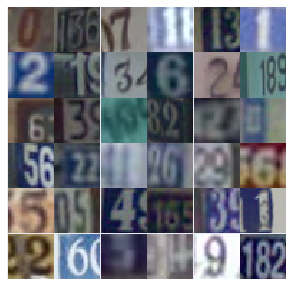

In [10]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

## Generator

The input will be a noise vector z. The output will be a 𝑡𝑎𝑛ℎ output with size of 32x32 which is the size of the SVHN images.

The generator will have convolutional layers to create new images. The first layer creates a deep and narrow layer, something like 4x4x512 as in the original DCGAN paper. In the layer, a batch normalization and a leaky ReLU activation will be used. following transposed convolution layers halve the depth and double the width and height of the previous layer. Again, the batch normalization and leaky ReLU come here.

In [0]:
class Generator(nn.Module):
  def __init__(self):
    super(Generator, self).__init__()
    self.main = nn.Sequential(
      # input is Z, going into a convolution
      nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
      nn.BatchNorm2d(ngf * 8),
      nn.LeakyReLU(alpha, inplace=True),
      # state size. (ngf*8) x 4 x 4
      nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ngf * 4),
      nn.LeakyReLU(alpha, inplace=True),
      # state size. (ngf*4) x 8 x 8
      nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ngf * 2),
      nn.LeakyReLU(alpha, inplace=True),
      # state size. (ngf*2) x 16 x 16
      nn.ConvTranspose2d(ngf * 2, nc, 4, 2, 1, bias=False),
      nn.Tanh()
      # state size. (nc) x 32 x 32
    )

  def forward(self, input):
    output = self.main(input)
    return output

## Discriminator

The discriminator is basically a convolutional classifier. The inputs to the discriminator are 32x32x3 tensors/images. The discriminator will have a few convolutional layers, then a fully connected layer for the output. At the last layer, an activation is sigmoid. 

> In the original DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

In [0]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator, self).__init__()
    self.main = nn.Sequential(
      # input is (nc) x 32 x 32
      nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
      nn.LeakyReLU(alpha, inplace=True),
      # state size. (ndf) x 16 x 16
      nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ndf * 2),
      nn.LeakyReLU(alpha, inplace=True),
      # state size. (ndf*2) x 8 x 8
      nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ndf * 4),
      nn.LeakyReLU(alpha, inplace=True),
      # state size. (ndf*4) x 4 x 4
      nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),
      nn.Sigmoid()
    )

  def forward(self, input):
    output = self.main(input)
    return output.view(-1, 1).squeeze(1)

## Initializes models, defines a loss function and optimizers

Here, the generator and discriminator models are initialized with weights. The loss function is BCELoss, which is Binary Cross Entropy. The BCELoss is a counterpart of TensorFlow's sigmoid_cross_entropy_with_logits. The optimizer is Adam Optimizer.

In [13]:
# custom weights initialization called on models
def weights_init(m):
  classname = m.__class__.__name__
  if classname.find('Conv') != -1:
    m.weight.data.normal_(0.0, 0.02)
  elif classname.find('BatchNorm') != -1:
    m.weight.data.normal_(1.0, 0.02)
    m.bias.data.fill_(0)

g_model = Generator().to(device)
g_model.apply(weights_init)
print(g_model)

d_model = Discriminator().to(device)
d_model.apply(weights_init)
print(d_model)

# loss function
criterion = nn.BCELoss()

fixed_noise = torch.randn(batchSize, nz, 1, 1, device=device)
sample_noise = torch.randn(72, nz, 1, 1, device=device)
real_label = 1
fake_label = 0

# setup optimizer
d_train_optim = optim.Adam(d_model.parameters(), lr=lr, betas=(beta1, 0.999))
g_train_optim = optim.Adam(g_model.parameters(), lr=lr, betas=(beta1, 0.999))

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace)
    (9): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)
Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope

## Showing samples

The cell below defines a function to show samples. The function is called during the training and after the training.

In [0]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
  fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                           sharey=True, sharex=True)
  for ax, img in zip(axes.flatten(), samples[epoch]):
    img = np.rollaxis(img, 0, 3)
    ax.axis('off')
    img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
    ax.set_adjustable('box-forced')
    im = ax.imshow(img, aspect='equal')

  plt.subplots_adjust(wspace=0, hspace=0)
  return fig, axes

## Training

[0/25][0/573] Loss_D: 1.5137 Loss_G: 2.6416 D(x): 0.5372 D(G(z)): 0.5207 / 0.0852


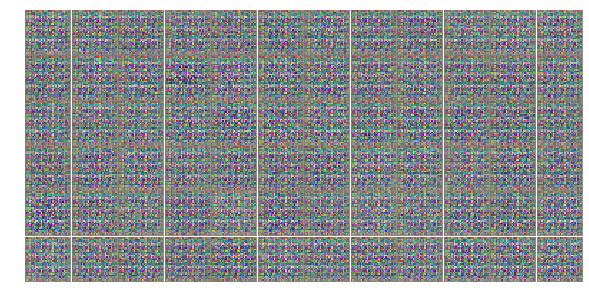

[0/25][10/573] Loss_D: 0.6411 Loss_G: 4.7128 D(x): 0.6904 D(G(z)): 0.1870 / 0.0111
[0/25][20/573] Loss_D: 0.4180 Loss_G: 5.7153 D(x): 0.8872 D(G(z)): 0.2432 / 0.0043
[0/25][30/573] Loss_D: 0.2908 Loss_G: 5.7035 D(x): 0.8443 D(G(z)): 0.0870 / 0.0040
[0/25][40/573] Loss_D: 0.0926 Loss_G: 6.7028 D(x): 0.9487 D(G(z)): 0.0373 / 0.0015
[0/25][50/573] Loss_D: 0.0991 Loss_G: 6.2792 D(x): 0.9353 D(G(z)): 0.0271 / 0.0023
[0/25][60/573] Loss_D: 0.0673 Loss_G: 6.1651 D(x): 0.9530 D(G(z)): 0.0162 / 0.0023
[0/25][70/573] Loss_D: 0.0431 Loss_G: 6.0287 D(x): 0.9759 D(G(z)): 0.0180 / 0.0028
[0/25][80/573] Loss_D: 0.0531 Loss_G: 5.4634 D(x): 0.9746 D(G(z)): 0.0261 / 0.0053
[0/25][90/573] Loss_D: 0.0334 Loss_G: 6.7702 D(x): 0.9836 D(G(z)): 0.0165 / 0.0016
[0/25][100/573] Loss_D: 0.0431 Loss_G: 5.9937 D(x): 0.9829 D(G(z)): 0.0247 / 0.0028


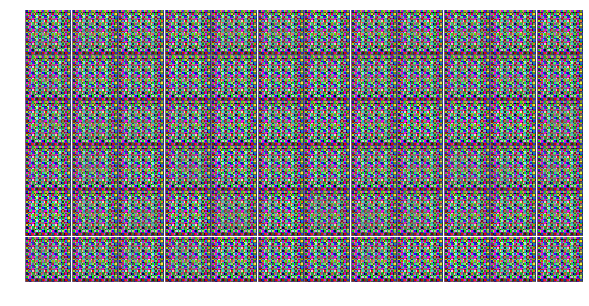

[0/25][110/573] Loss_D: 0.0333 Loss_G: 6.1575 D(x): 0.9826 D(G(z)): 0.0152 / 0.0025
[0/25][120/573] Loss_D: 0.0379 Loss_G: 5.8420 D(x): 0.9754 D(G(z)): 0.0122 / 0.0032
[0/25][130/573] Loss_D: 0.0287 Loss_G: 6.1797 D(x): 0.9835 D(G(z)): 0.0114 / 0.0023
[0/25][140/573] Loss_D: 0.0276 Loss_G: 6.0815 D(x): 0.9904 D(G(z)): 0.0175 / 0.0035
[0/25][150/573] Loss_D: 0.0372 Loss_G: 5.5691 D(x): 0.9836 D(G(z)): 0.0201 / 0.0051
[0/25][160/573] Loss_D: 0.0522 Loss_G: 5.2994 D(x): 0.9723 D(G(z)): 0.0228 / 0.0064
[0/25][170/573] Loss_D: 0.0480 Loss_G: 5.5956 D(x): 0.9726 D(G(z)): 0.0189 / 0.0050
[0/25][180/573] Loss_D: 0.0371 Loss_G: 5.2460 D(x): 0.9801 D(G(z)): 0.0166 / 0.0061
[0/25][190/573] Loss_D: 0.0392 Loss_G: 5.1061 D(x): 0.9825 D(G(z)): 0.0211 / 0.0074
[0/25][200/573] Loss_D: 0.0694 Loss_G: 4.6955 D(x): 0.9649 D(G(z)): 0.0316 / 0.0106


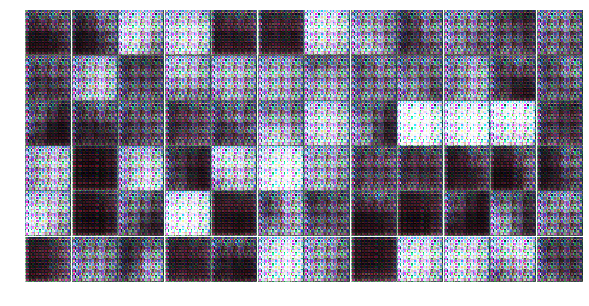

[0/25][210/573] Loss_D: 0.1056 Loss_G: 4.1675 D(x): 0.9581 D(G(z)): 0.0561 / 0.0262
[0/25][220/573] Loss_D: 0.1595 Loss_G: 3.8144 D(x): 0.9096 D(G(z)): 0.0539 / 0.0322
[0/25][230/573] Loss_D: 0.1276 Loss_G: 5.1280 D(x): 0.9112 D(G(z)): 0.0214 / 0.0072
[0/25][240/573] Loss_D: 0.1138 Loss_G: 4.1851 D(x): 0.9588 D(G(z)): 0.0658 / 0.0174
[0/25][250/573] Loss_D: 0.0922 Loss_G: 4.5003 D(x): 0.9436 D(G(z)): 0.0274 / 0.0141
[0/25][260/573] Loss_D: 0.0814 Loss_G: 4.6973 D(x): 0.9666 D(G(z)): 0.0438 / 0.0115
[0/25][270/573] Loss_D: 0.0630 Loss_G: 5.5608 D(x): 0.9603 D(G(z)): 0.0185 / 0.0064
[0/25][280/573] Loss_D: 0.0790 Loss_G: 5.4032 D(x): 0.9642 D(G(z)): 0.0306 / 0.0063
[0/25][290/573] Loss_D: 0.0381 Loss_G: 5.8326 D(x): 0.9797 D(G(z)): 0.0159 / 0.0045
[0/25][300/573] Loss_D: 0.0419 Loss_G: 5.7607 D(x): 0.9770 D(G(z)): 0.0127 / 0.0050


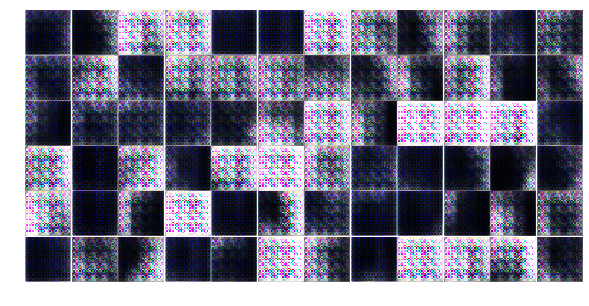

[0/25][310/573] Loss_D: 0.0344 Loss_G: 5.6744 D(x): 0.9786 D(G(z)): 0.0112 / 0.0050
[0/25][320/573] Loss_D: 0.0898 Loss_G: 5.4152 D(x): 0.9624 D(G(z)): 0.0434 / 0.0082
[0/25][330/573] Loss_D: 0.0741 Loss_G: 5.1157 D(x): 0.9802 D(G(z)): 0.0501 / 0.0098
[0/25][340/573] Loss_D: 0.0910 Loss_G: 5.6878 D(x): 0.9685 D(G(z)): 0.0511 / 0.0046
[0/25][350/573] Loss_D: 0.0457 Loss_G: 5.4855 D(x): 0.9657 D(G(z)): 0.0081 / 0.0065
[0/25][360/573] Loss_D: 0.0379 Loss_G: 5.5462 D(x): 0.9753 D(G(z)): 0.0109 / 0.0059
[0/25][370/573] Loss_D: 0.0346 Loss_G: 5.3350 D(x): 0.9852 D(G(z)): 0.0183 / 0.0068
[0/25][380/573] Loss_D: 0.0641 Loss_G: 5.1487 D(x): 0.9718 D(G(z)): 0.0262 / 0.0093
[0/25][390/573] Loss_D: 0.0516 Loss_G: 5.3233 D(x): 0.9681 D(G(z)): 0.0164 / 0.0082
[0/25][400/573] Loss_D: 0.0525 Loss_G: 5.4834 D(x): 0.9837 D(G(z)): 0.0330 / 0.0078


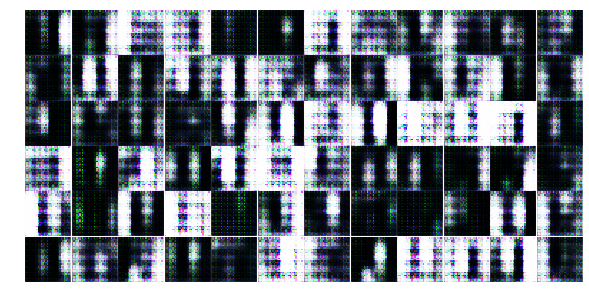

[0/25][410/573] Loss_D: 0.0296 Loss_G: 5.7505 D(x): 0.9870 D(G(z)): 0.0160 / 0.0055
[0/25][420/573] Loss_D: 0.0470 Loss_G: 6.3572 D(x): 0.9728 D(G(z)): 0.0142 / 0.0030
[0/25][430/573] Loss_D: 0.0286 Loss_G: 5.9795 D(x): 0.9865 D(G(z)): 0.0139 / 0.0044
[0/25][440/573] Loss_D: 0.0240 Loss_G: 6.3058 D(x): 0.9857 D(G(z)): 0.0084 / 0.0029
[0/25][450/573] Loss_D: 0.0253 Loss_G: 6.6368 D(x): 0.9821 D(G(z)): 0.0051 / 0.0019
[0/25][460/573] Loss_D: 0.0314 Loss_G: 6.0861 D(x): 0.9816 D(G(z)): 0.0109 / 0.0032
[0/25][470/573] Loss_D: 0.0800 Loss_G: 6.0091 D(x): 0.9437 D(G(z)): 0.0118 / 0.0052
[0/25][480/573] Loss_D: 0.0272 Loss_G: 6.2639 D(x): 0.9809 D(G(z)): 0.0046 / 0.0028
[0/25][490/573] Loss_D: 0.0231 Loss_G: 5.6566 D(x): 0.9911 D(G(z)): 0.0138 / 0.0057
[0/25][500/573] Loss_D: 0.0337 Loss_G: 5.5360 D(x): 0.9831 D(G(z)): 0.0153 / 0.0056


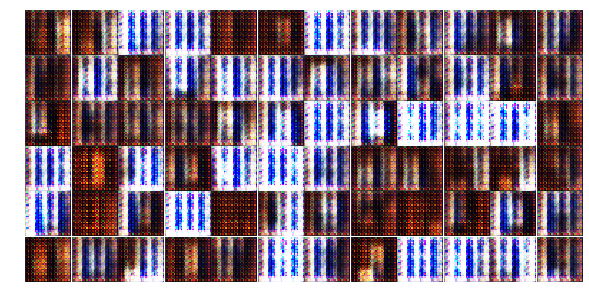

[0/25][510/573] Loss_D: 0.0184 Loss_G: 6.1089 D(x): 0.9951 D(G(z)): 0.0127 / 0.0050
[0/25][520/573] Loss_D: 0.0245 Loss_G: 6.3070 D(x): 0.9905 D(G(z)): 0.0143 / 0.0039
[0/25][530/573] Loss_D: 0.0466 Loss_G: 6.0357 D(x): 0.9724 D(G(z)): 0.0146 / 0.0053
[0/25][540/573] Loss_D: 0.0172 Loss_G: 6.1562 D(x): 0.9910 D(G(z)): 0.0079 / 0.0036
[0/25][550/573] Loss_D: 0.0613 Loss_G: 5.2284 D(x): 0.9819 D(G(z)): 0.0364 / 0.0152
[0/25][560/573] Loss_D: 0.0491 Loss_G: 5.8331 D(x): 0.9782 D(G(z)): 0.0243 / 0.0058
[0/25][570/573] Loss_D: 0.0826 Loss_G: 6.7672 D(x): 0.9508 D(G(z)): 0.0176 / 0.0028
[1/25][0/573] Loss_D: 0.0751 Loss_G: 7.1268 D(x): 0.9391 D(G(z)): 0.0039 / 0.0023


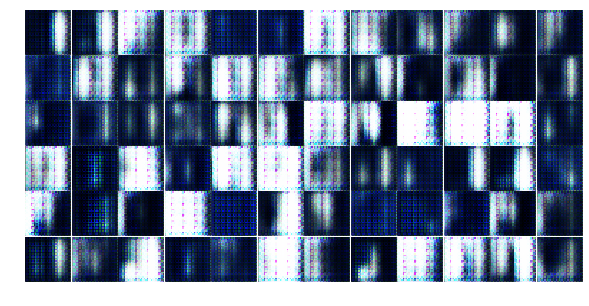

[1/25][10/573] Loss_D: 0.0259 Loss_G: 5.0831 D(x): 0.9942 D(G(z)): 0.0196 / 0.0107
[1/25][20/573] Loss_D: 0.0384 Loss_G: 4.9302 D(x): 0.9827 D(G(z)): 0.0189 / 0.0137
[1/25][30/573] Loss_D: 0.0633 Loss_G: 4.4578 D(x): 0.9850 D(G(z)): 0.0434 / 0.0205
[1/25][40/573] Loss_D: 0.0734 Loss_G: 4.9530 D(x): 0.9560 D(G(z)): 0.0201 / 0.0150
[1/25][50/573] Loss_D: 0.0569 Loss_G: 5.8351 D(x): 0.9701 D(G(z)): 0.0218 / 0.0069
[1/25][60/573] Loss_D: 0.0506 Loss_G: 5.6210 D(x): 0.9832 D(G(z)): 0.0288 / 0.0084
[1/25][70/573] Loss_D: 0.0628 Loss_G: 5.4585 D(x): 0.9573 D(G(z)): 0.0159 / 0.0078
[1/25][80/573] Loss_D: 0.0184 Loss_G: 5.8541 D(x): 0.9948 D(G(z)): 0.0129 / 0.0047
[1/25][90/573] Loss_D: 0.0362 Loss_G: 5.8668 D(x): 0.9906 D(G(z)): 0.0244 / 0.0059
[1/25][100/573] Loss_D: 0.0178 Loss_G: 6.6350 D(x): 0.9895 D(G(z)): 0.0067 / 0.0024


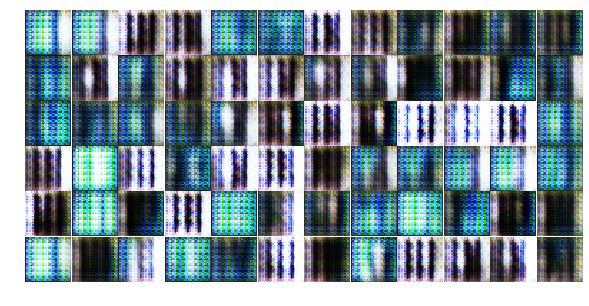

[1/25][110/573] Loss_D: 0.0314 Loss_G: 5.5143 D(x): 0.9904 D(G(z)): 0.0211 / 0.0057
[1/25][120/573] Loss_D: 0.0407 Loss_G: 8.2382 D(x): 0.9676 D(G(z)): 0.0014 / 0.0004
[1/25][130/573] Loss_D: 0.0877 Loss_G: 5.2149 D(x): 0.9539 D(G(z)): 0.0298 / 0.0081
[1/25][140/573] Loss_D: 0.0452 Loss_G: 6.8506 D(x): 0.9668 D(G(z)): 0.0065 / 0.0020
[1/25][150/573] Loss_D: 0.0532 Loss_G: 7.0272 D(x): 0.9863 D(G(z)): 0.0246 / 0.0065
[1/25][160/573] Loss_D: 0.0178 Loss_G: 6.3531 D(x): 0.9854 D(G(z)): 0.0025 / 0.0034
[1/25][170/573] Loss_D: 0.0377 Loss_G: 5.8462 D(x): 0.9963 D(G(z)): 0.0313 / 0.0064
[1/25][180/573] Loss_D: 0.0166 Loss_G: 7.9681 D(x): 0.9869 D(G(z)): 0.0030 / 0.0009
[1/25][190/573] Loss_D: 0.0131 Loss_G: 6.3211 D(x): 0.9987 D(G(z)): 0.0116 / 0.0047
[1/25][200/573] Loss_D: 0.0239 Loss_G: 6.0268 D(x): 0.9948 D(G(z)): 0.0182 / 0.0048


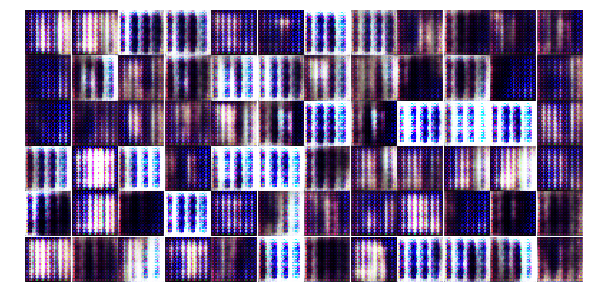

[1/25][210/573] Loss_D: 0.0124 Loss_G: 6.8851 D(x): 0.9958 D(G(z)): 0.0080 / 0.0024
[1/25][220/573] Loss_D: 0.0227 Loss_G: 6.8372 D(x): 0.9853 D(G(z)): 0.0069 / 0.0022
[1/25][230/573] Loss_D: 0.0196 Loss_G: 6.8746 D(x): 0.9870 D(G(z)): 0.0052 / 0.0023
[1/25][240/573] Loss_D: 0.0297 Loss_G: 6.3496 D(x): 0.9822 D(G(z)): 0.0106 / 0.0041
[1/25][250/573] Loss_D: 0.0192 Loss_G: 5.3420 D(x): 0.9981 D(G(z)): 0.0170 / 0.0087
[1/25][260/573] Loss_D: 0.0402 Loss_G: 5.7028 D(x): 0.9908 D(G(z)): 0.0279 / 0.0090
[1/25][270/573] Loss_D: 0.0161 Loss_G: 6.1110 D(x): 0.9963 D(G(z)): 0.0118 / 0.0075
[1/25][280/573] Loss_D: 0.0048 Loss_G: 6.8376 D(x): 0.9982 D(G(z)): 0.0030 / 0.0022
[1/25][290/573] Loss_D: 0.0124 Loss_G: 6.7226 D(x): 0.9937 D(G(z)): 0.0051 / 0.0029
[1/25][300/573] Loss_D: 0.0339 Loss_G: 6.2146 D(x): 0.9889 D(G(z)): 0.0215 / 0.0053


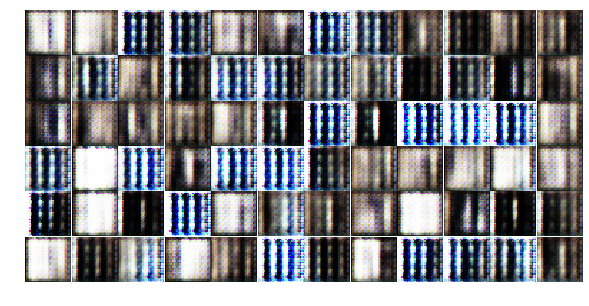

[1/25][310/573] Loss_D: 0.0206 Loss_G: 6.4631 D(x): 0.9941 D(G(z)): 0.0142 / 0.0039
[1/25][320/573] Loss_D: 0.0148 Loss_G: 5.9589 D(x): 0.9917 D(G(z)): 0.0059 / 0.0208
[1/25][330/573] Loss_D: 0.0267 Loss_G: 7.5479 D(x): 0.9847 D(G(z)): 0.0049 / 0.0026
[1/25][340/573] Loss_D: 0.0484 Loss_G: 7.3137 D(x): 0.9807 D(G(z)): 0.0224 / 0.0033
[1/25][350/573] Loss_D: 0.0396 Loss_G: 6.5427 D(x): 0.9795 D(G(z)): 0.0175 / 0.0024
[1/25][360/573] Loss_D: 0.0686 Loss_G: 4.4015 D(x): 0.9714 D(G(z)): 0.0301 / 0.0286
[1/25][370/573] Loss_D: 0.0271 Loss_G: 6.2895 D(x): 0.9863 D(G(z)): 0.0111 / 0.0042
[1/25][380/573] Loss_D: 0.0193 Loss_G: 5.9145 D(x): 0.9902 D(G(z)): 0.0088 / 0.0079
[1/25][390/573] Loss_D: 0.0562 Loss_G: 5.2929 D(x): 0.9587 D(G(z)): 0.0078 / 0.0079
[1/25][400/573] Loss_D: 0.0249 Loss_G: 5.2030 D(x): 0.9918 D(G(z)): 0.0162 / 0.0096


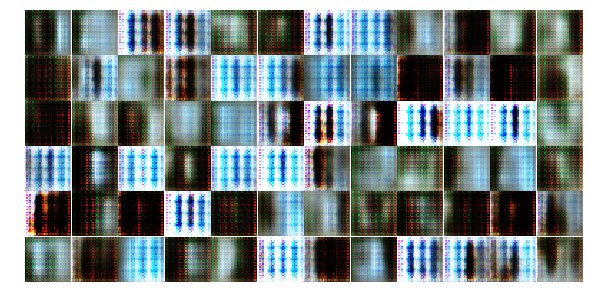

[1/25][410/573] Loss_D: 0.0642 Loss_G: 6.0225 D(x): 0.9847 D(G(z)): 0.0453 / 0.0063
[1/25][420/573] Loss_D: 0.0304 Loss_G: 6.5152 D(x): 0.9824 D(G(z)): 0.0116 / 0.0024
[1/25][430/573] Loss_D: 0.0128 Loss_G: 6.5522 D(x): 0.9951 D(G(z)): 0.0076 / 0.0026
[1/25][440/573] Loss_D: 0.0269 Loss_G: 5.5911 D(x): 0.9875 D(G(z)): 0.0137 / 0.0062
[1/25][450/573] Loss_D: 0.0422 Loss_G: 5.2888 D(x): 0.9925 D(G(z)): 0.0323 / 0.0093
[1/25][460/573] Loss_D: 0.0776 Loss_G: 6.8681 D(x): 0.9460 D(G(z)): 0.0067 / 0.0038
[1/25][470/573] Loss_D: 0.0145 Loss_G: 6.7273 D(x): 0.9957 D(G(z)): 0.0099 / 0.0046
[1/25][480/573] Loss_D: 0.0190 Loss_G: 5.7576 D(x): 0.9988 D(G(z)): 0.0172 / 0.0086
[1/25][490/573] Loss_D: 0.0136 Loss_G: 6.2238 D(x): 0.9954 D(G(z)): 0.0089 / 0.0039
[1/25][500/573] Loss_D: 0.0171 Loss_G: 6.5081 D(x): 0.9933 D(G(z)): 0.0087 / 0.0026


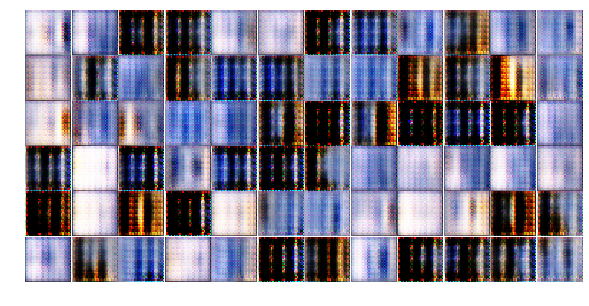

[1/25][510/573] Loss_D: 0.0672 Loss_G: 6.7105 D(x): 0.9576 D(G(z)): 0.0040 / 0.0027
[1/25][520/573] Loss_D: 0.0237 Loss_G: 6.1374 D(x): 0.9838 D(G(z)): 0.0060 / 0.0039
[1/25][530/573] Loss_D: 0.0186 Loss_G: 7.4366 D(x): 0.9854 D(G(z)): 0.0029 / 0.0015
[1/25][540/573] Loss_D: 0.0168 Loss_G: 7.5884 D(x): 0.9886 D(G(z)): 0.0034 / 0.0012
[1/25][550/573] Loss_D: 0.0672 Loss_G: 6.6030 D(x): 0.9557 D(G(z)): 0.0092 / 0.0038
[1/25][560/573] Loss_D: 0.0205 Loss_G: 8.0616 D(x): 0.9946 D(G(z)): 0.0147 / 0.0014
[1/25][570/573] Loss_D: 0.1607 Loss_G: 6.3187 D(x): 0.8971 D(G(z)): 0.0075 / 0.0062
[2/25][0/573] Loss_D: 0.2082 Loss_G: 6.2527 D(x): 0.9886 D(G(z)): 0.1455 / 0.0050


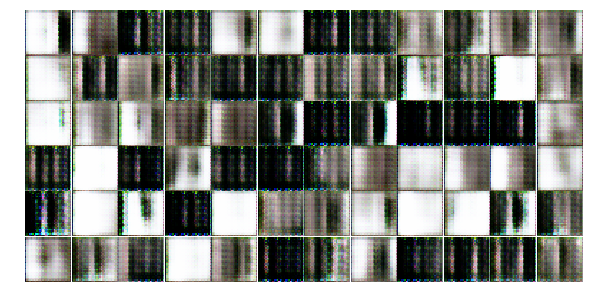

[2/25][10/573] Loss_D: 0.0898 Loss_G: 7.9714 D(x): 0.9593 D(G(z)): 0.0366 / 0.0052
[2/25][20/573] Loss_D: 0.0280 Loss_G: 6.6577 D(x): 0.9790 D(G(z)): 0.0054 / 0.0058
[2/25][30/573] Loss_D: 0.0768 Loss_G: 6.4529 D(x): 0.9424 D(G(z)): 0.0078 / 0.0060
[2/25][40/573] Loss_D: 0.0292 Loss_G: 6.3850 D(x): 0.9826 D(G(z)): 0.0098 / 0.0035
[2/25][50/573] Loss_D: 0.0549 Loss_G: 5.9938 D(x): 0.9686 D(G(z)): 0.0162 / 0.0043
[2/25][60/573] Loss_D: 0.0412 Loss_G: 7.6706 D(x): 0.9720 D(G(z)): 0.0054 / 0.0013
[2/25][70/573] Loss_D: 0.0149 Loss_G: 9.1449 D(x): 0.9872 D(G(z)): 0.0012 / 0.0006
[2/25][80/573] Loss_D: 0.0083 Loss_G: 8.5282 D(x): 0.9948 D(G(z)): 0.0029 / 0.0010
[2/25][90/573] Loss_D: 0.2334 Loss_G: 6.8208 D(x): 0.8553 D(G(z)): 0.0099 / 0.0053
[2/25][100/573] Loss_D: 0.0562 Loss_G: 7.5166 D(x): 0.9579 D(G(z)): 0.0088 / 0.0018


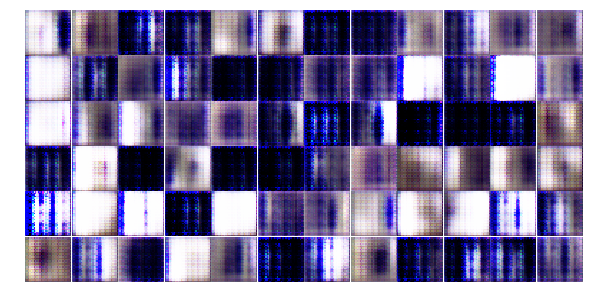

[2/25][110/573] Loss_D: 0.0364 Loss_G: 7.1066 D(x): 0.9871 D(G(z)): 0.0182 / 0.0038
[2/25][120/573] Loss_D: 0.0462 Loss_G: 7.1681 D(x): 0.9613 D(G(z)): 0.0045 / 0.0021
[2/25][130/573] Loss_D: 0.0614 Loss_G: 5.6514 D(x): 0.9913 D(G(z)): 0.0475 / 0.0175
[2/25][140/573] Loss_D: 0.0164 Loss_G: 5.9634 D(x): 0.9920 D(G(z)): 0.0077 / 0.0095
[2/25][150/573] Loss_D: 0.0281 Loss_G: 5.6823 D(x): 0.9877 D(G(z)): 0.0146 / 0.0088
[2/25][160/573] Loss_D: 0.0170 Loss_G: 5.9770 D(x): 0.9881 D(G(z)): 0.0044 / 0.0050
[2/25][170/573] Loss_D: 0.0238 Loss_G: 5.5088 D(x): 0.9975 D(G(z)): 0.0206 / 0.0085
[2/25][180/573] Loss_D: 0.0127 Loss_G: 5.7690 D(x): 0.9972 D(G(z)): 0.0097 / 0.0062
[2/25][190/573] Loss_D: 0.0400 Loss_G: 6.2801 D(x): 0.9736 D(G(z)): 0.0064 / 0.0040
[2/25][200/573] Loss_D: 0.0215 Loss_G: 5.8245 D(x): 0.9904 D(G(z)): 0.0115 / 0.0071


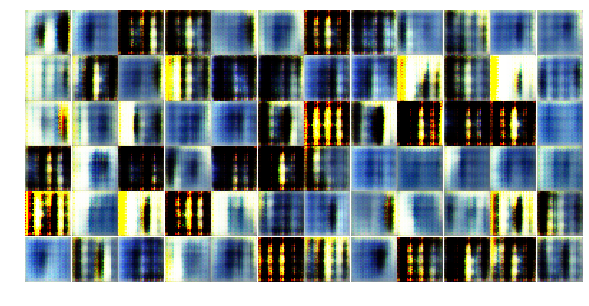

[2/25][210/573] Loss_D: 0.0263 Loss_G: 5.9709 D(x): 0.9877 D(G(z)): 0.0130 / 0.0058
[2/25][220/573] Loss_D: 0.1177 Loss_G: 5.5541 D(x): 0.9463 D(G(z)): 0.0453 / 0.0119
[2/25][230/573] Loss_D: 0.0319 Loss_G: 7.1351 D(x): 0.9789 D(G(z)): 0.0066 / 0.0127
[2/25][240/573] Loss_D: 0.0281 Loss_G: 6.1691 D(x): 0.9936 D(G(z)): 0.0179 / 0.0119
[2/25][250/573] Loss_D: 0.1095 Loss_G: 5.4533 D(x): 0.9413 D(G(z)): 0.0323 / 0.0132
[2/25][260/573] Loss_D: 0.0418 Loss_G: 7.5489 D(x): 0.9784 D(G(z)): 0.0171 / 0.0078
[2/25][270/573] Loss_D: 0.0177 Loss_G: 5.7600 D(x): 0.9974 D(G(z)): 0.0147 / 0.0095
[2/25][280/573] Loss_D: 0.0439 Loss_G: 5.4018 D(x): 0.9827 D(G(z)): 0.0165 / 0.0119
[2/25][290/573] Loss_D: 0.0682 Loss_G: 5.4606 D(x): 0.9613 D(G(z)): 0.0183 / 0.0133
[2/25][300/573] Loss_D: 0.1132 Loss_G: 3.0443 D(x): 0.9907 D(G(z)): 0.0798 / 0.1922


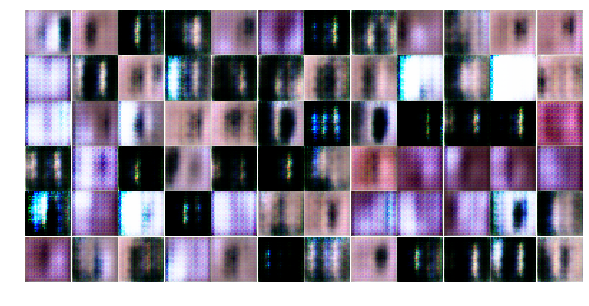

[2/25][310/573] Loss_D: 0.0456 Loss_G: 6.7170 D(x): 0.9933 D(G(z)): 0.0357 / 0.0085
[2/25][320/573] Loss_D: 0.0876 Loss_G: 5.1884 D(x): 0.9525 D(G(z)): 0.0302 / 0.0148
[2/25][330/573] Loss_D: 0.0193 Loss_G: 6.7863 D(x): 0.9951 D(G(z)): 0.0139 / 0.0031
[2/25][340/573] Loss_D: 0.0119 Loss_G: 8.2751 D(x): 0.9975 D(G(z)): 0.0083 / 0.0053
[2/25][350/573] Loss_D: 0.0262 Loss_G: 5.9146 D(x): 0.9908 D(G(z)): 0.0152 / 0.0079
[2/25][360/573] Loss_D: 0.0166 Loss_G: 6.0660 D(x): 0.9934 D(G(z)): 0.0095 / 0.0064
[2/25][370/573] Loss_D: 0.0139 Loss_G: 6.5337 D(x): 0.9917 D(G(z)): 0.0054 / 0.0037
[2/25][380/573] Loss_D: 0.0112 Loss_G: 5.9535 D(x): 0.9986 D(G(z)): 0.0096 / 0.0072
[2/25][390/573] Loss_D: 0.0399 Loss_G: 6.0433 D(x): 0.9804 D(G(z)): 0.0127 / 0.0086
[2/25][400/573] Loss_D: 0.0537 Loss_G: 6.5792 D(x): 0.9657 D(G(z)): 0.0153 / 0.0070


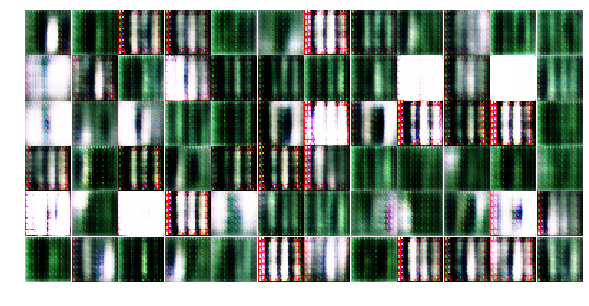

[2/25][410/573] Loss_D: 0.0495 Loss_G: 6.1418 D(x): 0.9868 D(G(z)): 0.0323 / 0.0064
[2/25][420/573] Loss_D: 0.0314 Loss_G: 5.5085 D(x): 0.9904 D(G(z)): 0.0192 / 0.0185
[2/25][430/573] Loss_D: 0.0429 Loss_G: 5.3582 D(x): 0.9882 D(G(z)): 0.0287 / 0.0170
[2/25][440/573] Loss_D: 0.0320 Loss_G: 5.7841 D(x): 0.9908 D(G(z)): 0.0218 / 0.0063
[2/25][450/573] Loss_D: 0.0698 Loss_G: 6.2009 D(x): 0.9568 D(G(z)): 0.0154 / 0.0084
[2/25][460/573] Loss_D: 0.1619 Loss_G: 4.7607 D(x): 0.9661 D(G(z)): 0.0996 / 0.0231
[2/25][470/573] Loss_D: 0.0637 Loss_G: 4.7154 D(x): 0.9771 D(G(z)): 0.0346 / 0.0276
[2/25][480/573] Loss_D: 0.0563 Loss_G: 4.8018 D(x): 0.9846 D(G(z)): 0.0365 / 0.0513
[2/25][490/573] Loss_D: 0.0282 Loss_G: 7.2935 D(x): 0.9810 D(G(z)): 0.0072 / 0.0216
[2/25][500/573] Loss_D: 0.0496 Loss_G: 5.1549 D(x): 0.9632 D(G(z)): 0.0038 / 0.0176


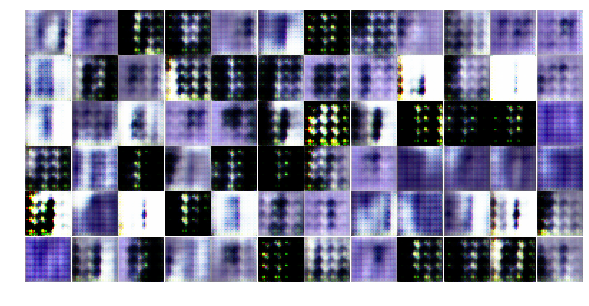

[2/25][510/573] Loss_D: 0.1045 Loss_G: 6.1926 D(x): 0.9437 D(G(z)): 0.0138 / 0.0088
[2/25][520/573] Loss_D: 0.0405 Loss_G: 6.0719 D(x): 0.9836 D(G(z)): 0.0224 / 0.0069
[2/25][530/573] Loss_D: 0.1115 Loss_G: 4.6829 D(x): 0.9413 D(G(z)): 0.0339 / 0.0201
[2/25][540/573] Loss_D: 0.0604 Loss_G: 4.9950 D(x): 0.9780 D(G(z)): 0.0333 / 0.0281
[2/25][550/573] Loss_D: 0.0859 Loss_G: 5.2183 D(x): 0.9513 D(G(z)): 0.0232 / 0.0163
[2/25][560/573] Loss_D: 0.0797 Loss_G: 5.2500 D(x): 0.9590 D(G(z)): 0.0261 / 0.0142
[2/25][570/573] Loss_D: 0.0128 Loss_G: 6.0453 D(x): 0.9981 D(G(z)): 0.0106 / 0.0066
[3/25][0/573] Loss_D: 0.0167 Loss_G: 6.5673 D(x): 0.9925 D(G(z)): 0.0088 / 0.0036


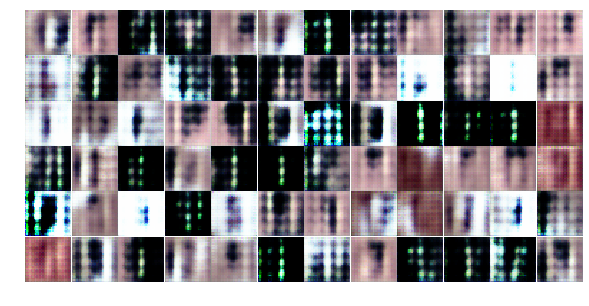

[3/25][10/573] Loss_D: 0.1249 Loss_G: 6.5427 D(x): 0.9479 D(G(z)): 0.0460 / 0.0043
[3/25][20/573] Loss_D: 0.0960 Loss_G: 11.4593 D(x): 0.9637 D(G(z)): 0.0438 / 0.0007
[3/25][30/573] Loss_D: 0.4529 Loss_G: 6.2967 D(x): 0.7850 D(G(z)): 0.0272 / 0.0178
[3/25][40/573] Loss_D: 0.1325 Loss_G: 7.2878 D(x): 0.9020 D(G(z)): 0.0076 / 0.0027
[3/25][50/573] Loss_D: 0.0312 Loss_G: 8.2564 D(x): 0.9950 D(G(z)): 0.0125 / 0.0083
[3/25][60/573] Loss_D: 0.0080 Loss_G: 7.9191 D(x): 0.9949 D(G(z)): 0.0028 / 0.0018
[3/25][70/573] Loss_D: 0.0115 Loss_G: 7.6273 D(x): 0.9905 D(G(z)): 0.0017 / 0.0013
[3/25][80/573] Loss_D: 0.0219 Loss_G: 6.6778 D(x): 0.9867 D(G(z)): 0.0078 / 0.0038
[3/25][90/573] Loss_D: 0.0591 Loss_G: 4.7461 D(x): 0.9933 D(G(z)): 0.0483 / 0.0174
[3/25][100/573] Loss_D: 0.0478 Loss_G: 7.2258 D(x): 0.9839 D(G(z)): 0.0234 / 0.0032


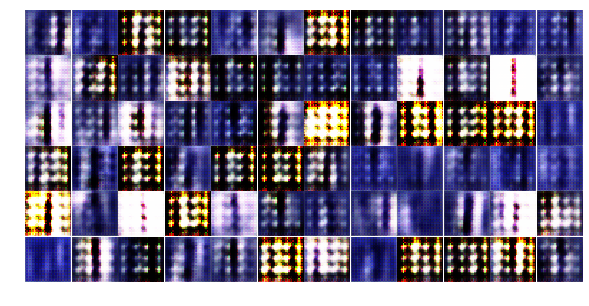

[3/25][110/573] Loss_D: 0.0183 Loss_G: 8.8600 D(x): 0.9879 D(G(z)): 0.0053 / 0.0033
[3/25][120/573] Loss_D: 0.0246 Loss_G: 6.3160 D(x): 0.9933 D(G(z)): 0.0168 / 0.0046
[3/25][130/573] Loss_D: 0.0275 Loss_G: 6.4080 D(x): 0.9823 D(G(z)): 0.0071 / 0.0104
[3/25][140/573] Loss_D: 0.0327 Loss_G: 6.6055 D(x): 0.9805 D(G(z)): 0.0114 / 0.0029
[3/25][150/573] Loss_D: 0.1214 Loss_G: 4.1127 D(x): 0.9372 D(G(z)): 0.0322 / 0.0348
[3/25][160/573] Loss_D: 0.3239 Loss_G: 1.6494 D(x): 0.8410 D(G(z)): 0.0874 / 0.3157
[3/25][170/573] Loss_D: 0.2122 Loss_G: 7.2770 D(x): 0.8998 D(G(z)): 0.0146 / 0.0021
[3/25][180/573] Loss_D: 0.4788 Loss_G: 5.2640 D(x): 0.9099 D(G(z)): 0.1940 / 0.0171
[3/25][190/573] Loss_D: 0.1207 Loss_G: 8.5693 D(x): 0.9186 D(G(z)): 0.0213 / 0.0011
[3/25][200/573] Loss_D: 0.3231 Loss_G: 4.5052 D(x): 0.8462 D(G(z)): 0.0481 / 0.0748


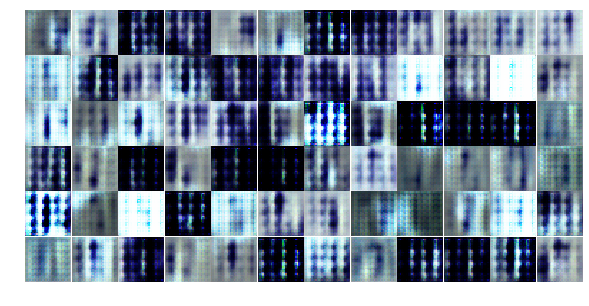

[3/25][210/573] Loss_D: 0.1045 Loss_G: 5.8353 D(x): 0.9569 D(G(z)): 0.0517 / 0.0172
[3/25][220/573] Loss_D: 0.1097 Loss_G: 7.0273 D(x): 0.9187 D(G(z)): 0.0058 / 0.0024
[3/25][230/573] Loss_D: 0.0718 Loss_G: 4.4297 D(x): 0.9939 D(G(z)): 0.0616 / 0.0203
[3/25][240/573] Loss_D: 0.0390 Loss_G: 4.7014 D(x): 0.9952 D(G(z)): 0.0323 / 0.0176
[3/25][250/573] Loss_D: 0.0877 Loss_G: 7.4035 D(x): 0.9386 D(G(z)): 0.0164 / 0.0056
[3/25][260/573] Loss_D: 0.0558 Loss_G: 6.2875 D(x): 0.9694 D(G(z)): 0.0215 / 0.0073
[3/25][270/573] Loss_D: 0.0598 Loss_G: 6.4029 D(x): 0.9630 D(G(z)): 0.0148 / 0.0060
[3/25][280/573] Loss_D: 0.0564 Loss_G: 5.1320 D(x): 0.9750 D(G(z)): 0.0265 / 0.0200
[3/25][290/573] Loss_D: 0.0263 Loss_G: 8.2229 D(x): 0.9773 D(G(z)): 0.0012 / 0.0012
[3/25][300/573] Loss_D: 0.0689 Loss_G: 4.6338 D(x): 0.9833 D(G(z)): 0.0476 / 0.0161


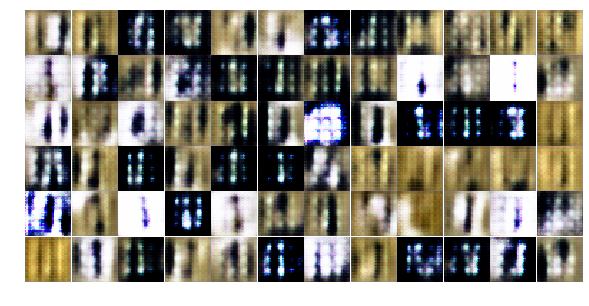

[3/25][310/573] Loss_D: 0.2572 Loss_G: 4.0386 D(x): 0.9461 D(G(z)): 0.1510 / 0.0311
[3/25][320/573] Loss_D: 0.0378 Loss_G: 5.0656 D(x): 0.9868 D(G(z)): 0.0222 / 0.0109
[3/25][330/573] Loss_D: 0.0888 Loss_G: 4.6327 D(x): 0.9534 D(G(z)): 0.0294 / 0.0340
[3/25][340/573] Loss_D: 0.0888 Loss_G: 6.4805 D(x): 0.9268 D(G(z)): 0.0027 / 0.0044
[3/25][350/573] Loss_D: 0.0256 Loss_G: 6.2349 D(x): 0.9858 D(G(z)): 0.0096 / 0.0154
[3/25][360/573] Loss_D: 0.0990 Loss_G: 6.9071 D(x): 0.9283 D(G(z)): 0.0109 / 0.0059
[3/25][370/573] Loss_D: 0.1100 Loss_G: 3.4906 D(x): 0.9308 D(G(z)): 0.0141 / 0.0625
[3/25][380/573] Loss_D: 0.0431 Loss_G: 3.8351 D(x): 0.9988 D(G(z)): 0.0361 / 0.0586
[3/25][390/573] Loss_D: 0.0435 Loss_G: 7.3534 D(x): 0.9634 D(G(z)): 0.0032 / 0.0039
[3/25][400/573] Loss_D: 0.0211 Loss_G: 6.8300 D(x): 0.9832 D(G(z)): 0.0033 / 0.0023


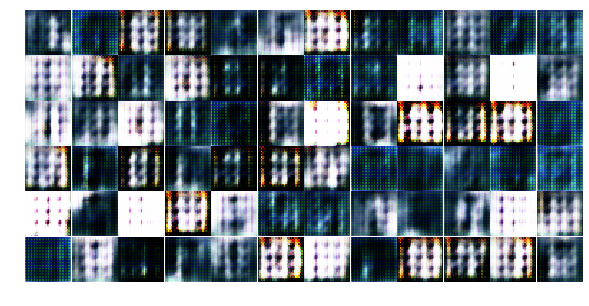

[3/25][410/573] Loss_D: 0.0395 Loss_G: 6.0573 D(x): 0.9879 D(G(z)): 0.0252 / 0.0054
[3/25][420/573] Loss_D: 0.0850 Loss_G: 6.1144 D(x): 0.9457 D(G(z)): 0.0205 / 0.0044
[3/25][430/573] Loss_D: 0.0851 Loss_G: 5.5223 D(x): 0.9946 D(G(z)): 0.0697 / 0.0120
[3/25][440/573] Loss_D: 0.0333 Loss_G: 6.7910 D(x): 0.9862 D(G(z)): 0.0171 / 0.0103
[3/25][450/573] Loss_D: 0.0445 Loss_G: 6.6485 D(x): 0.9832 D(G(z)): 0.0238 / 0.0054
[3/25][460/573] Loss_D: 0.0214 Loss_G: 8.4104 D(x): 0.9834 D(G(z)): 0.0030 / 0.0012
[3/25][470/573] Loss_D: 0.1036 Loss_G: 5.3122 D(x): 0.9960 D(G(z)): 0.0819 / 0.0139
[3/25][480/573] Loss_D: 0.0169 Loss_G: 7.5625 D(x): 0.9917 D(G(z)): 0.0082 / 0.0022
[3/25][490/573] Loss_D: 0.0379 Loss_G: 4.8642 D(x): 0.9913 D(G(z)): 0.0273 / 0.0173
[3/25][500/573] Loss_D: 0.0123 Loss_G: 6.1206 D(x): 0.9976 D(G(z)): 0.0097 / 0.0076


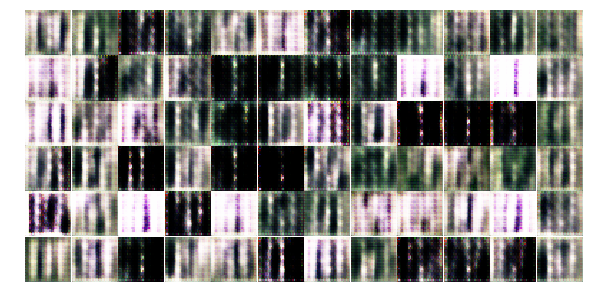

[3/25][510/573] Loss_D: 0.0190 Loss_G: 5.1983 D(x): 0.9934 D(G(z)): 0.0120 / 0.0125
[3/25][520/573] Loss_D: 0.0421 Loss_G: 5.4167 D(x): 0.9867 D(G(z)): 0.0222 / 0.0130
[3/25][530/573] Loss_D: 0.0718 Loss_G: 5.4574 D(x): 0.9511 D(G(z)): 0.0166 / 0.0077
[3/25][540/573] Loss_D: 0.0321 Loss_G: 5.1916 D(x): 0.9960 D(G(z)): 0.0270 / 0.0149
[3/25][550/573] Loss_D: 0.0736 Loss_G: 4.7980 D(x): 0.9650 D(G(z)): 0.0337 / 0.0194
[3/25][560/573] Loss_D: 0.0965 Loss_G: 7.4443 D(x): 0.9342 D(G(z)): 0.0195 / 0.0016
[3/25][570/573] Loss_D: 0.0957 Loss_G: 6.0568 D(x): 0.9377 D(G(z)): 0.0097 / 0.0060
[4/25][0/573] Loss_D: 0.0632 Loss_G: 5.9688 D(x): 0.9883 D(G(z)): 0.0441 / 0.0166


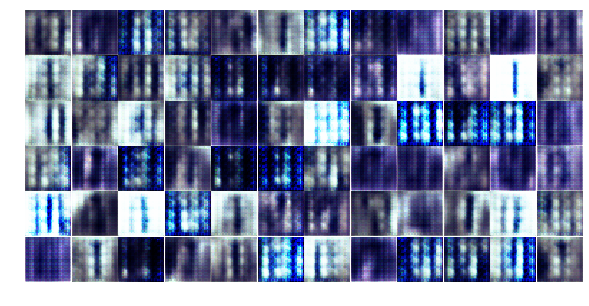

[4/25][10/573] Loss_D: 0.2909 Loss_G: 6.0957 D(x): 0.9880 D(G(z)): 0.2016 / 0.0070
[4/25][20/573] Loss_D: 0.0512 Loss_G: 6.4771 D(x): 0.9843 D(G(z)): 0.0315 / 0.0033
[4/25][30/573] Loss_D: 0.0700 Loss_G: 5.6432 D(x): 0.9828 D(G(z)): 0.0454 / 0.0075
[4/25][40/573] Loss_D: 0.1012 Loss_G: 5.4717 D(x): 0.9964 D(G(z)): 0.0756 / 0.0261
[4/25][50/573] Loss_D: 0.0855 Loss_G: 8.0284 D(x): 0.9312 D(G(z)): 0.0030 / 0.0014
[4/25][60/573] Loss_D: 0.0514 Loss_G: 4.8926 D(x): 0.9895 D(G(z)): 0.0314 / 0.0326
[4/25][70/573] Loss_D: 0.0297 Loss_G: 5.4267 D(x): 0.9996 D(G(z)): 0.0270 / 0.0138
[4/25][80/573] Loss_D: 0.0126 Loss_G: 7.8964 D(x): 0.9916 D(G(z)): 0.0008 / 0.0007
[4/25][90/573] Loss_D: 0.0090 Loss_G: 6.3567 D(x): 0.9990 D(G(z)): 0.0078 / 0.0045
[4/25][100/573] Loss_D: 0.0041 Loss_G: 7.6230 D(x): 0.9977 D(G(z)): 0.0017 / 0.0011


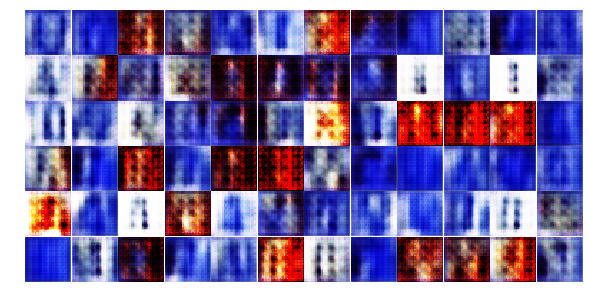

[4/25][110/573] Loss_D: 0.0135 Loss_G: 6.5356 D(x): 0.9909 D(G(z)): 0.0041 / 0.0031
[4/25][120/573] Loss_D: 0.0654 Loss_G: 5.6122 D(x): 0.9584 D(G(z)): 0.0160 / 0.0106
[4/25][130/573] Loss_D: 0.1070 Loss_G: 6.4833 D(x): 0.9129 D(G(z)): 0.0024 / 0.0030
[4/25][140/573] Loss_D: 0.2286 Loss_G: 5.2772 D(x): 0.8644 D(G(z)): 0.0034 / 0.0165
[4/25][150/573] Loss_D: 0.0952 Loss_G: 4.6262 D(x): 0.9973 D(G(z)): 0.0752 / 0.0225
[4/25][160/573] Loss_D: 0.0326 Loss_G: 6.4942 D(x): 0.9974 D(G(z)): 0.0260 / 0.0099
[4/25][170/573] Loss_D: 0.4275 Loss_G: 4.9846 D(x): 0.8546 D(G(z)): 0.1638 / 0.0188
[4/25][180/573] Loss_D: 0.0518 Loss_G: 5.4320 D(x): 0.9782 D(G(z)): 0.0237 / 0.0229
[4/25][190/573] Loss_D: 0.0131 Loss_G: 7.9941 D(x): 0.9958 D(G(z)): 0.0081 / 0.0033
[4/25][200/573] Loss_D: 0.0256 Loss_G: 5.3601 D(x): 0.9992 D(G(z)): 0.0238 / 0.0130


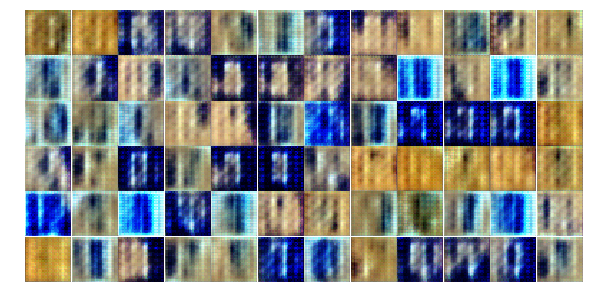

[4/25][210/573] Loss_D: 0.0183 Loss_G: 6.4641 D(x): 0.9951 D(G(z)): 0.0106 / 0.0087
[4/25][220/573] Loss_D: 0.0248 Loss_G: 5.7301 D(x): 0.9892 D(G(z)): 0.0128 / 0.0067
[4/25][230/573] Loss_D: 0.1498 Loss_G: 5.0075 D(x): 0.9731 D(G(z)): 0.0974 / 0.0171
[4/25][240/573] Loss_D: 0.0380 Loss_G: 5.6649 D(x): 0.9982 D(G(z)): 0.0325 / 0.0146
[4/25][250/573] Loss_D: 0.0368 Loss_G: 5.2853 D(x): 0.9980 D(G(z)): 0.0326 / 0.0159
[4/25][260/573] Loss_D: 0.0507 Loss_G: 5.8203 D(x): 0.9954 D(G(z)): 0.0388 / 0.0078
[4/25][270/573] Loss_D: 0.0359 Loss_G: 8.6011 D(x): 0.9780 D(G(z)): 0.0107 / 0.0027
[4/25][280/573] Loss_D: 0.0514 Loss_G: 8.3101 D(x): 0.9607 D(G(z)): 0.0016 / 0.0007
[4/25][290/573] Loss_D: 0.1714 Loss_G: 5.5472 D(x): 0.9510 D(G(z)): 0.0848 / 0.0115
[4/25][300/573] Loss_D: 0.0895 Loss_G: 5.6959 D(x): 0.9729 D(G(z)): 0.0533 / 0.0099


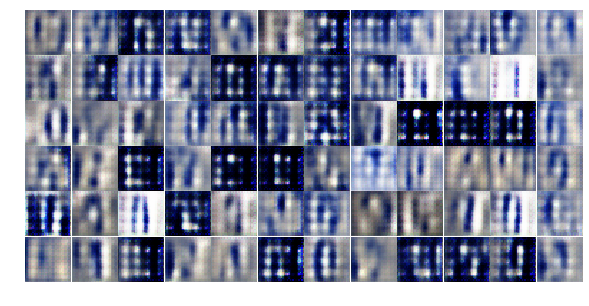

[4/25][310/573] Loss_D: 0.0295 Loss_G: 5.6199 D(x): 0.9907 D(G(z)): 0.0185 / 0.0117
[4/25][320/573] Loss_D: 0.0169 Loss_G: 6.5047 D(x): 0.9903 D(G(z)): 0.0068 / 0.0029
[4/25][330/573] Loss_D: 0.0890 Loss_G: 9.1536 D(x): 0.9991 D(G(z)): 0.0776 / 0.0028
[4/25][340/573] Loss_D: 0.0514 Loss_G: 5.9593 D(x): 0.9998 D(G(z)): 0.0448 / 0.0173
[4/25][350/573] Loss_D: 0.0711 Loss_G: 5.1677 D(x): 0.9648 D(G(z)): 0.0286 / 0.0144
[4/25][360/573] Loss_D: 0.3188 Loss_G: 3.4409 D(x): 0.9908 D(G(z)): 0.2290 / 0.0727
[4/25][370/573] Loss_D: 0.0171 Loss_G: 10.1955 D(x): 0.9875 D(G(z)): 0.0023 / 0.0007
[4/25][380/573] Loss_D: 0.0449 Loss_G: 5.7136 D(x): 0.9999 D(G(z)): 0.0347 / 0.0214
[4/25][390/573] Loss_D: 0.0010 Loss_G: 9.8716 D(x): 0.9996 D(G(z)): 0.0006 / 0.0002
[4/25][400/573] Loss_D: 0.0543 Loss_G: 4.6826 D(x): 0.9951 D(G(z)): 0.0446 / 0.0205


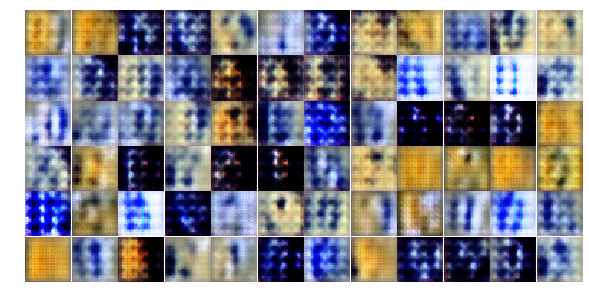

[4/25][410/573] Loss_D: 0.2417 Loss_G: 4.8204 D(x): 0.8832 D(G(z)): 0.0669 / 0.0207
[4/25][420/573] Loss_D: 0.4186 Loss_G: 5.8617 D(x): 0.9605 D(G(z)): 0.2712 / 0.0118
[4/25][430/573] Loss_D: 0.0914 Loss_G: 4.8855 D(x): 0.9451 D(G(z)): 0.0232 / 0.0181
[4/25][440/573] Loss_D: 0.0156 Loss_G: 8.1897 D(x): 0.9889 D(G(z)): 0.0040 / 0.0008
[4/25][450/573] Loss_D: 0.0889 Loss_G: 5.5164 D(x): 0.9850 D(G(z)): 0.0611 / 0.0153
[4/25][460/573] Loss_D: 0.2176 Loss_G: 4.3510 D(x): 0.8959 D(G(z)): 0.0642 / 0.0420
[4/25][470/573] Loss_D: 0.2281 Loss_G: 4.3940 D(x): 0.9783 D(G(z)): 0.1421 / 0.0483
[4/25][480/573] Loss_D: 0.1121 Loss_G: 6.4376 D(x): 0.9463 D(G(z)): 0.0294 / 0.0113
[4/25][490/573] Loss_D: 0.0760 Loss_G: 8.0783 D(x): 0.9429 D(G(z)): 0.0025 / 0.0013
[4/25][500/573] Loss_D: 0.0347 Loss_G: 6.4645 D(x): 0.9856 D(G(z)): 0.0184 / 0.0053


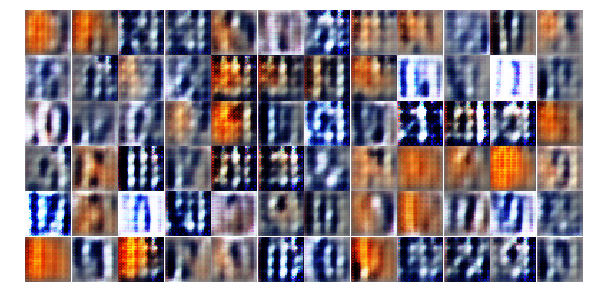

[4/25][510/573] Loss_D: 0.0411 Loss_G: 5.7972 D(x): 0.9817 D(G(z)): 0.0206 / 0.0106
[4/25][520/573] Loss_D: 0.2560 Loss_G: 4.7770 D(x): 0.8538 D(G(z)): 0.0463 / 0.0253
[4/25][530/573] Loss_D: 0.7423 Loss_G: 4.7476 D(x): 0.9022 D(G(z)): 0.2694 / 0.0276
[4/25][540/573] Loss_D: 0.4299 Loss_G: 3.6720 D(x): 0.9582 D(G(z)): 0.2462 / 0.0807
[4/25][550/573] Loss_D: 0.3742 Loss_G: 3.0464 D(x): 0.9214 D(G(z)): 0.1885 / 0.0957
[4/25][560/573] Loss_D: 0.0696 Loss_G: 5.9323 D(x): 0.9772 D(G(z)): 0.0392 / 0.0167
[4/25][570/573] Loss_D: 0.1223 Loss_G: 4.5255 D(x): 0.9357 D(G(z)): 0.0403 / 0.0170
[5/25][0/573] Loss_D: 0.0745 Loss_G: 4.3740 D(x): 0.9690 D(G(z)): 0.0312 / 0.0243


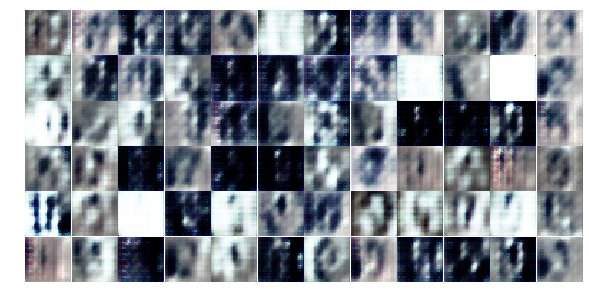

[5/25][10/573] Loss_D: 0.1872 Loss_G: 3.2512 D(x): 0.9311 D(G(z)): 0.0885 / 0.0626
[5/25][20/573] Loss_D: 0.2095 Loss_G: 3.2140 D(x): 0.9545 D(G(z)): 0.1326 / 0.0613
[5/25][30/573] Loss_D: 0.2625 Loss_G: 3.6117 D(x): 0.8809 D(G(z)): 0.0702 / 0.0808
[5/25][40/573] Loss_D: 0.3231 Loss_G: 3.1789 D(x): 0.8302 D(G(z)): 0.0910 / 0.0766
[5/25][50/573] Loss_D: 0.1495 Loss_G: 4.6616 D(x): 0.9096 D(G(z)): 0.0378 / 0.0200
[5/25][60/573] Loss_D: 0.1134 Loss_G: 4.0149 D(x): 0.9599 D(G(z)): 0.0609 / 0.0339
[5/25][70/573] Loss_D: 0.0943 Loss_G: 4.2249 D(x): 0.9485 D(G(z)): 0.0342 / 0.0277
[5/25][80/573] Loss_D: 0.2116 Loss_G: 3.5526 D(x): 0.8649 D(G(z)): 0.0434 / 0.0560
[5/25][90/573] Loss_D: 0.4240 Loss_G: 7.0896 D(x): 0.7204 D(G(z)): 0.0026 / 0.0056
[5/25][100/573] Loss_D: 0.3108 Loss_G: 3.7929 D(x): 0.8000 D(G(z)): 0.0251 / 0.0516


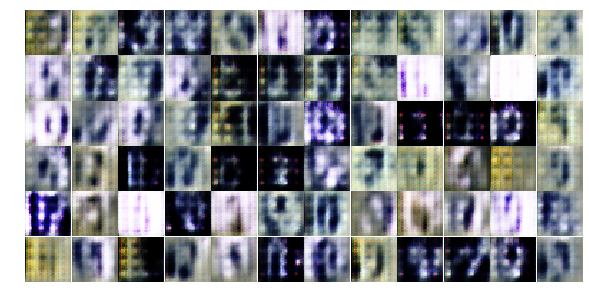

[5/25][110/573] Loss_D: 0.0937 Loss_G: 3.6284 D(x): 0.9715 D(G(z)): 0.0557 / 0.0616
[5/25][120/573] Loss_D: 0.2657 Loss_G: 2.7049 D(x): 0.9471 D(G(z)): 0.1659 / 0.1074
[5/25][130/573] Loss_D: 0.0870 Loss_G: 4.8065 D(x): 0.9691 D(G(z)): 0.0439 / 0.0200
[5/25][140/573] Loss_D: 0.1086 Loss_G: 4.6499 D(x): 0.9452 D(G(z)): 0.0425 / 0.0198
[5/25][150/573] Loss_D: 0.1413 Loss_G: 4.3296 D(x): 0.9351 D(G(z)): 0.0453 / 0.0352
[5/25][160/573] Loss_D: 0.1858 Loss_G: 4.1883 D(x): 0.9107 D(G(z)): 0.0697 / 0.0324
[5/25][170/573] Loss_D: 0.1436 Loss_G: 4.2100 D(x): 0.8999 D(G(z)): 0.0186 / 0.0306
[5/25][180/573] Loss_D: 0.1490 Loss_G: 2.1518 D(x): 0.9634 D(G(z)): 0.0903 / 0.1665
[5/25][190/573] Loss_D: 0.1943 Loss_G: 8.6341 D(x): 0.8459 D(G(z)): 0.0011 / 0.0004
[5/25][200/573] Loss_D: 0.2002 Loss_G: 6.3521 D(x): 0.8576 D(G(z)): 0.0032 / 0.0049


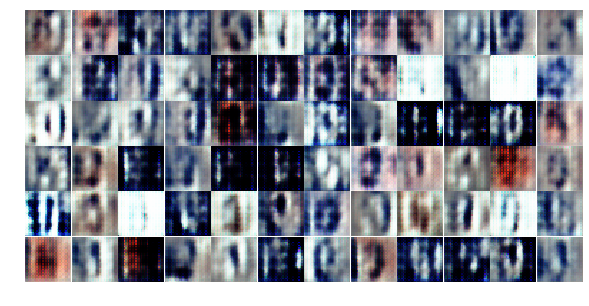

[5/25][210/573] Loss_D: 0.2333 Loss_G: 2.8873 D(x): 0.9777 D(G(z)): 0.1541 / 0.1167
[5/25][220/573] Loss_D: 0.1667 Loss_G: 2.7335 D(x): 0.9991 D(G(z)): 0.1360 / 0.1223
[5/25][230/573] Loss_D: 0.1502 Loss_G: 2.8736 D(x): 0.9859 D(G(z)): 0.1137 / 0.0936
[5/25][240/573] Loss_D: 0.2599 Loss_G: 2.6885 D(x): 0.9656 D(G(z)): 0.1719 / 0.1162
[5/25][250/573] Loss_D: 0.2495 Loss_G: 3.3868 D(x): 0.9571 D(G(z)): 0.1505 / 0.0661
[5/25][260/573] Loss_D: 0.1709 Loss_G: 4.1534 D(x): 0.9475 D(G(z)): 0.0949 / 0.0467
[5/25][270/573] Loss_D: 0.4256 Loss_G: 4.0305 D(x): 0.8361 D(G(z)): 0.1128 / 0.0649
[5/25][280/573] Loss_D: 0.1415 Loss_G: 4.7396 D(x): 0.9360 D(G(z)): 0.0556 / 0.0332
[5/25][290/573] Loss_D: 0.1423 Loss_G: 5.7774 D(x): 0.8963 D(G(z)): 0.0075 / 0.0072
[5/25][300/573] Loss_D: 0.1683 Loss_G: 3.6125 D(x): 0.9817 D(G(z)): 0.1157 / 0.0775


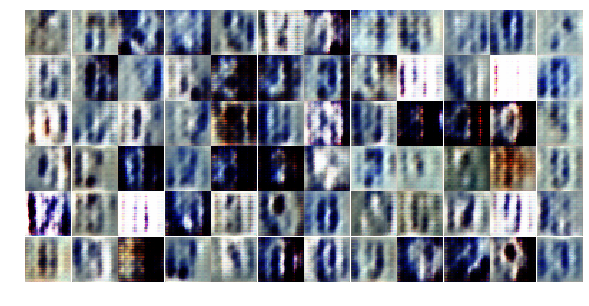

[5/25][310/573] Loss_D: 0.0639 Loss_G: 6.0442 D(x): 0.9728 D(G(z)): 0.0308 / 0.0077
[5/25][320/573] Loss_D: 0.3696 Loss_G: 3.1471 D(x): 0.9542 D(G(z)): 0.2162 / 0.1042
[5/25][330/573] Loss_D: 0.1486 Loss_G: 3.5602 D(x): 0.9409 D(G(z)): 0.0592 / 0.0691
[5/25][340/573] Loss_D: 0.1069 Loss_G: 4.2125 D(x): 0.9670 D(G(z)): 0.0529 / 0.0362
[5/25][350/573] Loss_D: 0.2320 Loss_G: 3.8988 D(x): 0.8759 D(G(z)): 0.0546 / 0.0417
[5/25][360/573] Loss_D: 0.5505 Loss_G: 4.6705 D(x): 0.8719 D(G(z)): 0.2263 / 0.0327
[5/25][370/573] Loss_D: 0.1048 Loss_G: 6.0414 D(x): 0.9579 D(G(z)): 0.0490 / 0.0079
[5/25][380/573] Loss_D: 0.1450 Loss_G: 5.1105 D(x): 0.9292 D(G(z)): 0.0544 / 0.0200
[5/25][390/573] Loss_D: 0.3024 Loss_G: 4.7337 D(x): 0.8058 D(G(z)): 0.0066 / 0.0196
[5/25][400/573] Loss_D: 0.2077 Loss_G: 4.3405 D(x): 0.9392 D(G(z)): 0.0991 / 0.0318


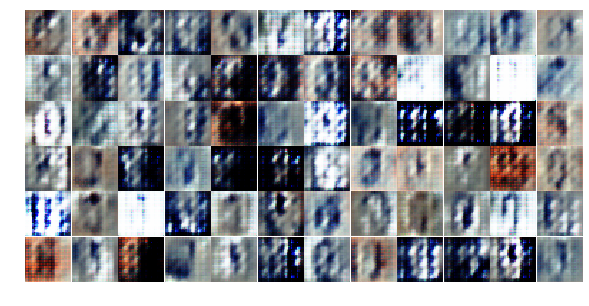

[5/25][410/573] Loss_D: 1.0450 Loss_G: 2.1058 D(x): 0.4937 D(G(z)): 0.0157 / 0.2191
[5/25][420/573] Loss_D: 0.1731 Loss_G: 3.6949 D(x): 0.9997 D(G(z)): 0.1397 / 0.0543
[5/25][430/573] Loss_D: 0.0586 Loss_G: 4.7762 D(x): 0.9778 D(G(z)): 0.0312 / 0.0254
[5/25][440/573] Loss_D: 0.2643 Loss_G: 3.5007 D(x): 0.9868 D(G(z)): 0.1940 / 0.0579
[5/25][450/573] Loss_D: 0.1095 Loss_G: 4.4203 D(x): 0.9860 D(G(z)): 0.0798 / 0.0304
[5/25][460/573] Loss_D: 0.2870 Loss_G: 4.5768 D(x): 0.8495 D(G(z)): 0.0691 / 0.0237
[5/25][470/573] Loss_D: 0.2603 Loss_G: 4.2733 D(x): 0.8332 D(G(z)): 0.0272 / 0.0343
[5/25][480/573] Loss_D: 0.2097 Loss_G: 4.2830 D(x): 0.9924 D(G(z)): 0.1471 / 0.0426
[5/25][490/573] Loss_D: 0.1290 Loss_G: 5.3887 D(x): 0.9092 D(G(z)): 0.0197 / 0.0138
[5/25][500/573] Loss_D: 0.1229 Loss_G: 4.8783 D(x): 0.9096 D(G(z)): 0.0189 / 0.0181


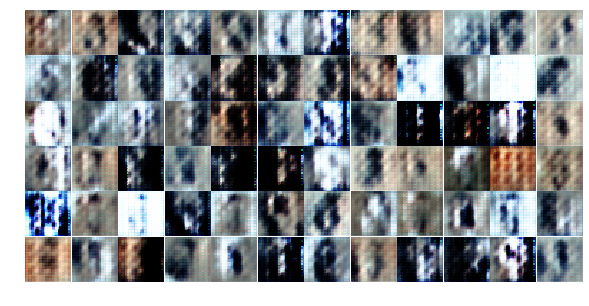

[5/25][510/573] Loss_D: 0.0689 Loss_G: 7.1400 D(x): 0.9633 D(G(z)): 0.0183 / 0.0020
[5/25][520/573] Loss_D: 0.0989 Loss_G: 3.6542 D(x): 0.9652 D(G(z)): 0.0487 / 0.0523
[5/25][530/573] Loss_D: 0.0524 Loss_G: 6.6464 D(x): 0.9696 D(G(z)): 0.0179 / 0.0050
[5/25][540/573] Loss_D: 0.0982 Loss_G: 4.5592 D(x): 0.9438 D(G(z)): 0.0249 / 0.0251
[5/25][550/573] Loss_D: 0.0505 Loss_G: 6.0007 D(x): 0.9747 D(G(z)): 0.0220 / 0.0064
[5/25][560/573] Loss_D: 0.0732 Loss_G: 5.2092 D(x): 0.9607 D(G(z)): 0.0260 / 0.0111
[5/25][570/573] Loss_D: 0.4098 Loss_G: 4.3186 D(x): 0.9791 D(G(z)): 0.2746 / 0.0310
[6/25][0/573] Loss_D: 0.0658 Loss_G: 7.6919 D(x): 0.9497 D(G(z)): 0.0080 / 0.0016


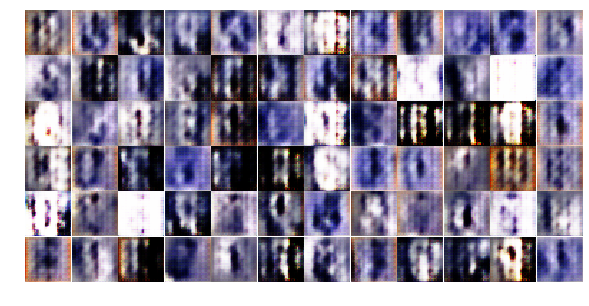

[6/25][10/573] Loss_D: 0.1524 Loss_G: 3.4405 D(x): 0.9834 D(G(z)): 0.1086 / 0.0780
[6/25][20/573] Loss_D: 0.0727 Loss_G: 6.1947 D(x): 0.9729 D(G(z)): 0.0398 / 0.0063
[6/25][30/573] Loss_D: 0.1405 Loss_G: 4.8865 D(x): 0.9041 D(G(z)): 0.0259 / 0.0142
[6/25][40/573] Loss_D: 0.1207 Loss_G: 4.0141 D(x): 0.9883 D(G(z)): 0.0911 / 0.0367
[6/25][50/573] Loss_D: 0.1134 Loss_G: 5.1222 D(x): 0.9320 D(G(z)): 0.0222 / 0.0126
[6/25][60/573] Loss_D: 0.5699 Loss_G: 4.5618 D(x): 0.6230 D(G(z)): 0.0020 / 0.0197
[6/25][70/573] Loss_D: 0.1706 Loss_G: 4.0106 D(x): 0.9682 D(G(z)): 0.1056 / 0.0592
[6/25][80/573] Loss_D: 0.3310 Loss_G: 4.7427 D(x): 0.8105 D(G(z)): 0.0593 / 0.0215
[6/25][90/573] Loss_D: 0.3982 Loss_G: 6.7302 D(x): 0.9846 D(G(z)): 0.2393 / 0.0034
[6/25][100/573] Loss_D: 0.1907 Loss_G: 9.3748 D(x): 0.8653 D(G(z)): 0.0007 / 0.0004


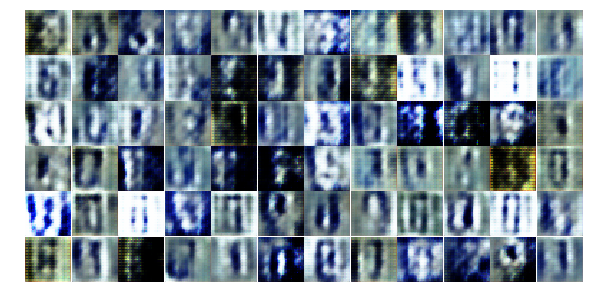

[6/25][110/573] Loss_D: 0.0285 Loss_G: 7.2545 D(x): 0.9855 D(G(z)): 0.0122 / 0.0024
[6/25][120/573] Loss_D: 0.1786 Loss_G: 5.4261 D(x): 0.8911 D(G(z)): 0.0146 / 0.0139
[6/25][130/573] Loss_D: 0.0581 Loss_G: 5.8010 D(x): 0.9748 D(G(z)): 0.0291 / 0.0110
[6/25][140/573] Loss_D: 0.1388 Loss_G: 3.5277 D(x): 0.9769 D(G(z)): 0.0995 / 0.0537
[6/25][150/573] Loss_D: 0.2168 Loss_G: 4.1572 D(x): 0.8593 D(G(z)): 0.0323 / 0.0327
[6/25][160/573] Loss_D: 0.0639 Loss_G: 5.6927 D(x): 0.9706 D(G(z)): 0.0285 / 0.0102
[6/25][170/573] Loss_D: 0.2216 Loss_G: 4.9456 D(x): 0.8628 D(G(z)): 0.0285 / 0.0146
[6/25][180/573] Loss_D: 0.3010 Loss_G: 3.8015 D(x): 0.9341 D(G(z)): 0.1732 / 0.0501
[6/25][190/573] Loss_D: 0.0512 Loss_G: 4.8177 D(x): 0.9813 D(G(z)): 0.0307 / 0.0136
[6/25][200/573] Loss_D: 0.2618 Loss_G: 3.3546 D(x): 0.8719 D(G(z)): 0.0834 / 0.0582


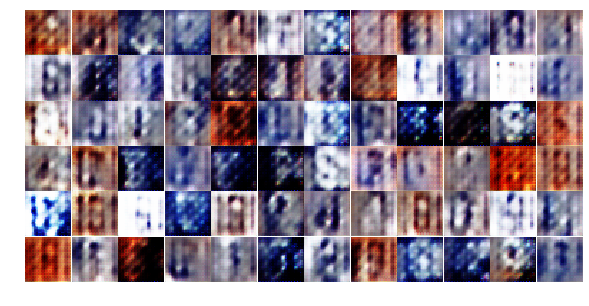

[6/25][210/573] Loss_D: 0.4964 Loss_G: 3.4053 D(x): 0.8560 D(G(z)): 0.2265 / 0.0808
[6/25][220/573] Loss_D: 0.1289 Loss_G: 4.1246 D(x): 0.9438 D(G(z)): 0.0530 / 0.0497
[6/25][230/573] Loss_D: 0.1732 Loss_G: 4.1299 D(x): 0.8965 D(G(z)): 0.0255 / 0.0513
[6/25][240/573] Loss_D: 0.0870 Loss_G: 5.6706 D(x): 0.9527 D(G(z)): 0.0273 / 0.0077
[6/25][250/573] Loss_D: 0.0991 Loss_G: 6.0823 D(x): 0.9242 D(G(z)): 0.0129 / 0.0062
[6/25][260/573] Loss_D: 0.1609 Loss_G: 4.1386 D(x): 0.9849 D(G(z)): 0.1184 / 0.0361
[6/25][270/573] Loss_D: 0.4278 Loss_G: 2.0099 D(x): 0.8979 D(G(z)): 0.2073 / 0.3167
[6/25][280/573] Loss_D: 0.2519 Loss_G: 3.8702 D(x): 0.9915 D(G(z)): 0.1817 / 0.0624
[6/25][290/573] Loss_D: 0.0784 Loss_G: 5.2601 D(x): 0.9776 D(G(z)): 0.0509 / 0.0099
[6/25][300/573] Loss_D: 0.3700 Loss_G: 3.8022 D(x): 0.9959 D(G(z)): 0.2369 / 0.0526


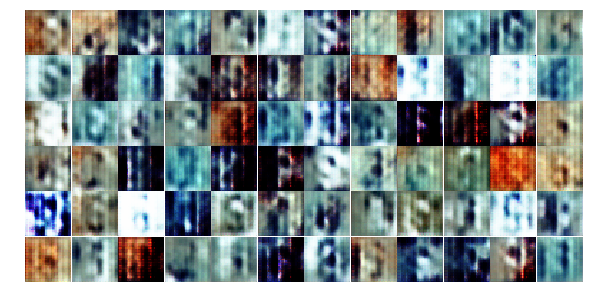

[6/25][310/573] Loss_D: 0.1049 Loss_G: 4.4482 D(x): 0.9564 D(G(z)): 0.0514 / 0.0229
[6/25][320/573] Loss_D: 0.1607 Loss_G: 3.2529 D(x): 0.9111 D(G(z)): 0.0454 / 0.0700
[6/25][330/573] Loss_D: 0.1188 Loss_G: 4.5734 D(x): 0.9364 D(G(z)): 0.0350 / 0.0228
[6/25][340/573] Loss_D: 0.3264 Loss_G: 3.1701 D(x): 0.9793 D(G(z)): 0.2283 / 0.0727
[6/25][350/573] Loss_D: 0.0494 Loss_G: 5.2137 D(x): 0.9692 D(G(z)): 0.0164 / 0.0106
[6/25][360/573] Loss_D: 0.3623 Loss_G: 2.9594 D(x): 0.7707 D(G(z)): 0.0232 / 0.0898
[6/25][370/573] Loss_D: 0.1775 Loss_G: 5.0538 D(x): 0.9922 D(G(z)): 0.1326 / 0.0288
[6/25][380/573] Loss_D: 0.1573 Loss_G: 4.6227 D(x): 0.9674 D(G(z)): 0.0902 / 0.0393
[6/25][390/573] Loss_D: 0.4705 Loss_G: 4.0777 D(x): 0.7317 D(G(z)): 0.0449 / 0.0315
[6/25][400/573] Loss_D: 0.1138 Loss_G: 5.1036 D(x): 0.9369 D(G(z)): 0.0230 / 0.0186


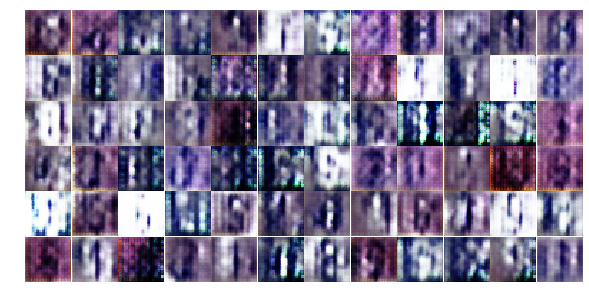

[6/25][410/573] Loss_D: 0.1270 Loss_G: 3.6328 D(x): 0.9454 D(G(z)): 0.0532 / 0.0567
[6/25][420/573] Loss_D: 0.1008 Loss_G: 4.1384 D(x): 0.9602 D(G(z)): 0.0535 / 0.0328
[6/25][430/573] Loss_D: 0.2639 Loss_G: 3.6540 D(x): 0.8493 D(G(z)): 0.0638 / 0.0464
[6/25][440/573] Loss_D: 0.2668 Loss_G: 3.2061 D(x): 0.9638 D(G(z)): 0.1804 / 0.0731
[6/25][450/573] Loss_D: 0.1367 Loss_G: 4.9202 D(x): 0.9352 D(G(z)): 0.0519 / 0.0134
[6/25][460/573] Loss_D: 0.0582 Loss_G: 5.1243 D(x): 0.9729 D(G(z)): 0.0286 / 0.0125
[6/25][470/573] Loss_D: 0.0410 Loss_G: 5.1827 D(x): 0.9803 D(G(z)): 0.0165 / 0.0115
[6/25][480/573] Loss_D: 0.1321 Loss_G: 4.5670 D(x): 0.9341 D(G(z)): 0.0465 / 0.0215
[6/25][490/573] Loss_D: 0.7375 Loss_G: 6.1230 D(x): 0.5674 D(G(z)): 0.0018 / 0.0062
[6/25][500/573] Loss_D: 0.3673 Loss_G: 6.8857 D(x): 0.7483 D(G(z)): 0.0009 / 0.0037


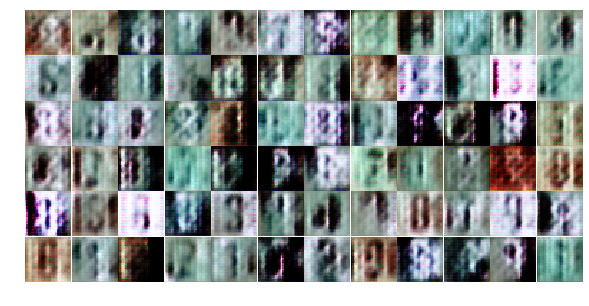

[6/25][510/573] Loss_D: 0.4140 Loss_G: 3.4978 D(x): 0.9541 D(G(z)): 0.2255 / 0.0635
[6/25][520/573] Loss_D: 0.1300 Loss_G: 5.3476 D(x): 0.9469 D(G(z)): 0.0502 / 0.0287
[6/25][530/573] Loss_D: 0.0264 Loss_G: 5.9021 D(x): 0.9931 D(G(z)): 0.0186 / 0.0086
[6/25][540/573] Loss_D: 0.0688 Loss_G: 5.1435 D(x): 0.9793 D(G(z)): 0.0435 / 0.0146
[6/25][550/573] Loss_D: 0.0310 Loss_G: 7.4587 D(x): 0.9750 D(G(z)): 0.0030 / 0.0012
[6/25][560/573] Loss_D: 0.0343 Loss_G: 6.2354 D(x): 0.9878 D(G(z)): 0.0198 / 0.0050
[6/25][570/573] Loss_D: 0.1644 Loss_G: 7.2180 D(x): 0.8747 D(G(z)): 0.0093 / 0.0020
[7/25][0/573] Loss_D: 0.1722 Loss_G: 2.5576 D(x): 0.9583 D(G(z)): 0.1071 / 0.1480


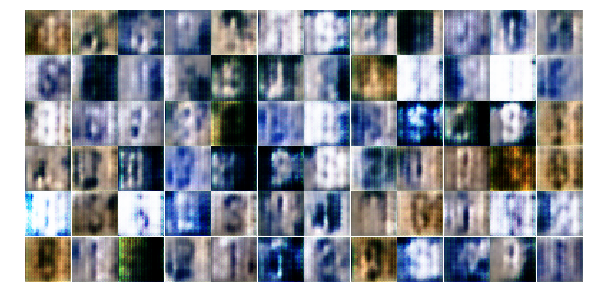

[7/25][10/573] Loss_D: 0.0655 Loss_G: 6.6725 D(x): 0.9601 D(G(z)): 0.0214 / 0.0048
[7/25][20/573] Loss_D: 0.1051 Loss_G: 4.0604 D(x): 0.9313 D(G(z)): 0.0229 / 0.0479
[7/25][30/573] Loss_D: 0.1131 Loss_G: 5.8058 D(x): 0.9965 D(G(z)): 0.0960 / 0.0063
[7/25][40/573] Loss_D: 0.2400 Loss_G: 4.7522 D(x): 0.8640 D(G(z)): 0.0317 / 0.0224
[7/25][50/573] Loss_D: 0.1660 Loss_G: 5.1429 D(x): 0.9938 D(G(z)): 0.1017 / 0.0571
[7/25][60/573] Loss_D: 0.0901 Loss_G: 7.4434 D(x): 0.9353 D(G(z)): 0.0079 / 0.0033
[7/25][70/573] Loss_D: 0.0729 Loss_G: 5.0406 D(x): 0.9783 D(G(z)): 0.0452 / 0.0185
[7/25][80/573] Loss_D: 0.2142 Loss_G: 4.5107 D(x): 0.8757 D(G(z)): 0.0397 / 0.0292
[7/25][90/573] Loss_D: 0.0798 Loss_G: 4.2634 D(x): 0.9805 D(G(z)): 0.0529 / 0.0324
[7/25][100/573] Loss_D: 0.1981 Loss_G: 4.9956 D(x): 0.8601 D(G(z)): 0.0244 / 0.0138


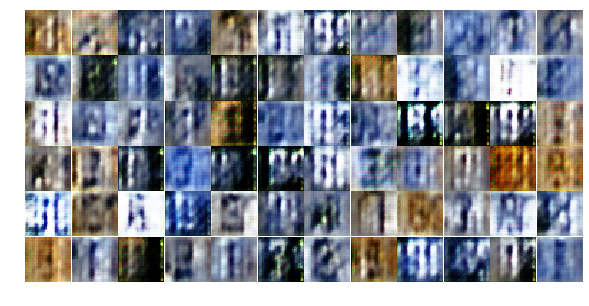

[7/25][110/573] Loss_D: 0.1244 Loss_G: 4.0363 D(x): 0.9457 D(G(z)): 0.0558 / 0.0397
[7/25][120/573] Loss_D: 0.4464 Loss_G: 2.6951 D(x): 0.9138 D(G(z)): 0.2596 / 0.1264
[7/25][130/573] Loss_D: 0.7019 Loss_G: 2.8333 D(x): 0.6147 D(G(z)): 0.0201 / 0.1164
[7/25][140/573] Loss_D: 0.4012 Loss_G: 3.1311 D(x): 0.9373 D(G(z)): 0.2082 / 0.1054
[7/25][150/573] Loss_D: 0.2621 Loss_G: 4.0218 D(x): 0.8909 D(G(z)): 0.0986 / 0.0397
[7/25][160/573] Loss_D: 0.4374 Loss_G: 3.4037 D(x): 0.8341 D(G(z)): 0.1447 / 0.0663
[7/25][170/573] Loss_D: 0.2346 Loss_G: 4.0672 D(x): 0.8910 D(G(z)): 0.0782 / 0.0463
[7/25][180/573] Loss_D: 0.1612 Loss_G: 4.4781 D(x): 0.9328 D(G(z)): 0.0585 / 0.0533
[7/25][190/573] Loss_D: 0.1975 Loss_G: 4.7071 D(x): 0.8965 D(G(z)): 0.0564 / 0.0251
[7/25][200/573] Loss_D: 0.1926 Loss_G: 3.8953 D(x): 0.9697 D(G(z)): 0.1250 / 0.0433


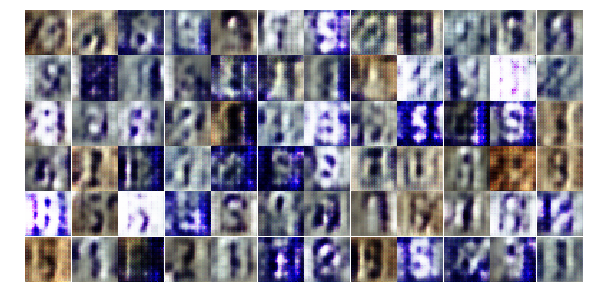

[7/25][210/573] Loss_D: 0.6043 Loss_G: 1.7687 D(x): 0.6647 D(G(z)): 0.0561 / 0.2850
[7/25][220/573] Loss_D: 0.7010 Loss_G: 5.3598 D(x): 0.6491 D(G(z)): 0.0183 / 0.0146
[7/25][230/573] Loss_D: 0.1281 Loss_G: 4.9947 D(x): 0.9807 D(G(z)): 0.0938 / 0.0148
[7/25][240/573] Loss_D: 0.2152 Loss_G: 5.7736 D(x): 0.8432 D(G(z)): 0.0107 / 0.0071
[7/25][250/573] Loss_D: 0.1359 Loss_G: 3.9497 D(x): 0.9336 D(G(z)): 0.0578 / 0.0441
[7/25][260/573] Loss_D: 0.2311 Loss_G: 4.0616 D(x): 0.8591 D(G(z)): 0.0464 / 0.0384
[7/25][270/573] Loss_D: 0.1076 Loss_G: 4.2996 D(x): 0.9570 D(G(z)): 0.0541 / 0.0315
[7/25][280/573] Loss_D: 0.0722 Loss_G: 4.5420 D(x): 0.9745 D(G(z)): 0.0408 / 0.0228
[7/25][290/573] Loss_D: 0.1898 Loss_G: 3.5388 D(x): 0.8908 D(G(z)): 0.0466 / 0.0495
[7/25][300/573] Loss_D: 0.1517 Loss_G: 5.7086 D(x): 0.8980 D(G(z)): 0.0179 / 0.0073


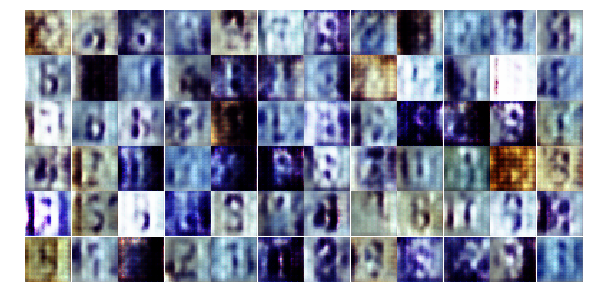

[7/25][310/573] Loss_D: 0.2885 Loss_G: 3.5521 D(x): 0.9429 D(G(z)): 0.1819 / 0.0473
[7/25][320/573] Loss_D: 0.0234 Loss_G: 6.6631 D(x): 0.9863 D(G(z)): 0.0091 / 0.0024
[7/25][330/573] Loss_D: 0.1585 Loss_G: 4.0817 D(x): 0.9027 D(G(z)): 0.0429 / 0.0264
[7/25][340/573] Loss_D: 0.5114 Loss_G: 2.9763 D(x): 0.6741 D(G(z)): 0.0372 / 0.0996
[7/25][350/573] Loss_D: 1.0734 Loss_G: 4.3101 D(x): 0.4569 D(G(z)): 0.0171 / 0.0266
[7/25][360/573] Loss_D: 0.1067 Loss_G: 4.2650 D(x): 0.9335 D(G(z)): 0.0219 / 0.0361
[7/25][370/573] Loss_D: 0.4050 Loss_G: 2.6110 D(x): 0.9158 D(G(z)): 0.2215 / 0.1233
[7/25][380/573] Loss_D: 0.3808 Loss_G: 3.9544 D(x): 0.8534 D(G(z)): 0.1227 / 0.0418
[7/25][390/573] Loss_D: 0.5069 Loss_G: 4.2138 D(x): 0.9441 D(G(z)): 0.2973 / 0.0336
[7/25][400/573] Loss_D: 0.1222 Loss_G: 3.3334 D(x): 0.9578 D(G(z)): 0.0675 / 0.1112


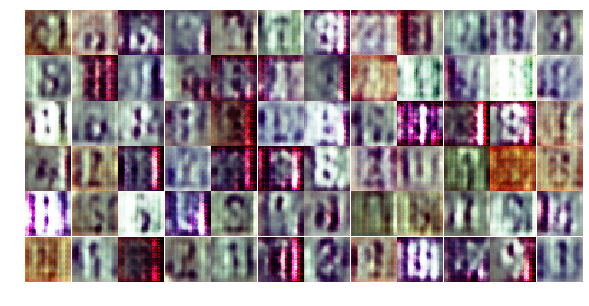

[7/25][410/573] Loss_D: 0.1133 Loss_G: 4.4463 D(x): 0.9602 D(G(z)): 0.0615 / 0.0289
[7/25][420/573] Loss_D: 0.1165 Loss_G: 4.4947 D(x): 0.9688 D(G(z)): 0.0712 / 0.0290
[7/25][430/573] Loss_D: 0.1752 Loss_G: 4.8447 D(x): 0.9320 D(G(z)): 0.0887 / 0.0152
[7/25][440/573] Loss_D: 0.1789 Loss_G: 5.7492 D(x): 0.8863 D(G(z)): 0.0251 / 0.0099
[7/25][450/573] Loss_D: 0.2068 Loss_G: 4.2191 D(x): 0.9473 D(G(z)): 0.1095 / 0.0244
[7/25][460/573] Loss_D: 0.3527 Loss_G: 4.2640 D(x): 0.9452 D(G(z)): 0.2146 / 0.0301
[7/25][470/573] Loss_D: 0.1036 Loss_G: 5.4879 D(x): 0.9231 D(G(z)): 0.0073 / 0.0093
[7/25][480/573] Loss_D: 0.2111 Loss_G: 4.1181 D(x): 0.9855 D(G(z)): 0.1521 / 0.0439
[7/25][490/573] Loss_D: 0.1025 Loss_G: 5.0603 D(x): 0.9776 D(G(z)): 0.0666 / 0.0192
[7/25][500/573] Loss_D: 0.3866 Loss_G: 3.8893 D(x): 0.9637 D(G(z)): 0.2442 / 0.0406


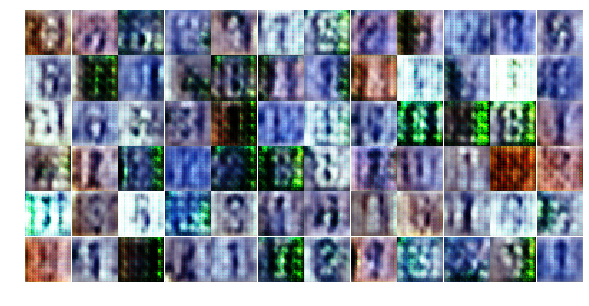

[7/25][510/573] Loss_D: 0.2976 Loss_G: 4.0413 D(x): 0.8631 D(G(z)): 0.1018 / 0.0373
[7/25][520/573] Loss_D: 0.8856 Loss_G: 2.4516 D(x): 0.7241 D(G(z)): 0.3041 / 0.1461
[7/25][530/573] Loss_D: 0.2100 Loss_G: 5.4634 D(x): 0.8471 D(G(z)): 0.0161 / 0.0090
[7/25][540/573] Loss_D: 0.2693 Loss_G: 3.4604 D(x): 0.8232 D(G(z)): 0.0267 / 0.0595
[7/25][550/573] Loss_D: 0.6033 Loss_G: 1.8504 D(x): 0.6753 D(G(z)): 0.0659 / 0.2323
[7/25][560/573] Loss_D: 0.1678 Loss_G: 4.4108 D(x): 0.9882 D(G(z)): 0.1271 / 0.0314
[7/25][570/573] Loss_D: 0.1097 Loss_G: 4.5077 D(x): 0.9759 D(G(z)): 0.0718 / 0.0314
[8/25][0/573] Loss_D: 0.3468 Loss_G: 3.0630 D(x): 0.8200 D(G(z)): 0.0858 / 0.0846


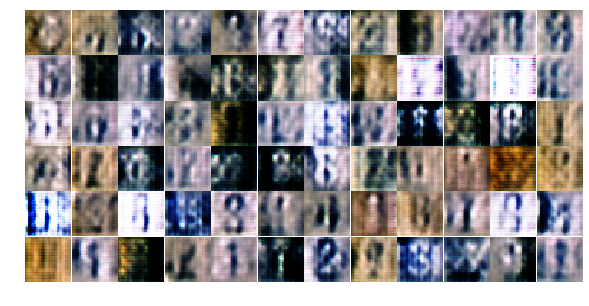

[8/25][10/573] Loss_D: 1.3384 Loss_G: 4.4512 D(x): 0.4021 D(G(z)): 0.0041 / 0.0277
[8/25][20/573] Loss_D: 0.2280 Loss_G: 4.0115 D(x): 0.9555 D(G(z)): 0.1416 / 0.0503
[8/25][30/573] Loss_D: 0.2653 Loss_G: 2.9522 D(x): 0.8640 D(G(z)): 0.0663 / 0.1126
[8/25][40/573] Loss_D: 0.1107 Loss_G: 3.5315 D(x): 0.9636 D(G(z)): 0.0644 / 0.0494
[8/25][50/573] Loss_D: 0.2872 Loss_G: 4.9500 D(x): 0.8466 D(G(z)): 0.0709 / 0.0169
[8/25][60/573] Loss_D: 0.3449 Loss_G: 4.0373 D(x): 0.9418 D(G(z)): 0.2123 / 0.0356
[8/25][70/573] Loss_D: 0.1716 Loss_G: 7.2524 D(x): 0.8842 D(G(z)): 0.0121 / 0.0045
[8/25][80/573] Loss_D: 0.0303 Loss_G: 6.4447 D(x): 0.9833 D(G(z)): 0.0125 / 0.0056
[8/25][90/573] Loss_D: 0.0839 Loss_G: 4.5175 D(x): 0.9712 D(G(z)): 0.0498 / 0.0238
[8/25][100/573] Loss_D: 0.1310 Loss_G: 4.5981 D(x): 0.9330 D(G(z)): 0.0483 / 0.0169


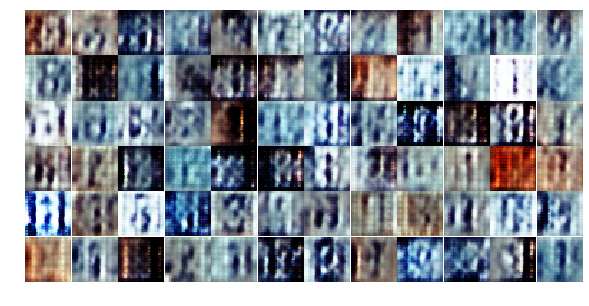

[8/25][110/573] Loss_D: 0.2898 Loss_G: 3.5053 D(x): 0.9678 D(G(z)): 0.2008 / 0.0551
[8/25][120/573] Loss_D: 0.2839 Loss_G: 4.2020 D(x): 0.8826 D(G(z)): 0.1144 / 0.0336
[8/25][130/573] Loss_D: 0.1674 Loss_G: 3.4364 D(x): 0.9738 D(G(z)): 0.1150 / 0.0683
[8/25][140/573] Loss_D: 0.1865 Loss_G: 4.3047 D(x): 0.9148 D(G(z)): 0.0618 / 0.0387
[8/25][150/573] Loss_D: 0.1163 Loss_G: 5.2448 D(x): 0.9394 D(G(z)): 0.0424 / 0.0112
[8/25][160/573] Loss_D: 0.1677 Loss_G: 2.5306 D(x): 0.9662 D(G(z)): 0.1068 / 0.1367
[8/25][170/573] Loss_D: 0.0398 Loss_G: 5.5340 D(x): 0.9748 D(G(z)): 0.0118 / 0.0125
[8/25][180/573] Loss_D: 0.0696 Loss_G: 4.8224 D(x): 0.9584 D(G(z)): 0.0224 / 0.0165
[8/25][190/573] Loss_D: 0.3238 Loss_G: 3.8438 D(x): 0.8593 D(G(z)): 0.1143 / 0.0422
[8/25][200/573] Loss_D: 0.5257 Loss_G: 2.2983 D(x): 0.9163 D(G(z)): 0.2954 / 0.1461


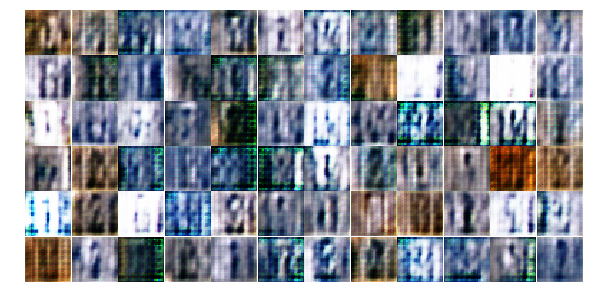

[8/25][210/573] Loss_D: 0.3352 Loss_G: 4.3060 D(x): 0.9229 D(G(z)): 0.1696 / 0.0622
[8/25][220/573] Loss_D: 0.2460 Loss_G: 5.1537 D(x): 0.8454 D(G(z)): 0.0148 / 0.0134
[8/25][230/573] Loss_D: 0.1688 Loss_G: 3.8636 D(x): 0.9077 D(G(z)): 0.0445 / 0.0534
[8/25][240/573] Loss_D: 0.6346 Loss_G: 4.1639 D(x): 0.6524 D(G(z)): 0.0232 / 0.0315
[8/25][250/573] Loss_D: 0.1483 Loss_G: 4.3559 D(x): 0.9613 D(G(z)): 0.0939 / 0.0263
[8/25][260/573] Loss_D: 0.2267 Loss_G: 2.8814 D(x): 0.9387 D(G(z)): 0.1364 / 0.0948
[8/25][270/573] Loss_D: 0.4628 Loss_G: 3.0407 D(x): 0.7558 D(G(z)): 0.0874 / 0.1005
[8/25][280/573] Loss_D: 0.1771 Loss_G: 4.4050 D(x): 0.9601 D(G(z)): 0.0992 / 0.0290
[8/25][290/573] Loss_D: 0.2496 Loss_G: 3.3620 D(x): 0.8691 D(G(z)): 0.0734 / 0.0609
[8/25][300/573] Loss_D: 0.4992 Loss_G: 4.1471 D(x): 0.7365 D(G(z)): 0.0925 / 0.0313


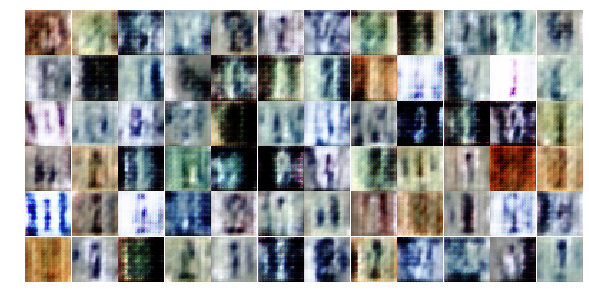

[8/25][310/573] Loss_D: 0.6005 Loss_G: 2.8466 D(x): 0.8884 D(G(z)): 0.3226 / 0.0962
[8/25][320/573] Loss_D: 0.4609 Loss_G: 3.8044 D(x): 0.7182 D(G(z)): 0.0247 / 0.0383
[8/25][330/573] Loss_D: 0.1171 Loss_G: 3.6742 D(x): 0.9786 D(G(z)): 0.0754 / 0.0614
[8/25][340/573] Loss_D: 0.3210 Loss_G: 3.7960 D(x): 0.9401 D(G(z)): 0.1825 / 0.0455
[8/25][350/573] Loss_D: 0.7054 Loss_G: 3.5672 D(x): 0.6394 D(G(z)): 0.0921 / 0.0535
[8/25][360/573] Loss_D: 0.4624 Loss_G: 3.7684 D(x): 0.9587 D(G(z)): 0.2895 / 0.0465
[8/25][370/573] Loss_D: 0.4332 Loss_G: 4.0934 D(x): 0.7218 D(G(z)): 0.0202 / 0.0389
[8/25][380/573] Loss_D: 0.1658 Loss_G: 2.9635 D(x): 0.9785 D(G(z)): 0.1235 / 0.0858
[8/25][390/573] Loss_D: 0.1397 Loss_G: 4.2884 D(x): 0.9137 D(G(z)): 0.0361 / 0.0270
[8/25][400/573] Loss_D: 0.1337 Loss_G: 3.4084 D(x): 0.9305 D(G(z)): 0.0341 / 0.0538


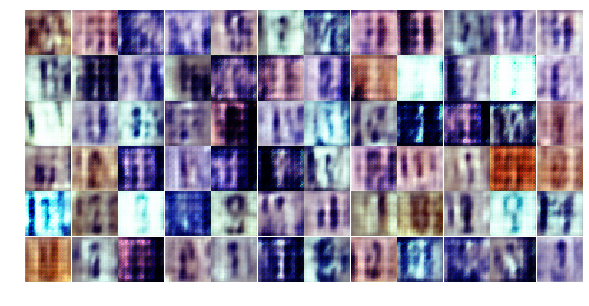

[8/25][410/573] Loss_D: 0.1797 Loss_G: 2.2987 D(x): 0.8981 D(G(z)): 0.0443 / 0.1522
[8/25][420/573] Loss_D: 0.0824 Loss_G: 4.4961 D(x): 0.9581 D(G(z)): 0.0320 / 0.0256
[8/25][430/573] Loss_D: 0.6665 Loss_G: 2.2474 D(x): 0.8871 D(G(z)): 0.3384 / 0.1677
[8/25][440/573] Loss_D: 0.1333 Loss_G: 3.9052 D(x): 0.9983 D(G(z)): 0.1099 / 0.0413
[8/25][450/573] Loss_D: 0.0910 Loss_G: 3.6677 D(x): 0.9821 D(G(z)): 0.0657 / 0.0439
[8/25][460/573] Loss_D: 0.1464 Loss_G: 3.2400 D(x): 0.9627 D(G(z)): 0.0941 / 0.0642
[8/25][470/573] Loss_D: 0.4031 Loss_G: 2.6763 D(x): 0.7977 D(G(z)): 0.1164 / 0.1054
[8/25][480/573] Loss_D: 0.2576 Loss_G: 2.6395 D(x): 0.9562 D(G(z)): 0.1789 / 0.0966
[8/25][490/573] Loss_D: 0.4165 Loss_G: 2.0250 D(x): 0.9857 D(G(z)): 0.2968 / 0.1824
[8/25][500/573] Loss_D: 0.1425 Loss_G: 7.4542 D(x): 0.8949 D(G(z)): 0.0135 / 0.0016


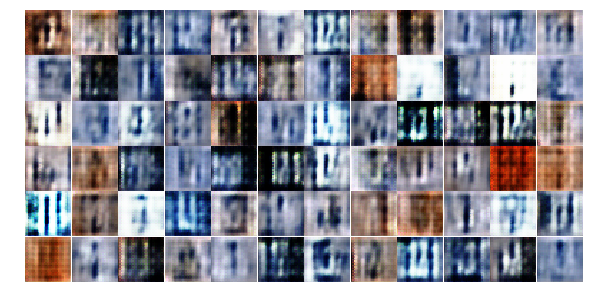

[8/25][510/573] Loss_D: 0.1657 Loss_G: 4.0451 D(x): 0.8756 D(G(z)): 0.0153 / 0.0470
[8/25][520/573] Loss_D: 0.5320 Loss_G: 2.7800 D(x): 0.9244 D(G(z)): 0.2774 / 0.1120
[8/25][530/573] Loss_D: 0.1461 Loss_G: 5.4565 D(x): 0.9265 D(G(z)): 0.0551 / 0.0314
[8/25][540/573] Loss_D: 0.2245 Loss_G: 3.8968 D(x): 0.9329 D(G(z)): 0.1195 / 0.0407
[8/25][550/573] Loss_D: 0.3137 Loss_G: 3.6301 D(x): 0.8225 D(G(z)): 0.0657 / 0.0523
[8/25][560/573] Loss_D: 1.0623 Loss_G: 2.9905 D(x): 0.4834 D(G(z)): 0.0760 / 0.1158
[8/25][570/573] Loss_D: 0.1963 Loss_G: 2.9934 D(x): 0.9643 D(G(z)): 0.1322 / 0.0880
[9/25][0/573] Loss_D: 0.2290 Loss_G: 4.2202 D(x): 0.9156 D(G(z)): 0.1027 / 0.0387


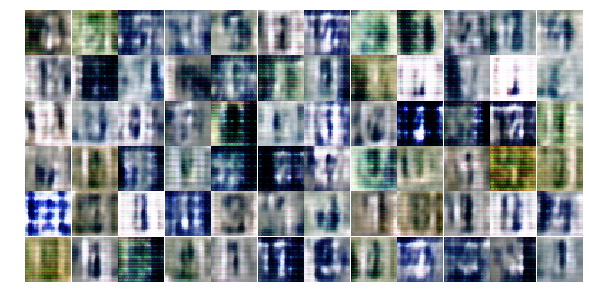

[9/25][10/573] Loss_D: 0.5881 Loss_G: 3.4925 D(x): 0.6765 D(G(z)): 0.0645 / 0.0659
[9/25][20/573] Loss_D: 0.3922 Loss_G: 4.5051 D(x): 0.7876 D(G(z)): 0.0990 / 0.0219
[9/25][30/573] Loss_D: 0.2959 Loss_G: 2.7837 D(x): 0.9358 D(G(z)): 0.1716 / 0.1057
[9/25][40/573] Loss_D: 0.3938 Loss_G: 4.3839 D(x): 0.7311 D(G(z)): 0.0206 / 0.0285
[9/25][50/573] Loss_D: 0.1241 Loss_G: 5.4888 D(x): 0.9126 D(G(z)): 0.0086 / 0.0077
[9/25][60/573] Loss_D: 0.4379 Loss_G: 3.6292 D(x): 0.7201 D(G(z)): 0.0238 / 0.0580
[9/25][70/573] Loss_D: 0.4800 Loss_G: 2.3418 D(x): 0.9736 D(G(z)): 0.3281 / 0.1393
[9/25][80/573] Loss_D: 0.3094 Loss_G: 3.1064 D(x): 0.7753 D(G(z)): 0.0173 / 0.0651
[9/25][90/573] Loss_D: 0.2801 Loss_G: 3.9471 D(x): 0.8885 D(G(z)): 0.1317 / 0.0365
[9/25][100/573] Loss_D: 0.2589 Loss_G: 3.1873 D(x): 0.9669 D(G(z)): 0.1824 / 0.0675


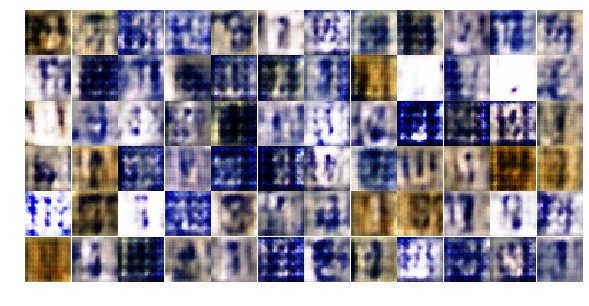

[9/25][110/573] Loss_D: 1.2577 Loss_G: 3.9592 D(x): 0.4730 D(G(z)): 0.0271 / 0.0363
[9/25][120/573] Loss_D: 0.1586 Loss_G: 2.9334 D(x): 0.9719 D(G(z)): 0.1081 / 0.1107
[9/25][130/573] Loss_D: 0.1485 Loss_G: 3.7236 D(x): 0.9653 D(G(z)): 0.0918 / 0.0561
[9/25][140/573] Loss_D: 0.1850 Loss_G: 3.9923 D(x): 0.9145 D(G(z)): 0.0770 / 0.0403
[9/25][150/573] Loss_D: 0.0829 Loss_G: 4.5047 D(x): 0.9593 D(G(z)): 0.0368 / 0.0200
[9/25][160/573] Loss_D: 0.1298 Loss_G: 3.8820 D(x): 0.9527 D(G(z)): 0.0679 / 0.0388
[9/25][170/573] Loss_D: 0.2482 Loss_G: 3.2775 D(x): 0.9331 D(G(z)): 0.1319 / 0.0802
[9/25][180/573] Loss_D: 0.2288 Loss_G: 4.4580 D(x): 0.8742 D(G(z)): 0.0623 / 0.0252
[9/25][190/573] Loss_D: 0.1380 Loss_G: 3.2684 D(x): 0.9334 D(G(z)): 0.0602 / 0.0736
[9/25][200/573] Loss_D: 0.2509 Loss_G: 1.9418 D(x): 0.9468 D(G(z)): 0.1601 / 0.1930


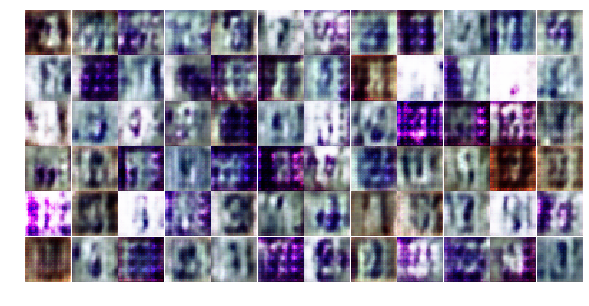

[9/25][210/573] Loss_D: 0.1745 Loss_G: 5.4123 D(x): 0.8954 D(G(z)): 0.0512 / 0.0080
[9/25][220/573] Loss_D: 1.0605 Loss_G: 2.6682 D(x): 0.9084 D(G(z)): 0.5046 / 0.1316
[9/25][230/573] Loss_D: 0.2423 Loss_G: 4.3875 D(x): 0.8404 D(G(z)): 0.0361 / 0.0274
[9/25][240/573] Loss_D: 0.2301 Loss_G: 3.6549 D(x): 0.9392 D(G(z)): 0.1286 / 0.0594
[9/25][250/573] Loss_D: 0.6859 Loss_G: 4.3454 D(x): 0.6365 D(G(z)): 0.0449 / 0.0335
[9/25][260/573] Loss_D: 0.3016 Loss_G: 5.3044 D(x): 0.8184 D(G(z)): 0.0553 / 0.0203
[9/25][270/573] Loss_D: 0.2749 Loss_G: 5.0444 D(x): 0.8329 D(G(z)): 0.0415 / 0.0262
[9/25][280/573] Loss_D: 0.2816 Loss_G: 3.8586 D(x): 0.8792 D(G(z)): 0.1023 / 0.0480
[9/25][290/573] Loss_D: 0.3938 Loss_G: 2.2328 D(x): 0.9420 D(G(z)): 0.2408 / 0.1784
[9/25][300/573] Loss_D: 0.5227 Loss_G: 3.5461 D(x): 0.7610 D(G(z)): 0.1361 / 0.0542


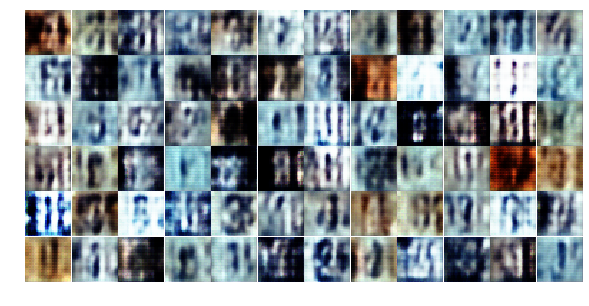

[9/25][310/573] Loss_D: 1.1901 Loss_G: 3.1531 D(x): 0.4137 D(G(z)): 0.0097 / 0.1057
[9/25][320/573] Loss_D: 0.2675 Loss_G: 2.8988 D(x): 0.8619 D(G(z)): 0.0662 / 0.1128
[9/25][330/573] Loss_D: 1.1259 Loss_G: 3.2008 D(x): 0.4672 D(G(z)): 0.0332 / 0.0852
[9/25][340/573] Loss_D: 0.6189 Loss_G: 3.0020 D(x): 0.9402 D(G(z)): 0.3528 / 0.0854
[9/25][350/573] Loss_D: 0.3641 Loss_G: 3.3542 D(x): 0.8440 D(G(z)): 0.1365 / 0.0644
[9/25][360/573] Loss_D: 1.0261 Loss_G: 2.8430 D(x): 0.4688 D(G(z)): 0.0554 / 0.0919
[9/25][370/573] Loss_D: 0.9611 Loss_G: 3.5196 D(x): 0.5514 D(G(z)): 0.0503 / 0.0795
[9/25][380/573] Loss_D: 0.1835 Loss_G: 2.7501 D(x): 0.9965 D(G(z)): 0.1459 / 0.1066
[9/25][390/573] Loss_D: 0.3232 Loss_G: 2.5413 D(x): 0.9964 D(G(z)): 0.2437 / 0.1237
[9/25][400/573] Loss_D: 0.9693 Loss_G: 3.3274 D(x): 0.6234 D(G(z)): 0.2282 / 0.0735


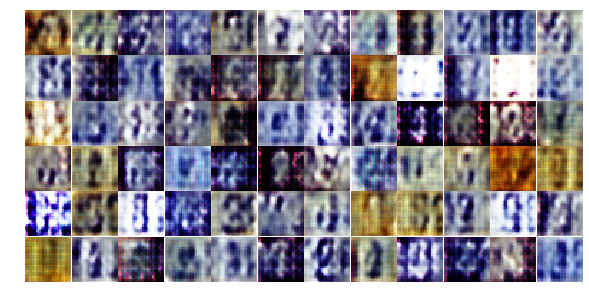

[9/25][410/573] Loss_D: 1.1038 Loss_G: 3.0715 D(x): 0.9105 D(G(z)): 0.5278 / 0.0941
[9/25][420/573] Loss_D: 0.2483 Loss_G: 4.5439 D(x): 0.9186 D(G(z)): 0.0982 / 0.0450
[9/25][430/573] Loss_D: 0.1767 Loss_G: 4.1288 D(x): 0.9159 D(G(z)): 0.0647 / 0.0471
[9/25][440/573] Loss_D: 0.3088 Loss_G: 3.1189 D(x): 0.8716 D(G(z)): 0.1324 / 0.0894
[9/25][450/573] Loss_D: 0.3272 Loss_G: 3.8239 D(x): 0.8029 D(G(z)): 0.0555 / 0.0551
[9/25][460/573] Loss_D: 0.1820 Loss_G: 3.4695 D(x): 0.8944 D(G(z)): 0.0548 / 0.0571
[9/25][470/573] Loss_D: 0.2716 Loss_G: 2.8431 D(x): 0.8893 D(G(z)): 0.1149 / 0.0985
[9/25][480/573] Loss_D: 0.3238 Loss_G: 2.7776 D(x): 0.8907 D(G(z)): 0.1529 / 0.0929
[9/25][490/573] Loss_D: 0.3497 Loss_G: 3.8366 D(x): 0.7658 D(G(z)): 0.0328 / 0.0368
[9/25][500/573] Loss_D: 0.1256 Loss_G: 4.8554 D(x): 0.9175 D(G(z)): 0.0265 / 0.0145


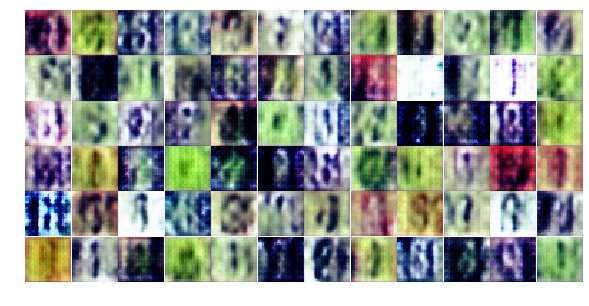

[9/25][510/573] Loss_D: 0.0987 Loss_G: 4.1115 D(x): 0.9600 D(G(z)): 0.0488 / 0.0259
[9/25][520/573] Loss_D: 0.4108 Loss_G: 2.9970 D(x): 0.8304 D(G(z)): 0.1290 / 0.0783
[9/25][530/573] Loss_D: 0.4820 Loss_G: 2.0661 D(x): 0.8485 D(G(z)): 0.2037 / 0.1837
[9/25][540/573] Loss_D: 0.6510 Loss_G: 3.5081 D(x): 0.7018 D(G(z)): 0.1607 / 0.0639
[9/25][550/573] Loss_D: 0.4180 Loss_G: 3.0955 D(x): 0.8583 D(G(z)): 0.1801 / 0.0844
[9/25][560/573] Loss_D: 0.3163 Loss_G: 2.5543 D(x): 0.9264 D(G(z)): 0.1866 / 0.1311
[9/25][570/573] Loss_D: 0.4246 Loss_G: 3.0328 D(x): 0.9119 D(G(z)): 0.2361 / 0.0900
[10/25][0/573] Loss_D: 0.7644 Loss_G: 3.2865 D(x): 0.6209 D(G(z)): 0.0803 / 0.0656


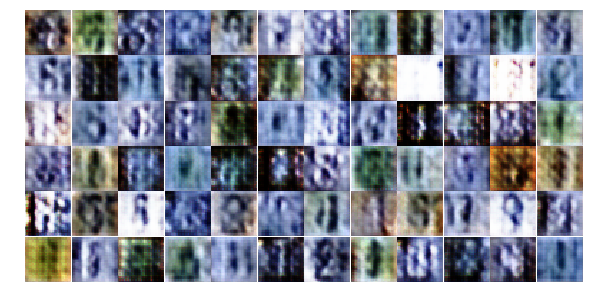

[10/25][10/573] Loss_D: 1.8424 Loss_G: 0.8609 D(x): 0.8233 D(G(z)): 0.7104 / 0.4970
[10/25][20/573] Loss_D: 1.0587 Loss_G: 3.1408 D(x): 0.4947 D(G(z)): 0.0675 / 0.1076
[10/25][30/573] Loss_D: 0.4858 Loss_G: 2.9874 D(x): 0.8259 D(G(z)): 0.1393 / 0.0843
[10/25][40/573] Loss_D: 0.3023 Loss_G: 2.4882 D(x): 0.9404 D(G(z)): 0.1899 / 0.1288
[10/25][50/573] Loss_D: 0.2976 Loss_G: 3.2293 D(x): 0.8376 D(G(z)): 0.0764 / 0.0600
[10/25][60/573] Loss_D: 0.2870 Loss_G: 2.0188 D(x): 0.8899 D(G(z)): 0.1347 / 0.1833
[10/25][70/573] Loss_D: 0.3960 Loss_G: 3.1108 D(x): 0.8038 D(G(z)): 0.1070 / 0.0696
[10/25][80/573] Loss_D: 1.2862 Loss_G: 1.6581 D(x): 0.8867 D(G(z)): 0.5930 / 0.2691
[10/25][90/573] Loss_D: 0.4624 Loss_G: 4.4320 D(x): 0.7211 D(G(z)): 0.0296 / 0.0277
[10/25][100/573] Loss_D: 0.2303 Loss_G: 4.8620 D(x): 0.8504 D(G(z)): 0.0275 / 0.0170


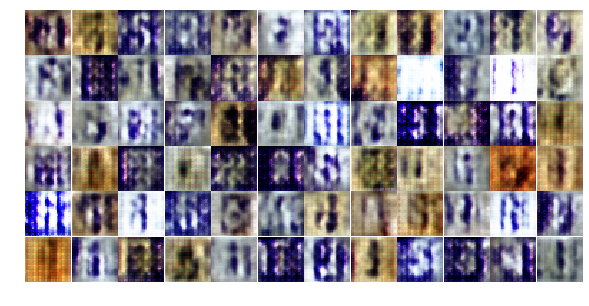

[10/25][110/573] Loss_D: 0.5932 Loss_G: 2.9741 D(x): 0.7075 D(G(z)): 0.1187 / 0.1144
[10/25][120/573] Loss_D: 0.2365 Loss_G: 3.0555 D(x): 0.9123 D(G(z)): 0.1067 / 0.0872
[10/25][130/573] Loss_D: 0.4024 Loss_G: 3.2397 D(x): 0.8902 D(G(z)): 0.2038 / 0.0752
[10/25][140/573] Loss_D: 1.0249 Loss_G: 1.9666 D(x): 0.9066 D(G(z)): 0.5032 / 0.2203
[10/25][150/573] Loss_D: 0.3753 Loss_G: 3.4827 D(x): 0.8029 D(G(z)): 0.0776 / 0.0554
[10/25][160/573] Loss_D: 0.2576 Loss_G: 2.3778 D(x): 0.9624 D(G(z)): 0.1776 / 0.1404
[10/25][170/573] Loss_D: 0.3224 Loss_G: 2.4057 D(x): 0.9616 D(G(z)): 0.2092 / 0.1451
[10/25][180/573] Loss_D: 0.0700 Loss_G: 4.2414 D(x): 0.9570 D(G(z)): 0.0241 / 0.0235
[10/25][190/573] Loss_D: 0.1220 Loss_G: 4.1957 D(x): 0.9111 D(G(z)): 0.0208 / 0.0253
[10/25][200/573] Loss_D: 0.7342 Loss_G: 1.6692 D(x): 0.9003 D(G(z)): 0.3980 / 0.2573


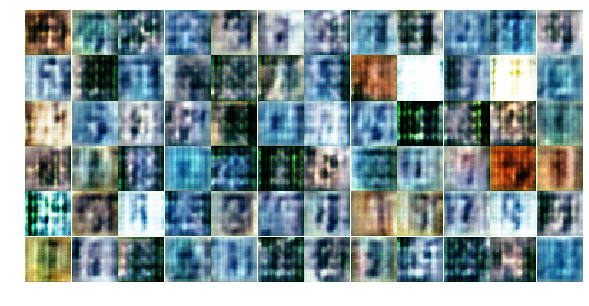

[10/25][210/573] Loss_D: 0.5696 Loss_G: 2.9243 D(x): 0.7371 D(G(z)): 0.1619 / 0.0886
[10/25][220/573] Loss_D: 0.8182 Loss_G: 2.3682 D(x): 0.6097 D(G(z)): 0.1553 / 0.1515
[10/25][230/573] Loss_D: 0.8190 Loss_G: 2.6420 D(x): 0.6339 D(G(z)): 0.1768 / 0.1027
[10/25][240/573] Loss_D: 0.2716 Loss_G: 3.0127 D(x): 0.9421 D(G(z)): 0.1736 / 0.0782
[10/25][250/573] Loss_D: 0.3417 Loss_G: 2.6067 D(x): 0.8572 D(G(z)): 0.1384 / 0.1104
[10/25][260/573] Loss_D: 0.7244 Loss_G: 2.3475 D(x): 0.8207 D(G(z)): 0.3472 / 0.1563
[10/25][270/573] Loss_D: 0.3686 Loss_G: 2.4606 D(x): 0.8802 D(G(z)): 0.1796 / 0.1665
[10/25][280/573] Loss_D: 0.3328 Loss_G: 2.7440 D(x): 0.9333 D(G(z)): 0.2038 / 0.1026
[10/25][290/573] Loss_D: 1.0247 Loss_G: 2.8884 D(x): 0.5406 D(G(z)): 0.1229 / 0.0955
[10/25][300/573] Loss_D: 0.5823 Loss_G: 1.8926 D(x): 0.8657 D(G(z)): 0.2901 / 0.2344


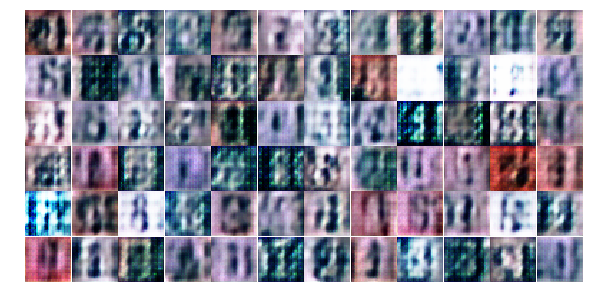

[10/25][310/573] Loss_D: 0.5609 Loss_G: 3.1829 D(x): 0.7393 D(G(z)): 0.1514 / 0.0767
[10/25][320/573] Loss_D: 0.9665 Loss_G: 1.3828 D(x): 0.6706 D(G(z)): 0.3359 / 0.2966
[10/25][330/573] Loss_D: 0.3692 Loss_G: 3.0771 D(x): 0.8743 D(G(z)): 0.1849 / 0.0722
[10/25][340/573] Loss_D: 0.4512 Loss_G: 2.2088 D(x): 0.8588 D(G(z)): 0.2171 / 0.1563
[10/25][350/573] Loss_D: 0.5345 Loss_G: 2.5006 D(x): 0.7953 D(G(z)): 0.1962 / 0.1179
[10/25][360/573] Loss_D: 0.3287 Loss_G: 3.0322 D(x): 0.9186 D(G(z)): 0.1685 / 0.0796
[10/25][370/573] Loss_D: 0.3702 Loss_G: 3.7246 D(x): 0.9593 D(G(z)): 0.2553 / 0.0363
[10/25][380/573] Loss_D: 0.3181 Loss_G: 3.1970 D(x): 0.8051 D(G(z)): 0.0570 / 0.0798
[10/25][390/573] Loss_D: 0.2994 Loss_G: 3.3470 D(x): 0.9440 D(G(z)): 0.1777 / 0.0785
[10/25][400/573] Loss_D: 0.4898 Loss_G: 2.1149 D(x): 0.9158 D(G(z)): 0.2509 / 0.2127


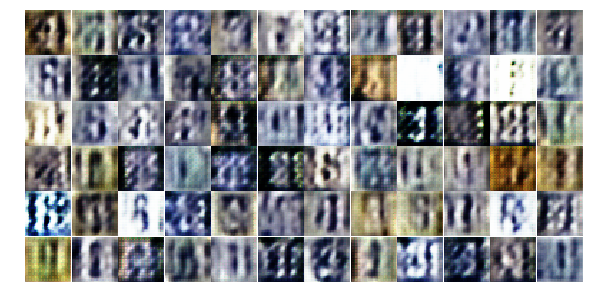

[10/25][410/573] Loss_D: 0.5387 Loss_G: 1.5804 D(x): 0.9587 D(G(z)): 0.3339 / 0.3151
[10/25][420/573] Loss_D: 0.7231 Loss_G: 2.2301 D(x): 0.7179 D(G(z)): 0.2424 / 0.1698
[10/25][430/573] Loss_D: 0.2218 Loss_G: 4.3038 D(x): 0.8597 D(G(z)): 0.0415 / 0.0257
[10/25][440/573] Loss_D: 0.2805 Loss_G: 3.1988 D(x): 0.8587 D(G(z)): 0.0884 / 0.0710
[10/25][450/573] Loss_D: 0.3015 Loss_G: 3.2100 D(x): 0.9291 D(G(z)): 0.1769 / 0.0664
[10/25][460/573] Loss_D: 1.9651 Loss_G: 2.0833 D(x): 0.9267 D(G(z)): 0.7995 / 0.1750
[10/25][470/573] Loss_D: 0.3655 Loss_G: 2.4338 D(x): 0.7909 D(G(z)): 0.0569 / 0.1552
[10/25][480/573] Loss_D: 0.2352 Loss_G: 3.8718 D(x): 0.9131 D(G(z)): 0.1126 / 0.0353
[10/25][490/573] Loss_D: 0.4451 Loss_G: 3.4332 D(x): 0.7938 D(G(z)): 0.1344 / 0.0575
[10/25][500/573] Loss_D: 0.6009 Loss_G: 2.4539 D(x): 0.7453 D(G(z)): 0.1831 / 0.1277


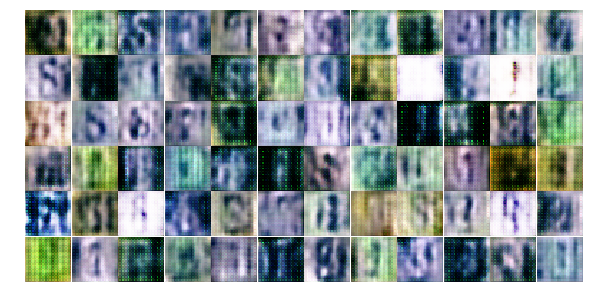

[10/25][510/573] Loss_D: 0.7931 Loss_G: 2.5087 D(x): 0.6479 D(G(z)): 0.1561 / 0.1135
[10/25][520/573] Loss_D: 0.2543 Loss_G: 2.3447 D(x): 0.8771 D(G(z)): 0.1003 / 0.1375
[10/25][530/573] Loss_D: 0.2111 Loss_G: 2.6249 D(x): 0.9390 D(G(z)): 0.1182 / 0.1253
[10/25][540/573] Loss_D: 0.1163 Loss_G: 3.4864 D(x): 0.9404 D(G(z)): 0.0463 / 0.0476
[10/25][550/573] Loss_D: 0.2345 Loss_G: 2.8904 D(x): 0.9375 D(G(z)): 0.1155 / 0.1263
[10/25][560/573] Loss_D: 1.1966 Loss_G: 1.8695 D(x): 0.7248 D(G(z)): 0.4861 / 0.2202
[10/25][570/573] Loss_D: 0.7719 Loss_G: 1.4531 D(x): 0.8195 D(G(z)): 0.3622 / 0.2972
[11/25][0/573] Loss_D: 0.9016 Loss_G: 2.3732 D(x): 0.7204 D(G(z)): 0.3419 / 0.1459


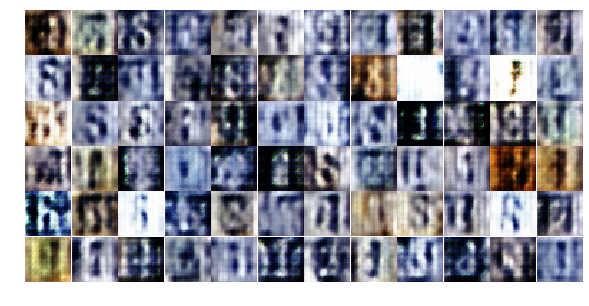

[11/25][10/573] Loss_D: 0.6949 Loss_G: 1.8398 D(x): 0.9331 D(G(z)): 0.3975 / 0.2692
[11/25][20/573] Loss_D: 0.6278 Loss_G: 2.2875 D(x): 0.8094 D(G(z)): 0.2250 / 0.2301
[11/25][30/573] Loss_D: 0.5068 Loss_G: 2.7147 D(x): 0.8642 D(G(z)): 0.2428 / 0.1183
[11/25][40/573] Loss_D: 0.9788 Loss_G: 2.1758 D(x): 0.5925 D(G(z)): 0.2031 / 0.1847
[11/25][50/573] Loss_D: 1.0040 Loss_G: 1.9791 D(x): 0.7367 D(G(z)): 0.3798 / 0.2096
[11/25][60/573] Loss_D: 0.6224 Loss_G: 3.2484 D(x): 0.6413 D(G(z)): 0.0758 / 0.0696
[11/25][70/573] Loss_D: 0.2945 Loss_G: 2.8315 D(x): 0.8704 D(G(z)): 0.1257 / 0.0850
[11/25][80/573] Loss_D: 0.3544 Loss_G: 1.6438 D(x): 0.9548 D(G(z)): 0.2426 / 0.2525
[11/25][90/573] Loss_D: 0.4083 Loss_G: 2.1985 D(x): 0.9088 D(G(z)): 0.2435 / 0.1488
[11/25][100/573] Loss_D: 0.6975 Loss_G: 2.2119 D(x): 0.6720 D(G(z)): 0.1603 / 0.1475


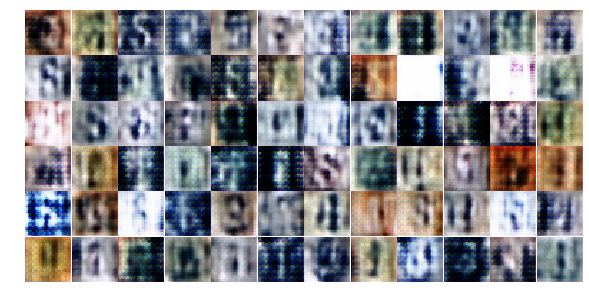

[11/25][110/573] Loss_D: 0.4442 Loss_G: 1.8944 D(x): 0.9324 D(G(z)): 0.2703 / 0.2053
[11/25][120/573] Loss_D: 0.2574 Loss_G: 2.6786 D(x): 0.9359 D(G(z)): 0.1592 / 0.1003
[11/25][130/573] Loss_D: 0.6126 Loss_G: 5.0152 D(x): 0.6212 D(G(z)): 0.0278 / 0.0107
[11/25][140/573] Loss_D: 0.5727 Loss_G: 1.3434 D(x): 0.9690 D(G(z)): 0.3612 / 0.3712
[11/25][150/573] Loss_D: 0.4028 Loss_G: 2.7037 D(x): 0.9720 D(G(z)): 0.2733 / 0.1135
[11/25][160/573] Loss_D: 0.3884 Loss_G: 2.9459 D(x): 0.9408 D(G(z)): 0.2428 / 0.0897
[11/25][170/573] Loss_D: 0.5801 Loss_G: 2.8548 D(x): 0.7119 D(G(z)): 0.1335 / 0.1057
[11/25][180/573] Loss_D: 0.3890 Loss_G: 2.0488 D(x): 0.9430 D(G(z)): 0.2350 / 0.2026
[11/25][190/573] Loss_D: 0.2756 Loss_G: 3.1154 D(x): 0.9787 D(G(z)): 0.2040 / 0.0766
[11/25][200/573] Loss_D: 0.4375 Loss_G: 2.9156 D(x): 0.9258 D(G(z)): 0.2459 / 0.1007


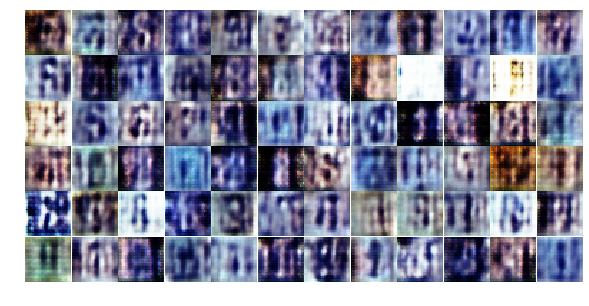

[11/25][210/573] Loss_D: 0.3549 Loss_G: 3.1784 D(x): 0.8432 D(G(z)): 0.1344 / 0.0853
[11/25][220/573] Loss_D: 0.4202 Loss_G: 4.2112 D(x): 0.7303 D(G(z)): 0.0431 / 0.0314
[11/25][230/573] Loss_D: 0.3659 Loss_G: 1.9741 D(x): 0.9640 D(G(z)): 0.2498 / 0.1933
[11/25][240/573] Loss_D: 0.9509 Loss_G: 1.6066 D(x): 0.5344 D(G(z)): 0.1106 / 0.2530
[11/25][250/573] Loss_D: 0.5234 Loss_G: 4.2144 D(x): 0.7486 D(G(z)): 0.1369 / 0.0300
[11/25][260/573] Loss_D: 0.7407 Loss_G: 2.3181 D(x): 0.6518 D(G(z)): 0.1592 / 0.1413
[11/25][270/573] Loss_D: 0.4784 Loss_G: 4.7247 D(x): 0.7291 D(G(z)): 0.0489 / 0.0174
[11/25][280/573] Loss_D: 0.3064 Loss_G: 3.7448 D(x): 0.8301 D(G(z)): 0.0651 / 0.0480
[11/25][290/573] Loss_D: 0.2659 Loss_G: 3.0838 D(x): 0.8833 D(G(z)): 0.1023 / 0.0798
[11/25][300/573] Loss_D: 0.3689 Loss_G: 2.8479 D(x): 0.8310 D(G(z)): 0.1206 / 0.0996


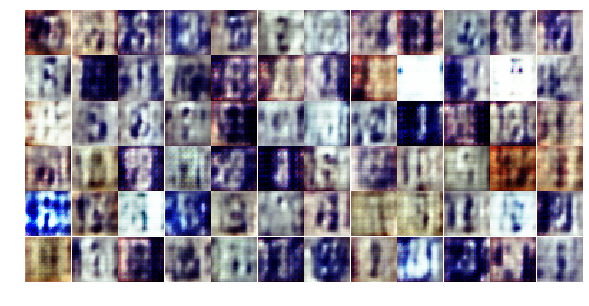

[11/25][310/573] Loss_D: 0.4300 Loss_G: 2.1699 D(x): 0.9519 D(G(z)): 0.2766 / 0.1708
[11/25][320/573] Loss_D: 0.3791 Loss_G: 2.4378 D(x): 0.8977 D(G(z)): 0.2060 / 0.1435
[11/25][330/573] Loss_D: 0.5947 Loss_G: 2.8267 D(x): 0.8071 D(G(z)): 0.2380 / 0.1103
[11/25][340/573] Loss_D: 0.1822 Loss_G: 4.6015 D(x): 0.9144 D(G(z)): 0.0684 / 0.0310
[11/25][350/573] Loss_D: 0.0232 Loss_G: 5.2400 D(x): 0.9959 D(G(z)): 0.0181 / 0.0140
[11/25][360/573] Loss_D: 0.1020 Loss_G: 3.9074 D(x): 0.9890 D(G(z)): 0.0777 / 0.0432
[11/25][370/573] Loss_D: 0.3405 Loss_G: 3.3872 D(x): 0.8221 D(G(z)): 0.0847 / 0.0713
[11/25][380/573] Loss_D: 0.3005 Loss_G: 2.4268 D(x): 0.9165 D(G(z)): 0.1600 / 0.1469
[11/25][390/573] Loss_D: 0.3850 Loss_G: 2.1672 D(x): 0.9685 D(G(z)): 0.2565 / 0.1848
[11/25][400/573] Loss_D: 0.7195 Loss_G: 2.3521 D(x): 0.8355 D(G(z)): 0.3557 / 0.1464


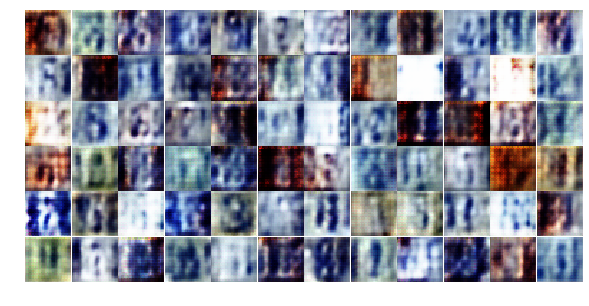

[11/25][410/573] Loss_D: 1.1325 Loss_G: 1.4708 D(x): 0.7058 D(G(z)): 0.3816 / 0.3477
[11/25][420/573] Loss_D: 0.6209 Loss_G: 2.1243 D(x): 0.7522 D(G(z)): 0.2232 / 0.1631
[11/25][430/573] Loss_D: 0.2805 Loss_G: 3.4279 D(x): 0.8408 D(G(z)): 0.0823 / 0.0456
[11/25][440/573] Loss_D: 0.3971 Loss_G: 3.4376 D(x): 0.7786 D(G(z)): 0.0892 / 0.0582
[11/25][450/573] Loss_D: 0.2706 Loss_G: 1.8760 D(x): 0.9381 D(G(z)): 0.1686 / 0.2220
[11/25][460/573] Loss_D: 0.8450 Loss_G: 2.6628 D(x): 0.6228 D(G(z)): 0.2027 / 0.1098
[11/25][470/573] Loss_D: 0.4294 Loss_G: 1.9280 D(x): 0.8673 D(G(z)): 0.2111 / 0.2258
[11/25][480/573] Loss_D: 0.5071 Loss_G: 1.8649 D(x): 0.8935 D(G(z)): 0.2629 / 0.2564
[11/25][490/573] Loss_D: 1.2217 Loss_G: 1.8644 D(x): 0.6442 D(G(z)): 0.3311 / 0.2365
[11/25][500/573] Loss_D: 0.9400 Loss_G: 1.4779 D(x): 0.6391 D(G(z)): 0.2480 / 0.4038


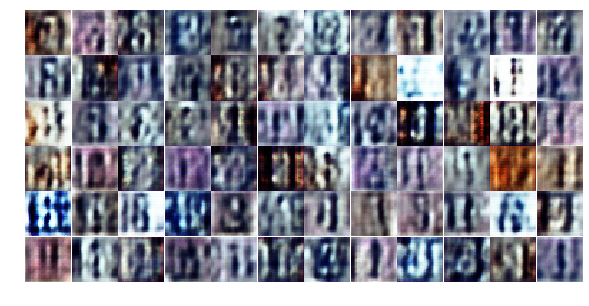

[11/25][510/573] Loss_D: 0.1541 Loss_G: 5.7685 D(x): 0.9142 D(G(z)): 0.0491 / 0.0074
[11/25][520/573] Loss_D: 1.1469 Loss_G: 4.7851 D(x): 0.4211 D(G(z)): 0.0062 / 0.0178
[11/25][530/573] Loss_D: 0.5644 Loss_G: 1.8316 D(x): 0.8753 D(G(z)): 0.2956 / 0.2442
[11/25][540/573] Loss_D: 0.8586 Loss_G: 2.2563 D(x): 0.6133 D(G(z)): 0.1960 / 0.1455
[11/25][550/573] Loss_D: 0.3222 Loss_G: 2.7452 D(x): 0.9083 D(G(z)): 0.1816 / 0.0908
[11/25][560/573] Loss_D: 0.8610 Loss_G: 2.5456 D(x): 0.5629 D(G(z)): 0.1058 / 0.1115
[11/25][570/573] Loss_D: 0.4844 Loss_G: 2.6560 D(x): 0.7847 D(G(z)): 0.1359 / 0.0988
[12/25][0/573] Loss_D: 1.1189 Loss_G: 0.8828 D(x): 0.8002 D(G(z)): 0.5049 / 0.4717


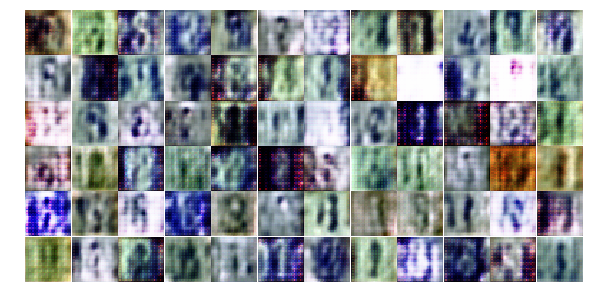

[12/25][10/573] Loss_D: 1.5075 Loss_G: 1.6000 D(x): 0.6028 D(G(z)): 0.5152 / 0.2918
[12/25][20/573] Loss_D: 1.2477 Loss_G: 3.7879 D(x): 0.4091 D(G(z)): 0.0237 / 0.0416
[12/25][30/573] Loss_D: 0.4288 Loss_G: 2.4507 D(x): 0.7987 D(G(z)): 0.1062 / 0.1563
[12/25][40/573] Loss_D: 0.3936 Loss_G: 2.4419 D(x): 0.8438 D(G(z)): 0.1550 / 0.1263
[12/25][50/573] Loss_D: 0.6435 Loss_G: 1.3110 D(x): 0.9405 D(G(z)): 0.3788 / 0.3372
[12/25][60/573] Loss_D: 0.4372 Loss_G: 1.8911 D(x): 0.9720 D(G(z)): 0.2923 / 0.2129
[12/25][70/573] Loss_D: 0.3098 Loss_G: 3.2056 D(x): 0.8743 D(G(z)): 0.1318 / 0.0720
[12/25][80/573] Loss_D: 0.3263 Loss_G: 2.2618 D(x): 0.9508 D(G(z)): 0.2083 / 0.1467
[12/25][90/573] Loss_D: 0.4744 Loss_G: 3.1272 D(x): 0.7625 D(G(z)): 0.1488 / 0.0717
[12/25][100/573] Loss_D: 0.2335 Loss_G: 3.3927 D(x): 0.8653 D(G(z)): 0.0520 / 0.0495


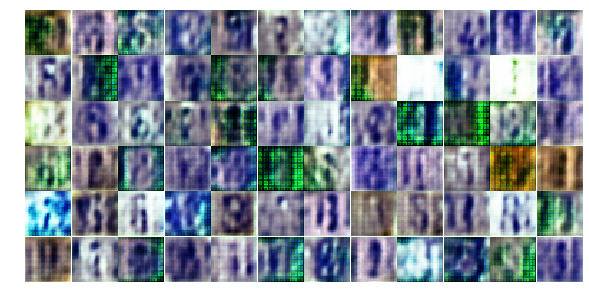

[12/25][110/573] Loss_D: 0.4294 Loss_G: 2.3732 D(x): 0.9253 D(G(z)): 0.2607 / 0.1348
[12/25][120/573] Loss_D: 0.3578 Loss_G: 3.8954 D(x): 0.7942 D(G(z)): 0.0858 / 0.0363
[12/25][130/573] Loss_D: 0.6048 Loss_G: 2.4992 D(x): 0.8011 D(G(z)): 0.2703 / 0.1138
[12/25][140/573] Loss_D: 0.2693 Loss_G: 4.0494 D(x): 0.8574 D(G(z)): 0.0712 / 0.0441
[12/25][150/573] Loss_D: 0.3152 Loss_G: 5.2786 D(x): 0.7881 D(G(z)): 0.0173 / 0.0126
[12/25][160/573] Loss_D: 0.5238 Loss_G: 2.7651 D(x): 0.7917 D(G(z)): 0.2068 / 0.0927
[12/25][170/573] Loss_D: 1.6743 Loss_G: 3.0232 D(x): 0.3989 D(G(z)): 0.1252 / 0.0788
[12/25][180/573] Loss_D: 0.4987 Loss_G: 4.1008 D(x): 0.7091 D(G(z)): 0.0563 / 0.0374
[12/25][190/573] Loss_D: 0.3369 Loss_G: 3.7869 D(x): 0.7961 D(G(z)): 0.0684 / 0.0382
[12/25][200/573] Loss_D: 0.6095 Loss_G: 2.8087 D(x): 0.7415 D(G(z)): 0.1940 / 0.0976


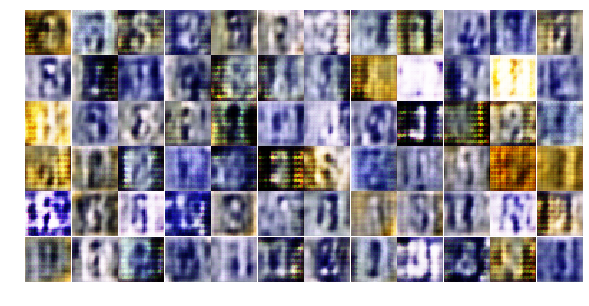

[12/25][210/573] Loss_D: 0.2497 Loss_G: 3.7116 D(x): 0.8925 D(G(z)): 0.1088 / 0.0430
[12/25][220/573] Loss_D: 0.2774 Loss_G: 3.4590 D(x): 0.9331 D(G(z)): 0.1605 / 0.0593
[12/25][230/573] Loss_D: 0.4809 Loss_G: 3.0371 D(x): 0.8151 D(G(z)): 0.1972 / 0.0712
[12/25][240/573] Loss_D: 0.2848 Loss_G: 2.5569 D(x): 0.8681 D(G(z)): 0.1145 / 0.1083
[12/25][250/573] Loss_D: 0.8827 Loss_G: 1.8800 D(x): 0.6761 D(G(z)): 0.3249 / 0.2024
[12/25][260/573] Loss_D: 1.1220 Loss_G: 1.8551 D(x): 0.4967 D(G(z)): 0.2076 / 0.2128
[12/25][270/573] Loss_D: 0.8020 Loss_G: 2.7427 D(x): 0.6018 D(G(z)): 0.1438 / 0.0897
[12/25][280/573] Loss_D: 0.4691 Loss_G: 2.5150 D(x): 0.7541 D(G(z)): 0.1271 / 0.1274
[12/25][290/573] Loss_D: 0.3463 Loss_G: 2.1085 D(x): 0.9141 D(G(z)): 0.1972 / 0.1727
[12/25][300/573] Loss_D: 0.2470 Loss_G: 2.7972 D(x): 0.8824 D(G(z)): 0.0939 / 0.0947


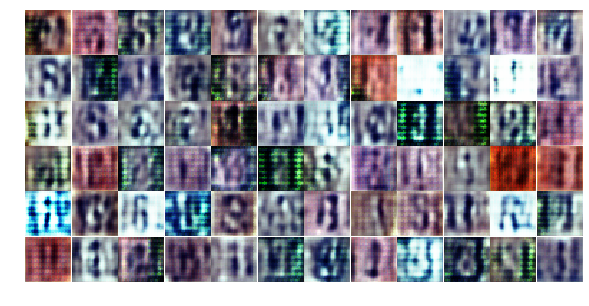

[12/25][310/573] Loss_D: 0.9205 Loss_G: 1.5665 D(x): 0.6875 D(G(z)): 0.3385 / 0.2773
[12/25][320/573] Loss_D: 0.5135 Loss_G: 2.6597 D(x): 0.7914 D(G(z)): 0.2012 / 0.1036
[12/25][330/573] Loss_D: 0.4555 Loss_G: 2.6778 D(x): 0.8184 D(G(z)): 0.1824 / 0.1088
[12/25][340/573] Loss_D: 0.5840 Loss_G: 2.2956 D(x): 0.6731 D(G(z)): 0.0987 / 0.1366
[12/25][350/573] Loss_D: 0.2991 Loss_G: 2.5118 D(x): 0.9110 D(G(z)): 0.1604 / 0.1240
[12/25][360/573] Loss_D: 0.4593 Loss_G: 2.3653 D(x): 0.9323 D(G(z)): 0.2919 / 0.1366
[12/25][370/573] Loss_D: 0.5085 Loss_G: 2.8278 D(x): 0.8152 D(G(z)): 0.2233 / 0.0897
[12/25][380/573] Loss_D: 0.2117 Loss_G: 2.7587 D(x): 0.9079 D(G(z)): 0.0970 / 0.0833
[12/25][390/573] Loss_D: 1.0443 Loss_G: 1.6529 D(x): 0.9604 D(G(z)): 0.5750 / 0.2473
[12/25][400/573] Loss_D: 0.5007 Loss_G: 2.4762 D(x): 0.7721 D(G(z)): 0.1635 / 0.1345


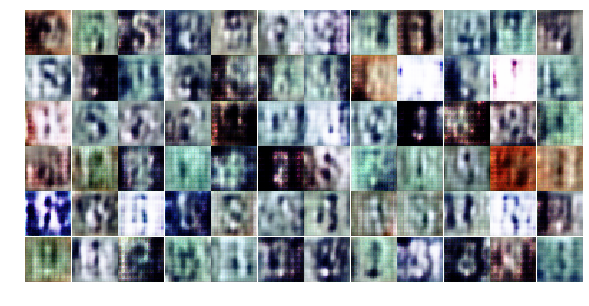

[12/25][410/573] Loss_D: 0.7993 Loss_G: 0.7707 D(x): 0.7941 D(G(z)): 0.3649 / 0.5132
[12/25][420/573] Loss_D: 0.6298 Loss_G: 2.1475 D(x): 0.8927 D(G(z)): 0.3485 / 0.1691
[12/25][430/573] Loss_D: 0.7396 Loss_G: 2.1687 D(x): 0.7219 D(G(z)): 0.2363 / 0.1716
[12/25][440/573] Loss_D: 0.3777 Loss_G: 2.5999 D(x): 0.8871 D(G(z)): 0.1935 / 0.1055
[12/25][450/573] Loss_D: 0.2853 Loss_G: 3.2273 D(x): 0.8686 D(G(z)): 0.1089 / 0.0829
[12/25][460/573] Loss_D: 0.2589 Loss_G: 2.4932 D(x): 0.9439 D(G(z)): 0.1641 / 0.1403
[12/25][470/573] Loss_D: 0.4347 Loss_G: 2.3082 D(x): 0.8563 D(G(z)): 0.2029 / 0.1737
[12/25][480/573] Loss_D: 0.3128 Loss_G: 3.7161 D(x): 0.8327 D(G(z)): 0.0759 / 0.0480
[12/25][490/573] Loss_D: 0.1500 Loss_G: 4.0950 D(x): 0.9194 D(G(z)): 0.0542 / 0.0325
[12/25][500/573] Loss_D: 0.1883 Loss_G: 4.2784 D(x): 0.8803 D(G(z)): 0.0437 / 0.0229


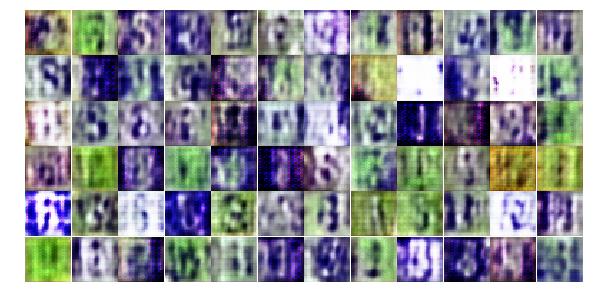

[12/25][510/573] Loss_D: 0.4493 Loss_G: 2.6942 D(x): 0.7956 D(G(z)): 0.1541 / 0.0964
[12/25][520/573] Loss_D: 0.6707 Loss_G: 2.3743 D(x): 0.6633 D(G(z)): 0.1479 / 0.1383
[12/25][530/573] Loss_D: 0.5828 Loss_G: 2.3362 D(x): 0.8118 D(G(z)): 0.2545 / 0.1408
[12/25][540/573] Loss_D: 0.3703 Loss_G: 3.4901 D(x): 0.8895 D(G(z)): 0.1898 / 0.0550
[12/25][550/573] Loss_D: 0.7181 Loss_G: 1.8103 D(x): 0.8461 D(G(z)): 0.3491 / 0.2370
[12/25][560/573] Loss_D: 0.3947 Loss_G: 3.8643 D(x): 0.7744 D(G(z)): 0.0822 / 0.0398
[12/25][570/573] Loss_D: 0.5340 Loss_G: 3.6694 D(x): 0.6858 D(G(z)): 0.0372 / 0.0501
[13/25][0/573] Loss_D: 0.3405 Loss_G: 2.4367 D(x): 0.8958 D(G(z)): 0.1714 / 0.1416


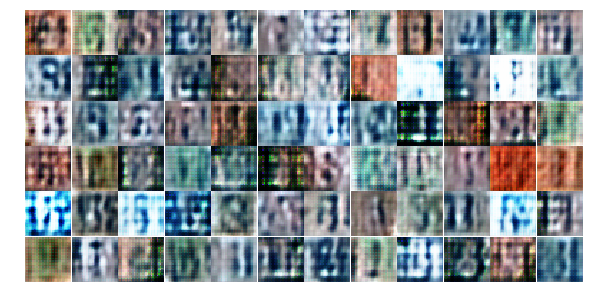

[13/25][10/573] Loss_D: 0.4029 Loss_G: 2.4026 D(x): 0.9207 D(G(z)): 0.2374 / 0.1475
[13/25][20/573] Loss_D: 0.2970 Loss_G: 3.8333 D(x): 0.8528 D(G(z)): 0.1050 / 0.0421
[13/25][30/573] Loss_D: 0.4888 Loss_G: 3.3477 D(x): 0.7433 D(G(z)): 0.1142 / 0.0598
[13/25][40/573] Loss_D: 0.4628 Loss_G: 2.6231 D(x): 0.7413 D(G(z)): 0.1015 / 0.1212
[13/25][50/573] Loss_D: 1.0149 Loss_G: 1.5797 D(x): 0.8002 D(G(z)): 0.4692 / 0.2702
[13/25][60/573] Loss_D: 0.6134 Loss_G: 2.5852 D(x): 0.6717 D(G(z)): 0.1155 / 0.1156
[13/25][70/573] Loss_D: 0.3887 Loss_G: 2.3458 D(x): 0.9358 D(G(z)): 0.2535 / 0.1355
[13/25][80/573] Loss_D: 0.8769 Loss_G: 3.8641 D(x): 0.5252 D(G(z)): 0.0383 / 0.0433
[13/25][90/573] Loss_D: 0.5959 Loss_G: 1.7038 D(x): 0.8288 D(G(z)): 0.2786 / 0.2634
[13/25][100/573] Loss_D: 0.7116 Loss_G: 2.6405 D(x): 0.6962 D(G(z)): 0.2331 / 0.1310


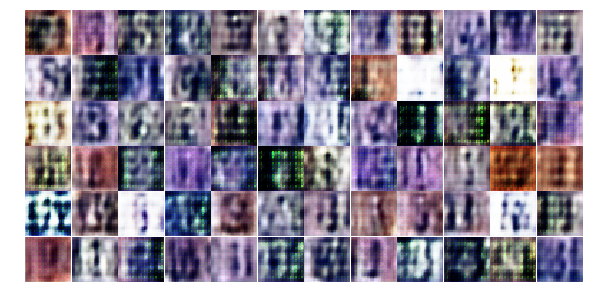

[13/25][110/573] Loss_D: 0.3652 Loss_G: 2.6472 D(x): 0.8039 D(G(z)): 0.1034 / 0.1115
[13/25][120/573] Loss_D: 0.2312 Loss_G: 2.8550 D(x): 0.9196 D(G(z)): 0.1191 / 0.0909
[13/25][130/573] Loss_D: 0.3455 Loss_G: 2.9549 D(x): 0.8610 D(G(z)): 0.1488 / 0.0832
[13/25][140/573] Loss_D: 0.2730 Loss_G: 3.0562 D(x): 0.8399 D(G(z)): 0.0727 / 0.0659
[13/25][150/573] Loss_D: 0.3559 Loss_G: 2.1349 D(x): 0.9314 D(G(z)): 0.2269 / 0.1527
[13/25][160/573] Loss_D: 0.3899 Loss_G: 2.5225 D(x): 0.7916 D(G(z)): 0.1145 / 0.1073
[13/25][170/573] Loss_D: 0.5958 Loss_G: 2.6255 D(x): 0.8215 D(G(z)): 0.2829 / 0.1049
[13/25][180/573] Loss_D: 1.3564 Loss_G: 1.6611 D(x): 0.7465 D(G(z)): 0.5423 / 0.2646
[13/25][190/573] Loss_D: 0.4666 Loss_G: 2.5642 D(x): 0.7907 D(G(z)): 0.1685 / 0.1235
[13/25][200/573] Loss_D: 0.5651 Loss_G: 1.8121 D(x): 0.8784 D(G(z)): 0.2966 / 0.2220


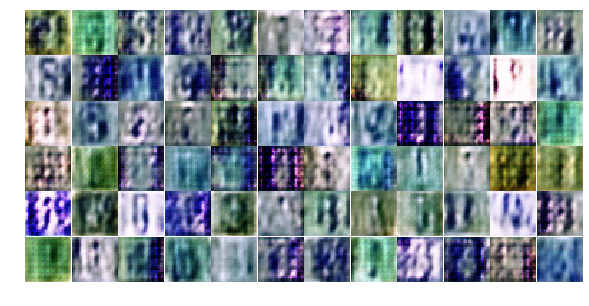

[13/25][210/573] Loss_D: 0.3878 Loss_G: 2.8828 D(x): 0.7947 D(G(z)): 0.1104 / 0.0764
[13/25][220/573] Loss_D: 0.5353 Loss_G: 2.0392 D(x): 0.8898 D(G(z)): 0.3093 / 0.1743
[13/25][230/573] Loss_D: 0.6067 Loss_G: 2.2391 D(x): 0.6937 D(G(z)): 0.1326 / 0.1442
[13/25][240/573] Loss_D: 0.4492 Loss_G: 2.8041 D(x): 0.8144 D(G(z)): 0.1871 / 0.0927
[13/25][250/573] Loss_D: 0.9946 Loss_G: 1.0750 D(x): 0.7604 D(G(z)): 0.4382 / 0.3979
[13/25][260/573] Loss_D: 0.5444 Loss_G: 2.1476 D(x): 0.9041 D(G(z)): 0.3176 / 0.1622
[13/25][270/573] Loss_D: 0.4850 Loss_G: 2.4327 D(x): 0.9513 D(G(z)): 0.3014 / 0.1415
[13/25][280/573] Loss_D: 0.2689 Loss_G: 2.9065 D(x): 0.8667 D(G(z)): 0.0934 / 0.0990
[13/25][290/573] Loss_D: 0.3539 Loss_G: 2.7563 D(x): 0.9040 D(G(z)): 0.1950 / 0.1072
[13/25][300/573] Loss_D: 0.4341 Loss_G: 2.4859 D(x): 0.8413 D(G(z)): 0.1848 / 0.1301


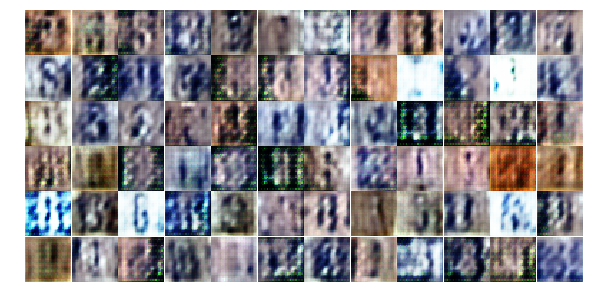

[13/25][310/573] Loss_D: 0.6255 Loss_G: 2.1871 D(x): 0.8666 D(G(z)): 0.3359 / 0.1658
[13/25][320/573] Loss_D: 1.2788 Loss_G: 1.4727 D(x): 0.6514 D(G(z)): 0.3922 / 0.3637
[13/25][330/573] Loss_D: 0.8168 Loss_G: 3.6357 D(x): 0.6312 D(G(z)): 0.1257 / 0.0836
[13/25][340/573] Loss_D: 0.7839 Loss_G: 1.6685 D(x): 0.8114 D(G(z)): 0.3510 / 0.2574
[13/25][350/573] Loss_D: 0.2114 Loss_G: 4.0423 D(x): 0.8737 D(G(z)): 0.0560 / 0.0393
[13/25][360/573] Loss_D: 0.3736 Loss_G: 2.8735 D(x): 0.8232 D(G(z)): 0.1251 / 0.0811
[13/25][370/573] Loss_D: 0.5363 Loss_G: 2.2986 D(x): 0.7753 D(G(z)): 0.1811 / 0.1250
[13/25][380/573] Loss_D: 0.4352 Loss_G: 2.4274 D(x): 0.8058 D(G(z)): 0.1551 / 0.1126
[13/25][390/573] Loss_D: 0.3275 Loss_G: 2.5994 D(x): 0.8594 D(G(z)): 0.1431 / 0.0972
[13/25][400/573] Loss_D: 0.4587 Loss_G: 2.0980 D(x): 0.7822 D(G(z)): 0.1564 / 0.1642


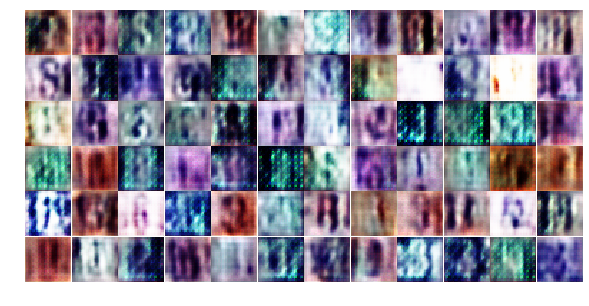

[13/25][410/573] Loss_D: 0.3205 Loss_G: 2.8322 D(x): 0.8579 D(G(z)): 0.1202 / 0.0907
[13/25][420/573] Loss_D: 0.4684 Loss_G: 1.9530 D(x): 0.9323 D(G(z)): 0.2924 / 0.1866
[13/25][430/573] Loss_D: 0.5557 Loss_G: 1.9218 D(x): 0.7907 D(G(z)): 0.2023 / 0.1919
[13/25][440/573] Loss_D: 0.5668 Loss_G: 1.6460 D(x): 0.8771 D(G(z)): 0.3151 / 0.2531
[13/25][450/573] Loss_D: 0.7041 Loss_G: 2.6450 D(x): 0.6830 D(G(z)): 0.1654 / 0.1042
[13/25][460/573] Loss_D: 0.6215 Loss_G: 2.2443 D(x): 0.7896 D(G(z)): 0.2660 / 0.1429
[13/25][470/573] Loss_D: 0.4212 Loss_G: 1.9901 D(x): 0.9272 D(G(z)): 0.2591 / 0.2046
[13/25][480/573] Loss_D: 0.5971 Loss_G: 2.5745 D(x): 0.7028 D(G(z)): 0.1251 / 0.1228
[13/25][490/573] Loss_D: 0.6169 Loss_G: 1.9698 D(x): 0.7941 D(G(z)): 0.2579 / 0.2015
[13/25][500/573] Loss_D: 0.4971 Loss_G: 2.4841 D(x): 0.8263 D(G(z)): 0.2167 / 0.1411


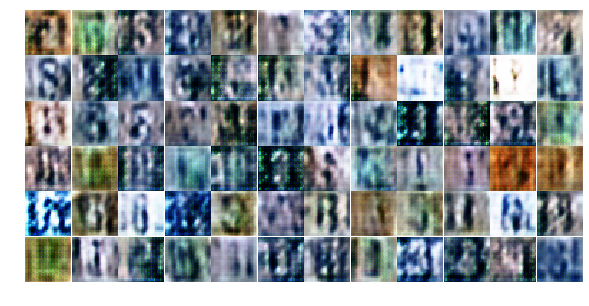

[13/25][510/573] Loss_D: 0.6902 Loss_G: 1.9757 D(x): 0.7420 D(G(z)): 0.2465 / 0.2173
[13/25][520/573] Loss_D: 0.5504 Loss_G: 2.2525 D(x): 0.8751 D(G(z)): 0.2936 / 0.1599
[13/25][530/573] Loss_D: 0.6745 Loss_G: 1.1751 D(x): 0.7444 D(G(z)): 0.2535 / 0.3847
[13/25][540/573] Loss_D: 0.9500 Loss_G: 1.9093 D(x): 0.6929 D(G(z)): 0.3137 / 0.2187
[13/25][550/573] Loss_D: 0.4642 Loss_G: 2.2830 D(x): 0.7927 D(G(z)): 0.1514 / 0.1517
[13/25][560/573] Loss_D: 0.5611 Loss_G: 1.9181 D(x): 0.9788 D(G(z)): 0.3747 / 0.1977
[13/25][570/573] Loss_D: 0.4208 Loss_G: 2.6996 D(x): 0.8689 D(G(z)): 0.2010 / 0.1134
[14/25][0/573] Loss_D: 0.4116 Loss_G: 3.2313 D(x): 0.7600 D(G(z)): 0.0619 / 0.0719


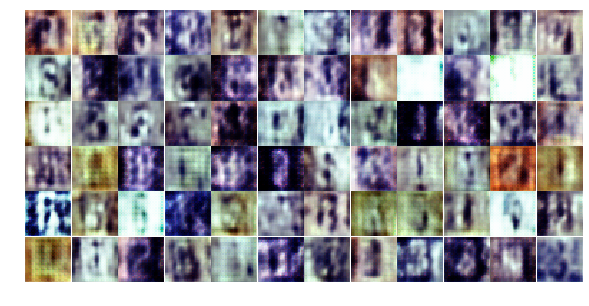

[14/25][10/573] Loss_D: 0.5967 Loss_G: 1.6432 D(x): 0.7508 D(G(z)): 0.2163 / 0.2955
[14/25][20/573] Loss_D: 0.6640 Loss_G: 2.7585 D(x): 0.6850 D(G(z)): 0.1728 / 0.0996
[14/25][30/573] Loss_D: 0.7295 Loss_G: 1.5604 D(x): 0.6787 D(G(z)): 0.2272 / 0.2791
[14/25][40/573] Loss_D: 0.8592 Loss_G: 2.6576 D(x): 0.6050 D(G(z)): 0.1873 / 0.1307
[14/25][50/573] Loss_D: 0.4949 Loss_G: 2.2736 D(x): 0.8230 D(G(z)): 0.2000 / 0.1873
[14/25][60/573] Loss_D: 0.5797 Loss_G: 1.8306 D(x): 0.8432 D(G(z)): 0.2635 / 0.2418
[14/25][70/573] Loss_D: 0.5198 Loss_G: 2.0799 D(x): 0.8412 D(G(z)): 0.2403 / 0.1891
[14/25][80/573] Loss_D: 0.7039 Loss_G: 1.7999 D(x): 0.7741 D(G(z)): 0.2821 / 0.2362
[14/25][90/573] Loss_D: 0.3877 Loss_G: 3.3103 D(x): 0.8393 D(G(z)): 0.1359 / 0.0651
[14/25][100/573] Loss_D: 0.6190 Loss_G: 1.6460 D(x): 0.8085 D(G(z)): 0.2913 / 0.2448


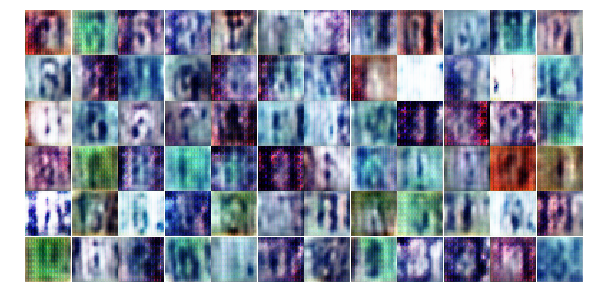

[14/25][110/573] Loss_D: 0.4781 Loss_G: 2.5899 D(x): 0.7991 D(G(z)): 0.1840 / 0.1080
[14/25][120/573] Loss_D: 0.6081 Loss_G: 2.3333 D(x): 0.6589 D(G(z)): 0.0893 / 0.1274
[14/25][130/573] Loss_D: 0.3857 Loss_G: 3.0888 D(x): 0.8653 D(G(z)): 0.1890 / 0.0637
[14/25][140/573] Loss_D: 0.5946 Loss_G: 2.6751 D(x): 0.7853 D(G(z)): 0.2284 / 0.1129
[14/25][150/573] Loss_D: 0.6049 Loss_G: 1.0993 D(x): 0.7990 D(G(z)): 0.2665 / 0.3948
[14/25][160/573] Loss_D: 0.4437 Loss_G: 3.2537 D(x): 0.7825 D(G(z)): 0.1432 / 0.0638
[14/25][170/573] Loss_D: 0.8056 Loss_G: 2.4295 D(x): 0.8419 D(G(z)): 0.4013 / 0.1408
[14/25][180/573] Loss_D: 0.5490 Loss_G: 2.5540 D(x): 0.8434 D(G(z)): 0.2658 / 0.1248
[14/25][190/573] Loss_D: 0.5687 Loss_G: 2.4133 D(x): 0.7480 D(G(z)): 0.1985 / 0.1340
[14/25][200/573] Loss_D: 0.4133 Loss_G: 2.4276 D(x): 0.9542 D(G(z)): 0.2717 / 0.1409


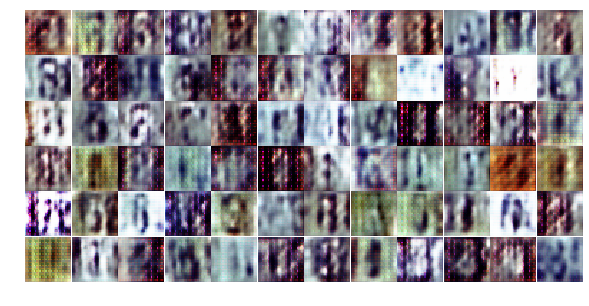

[14/25][210/573] Loss_D: 0.3930 Loss_G: 3.0979 D(x): 0.7993 D(G(z)): 0.1128 / 0.0700
[14/25][220/573] Loss_D: 0.3957 Loss_G: 2.3667 D(x): 0.9027 D(G(z)): 0.2236 / 0.1339
[14/25][230/573] Loss_D: 0.5454 Loss_G: 2.1623 D(x): 0.6907 D(G(z)): 0.0943 / 0.1640
[14/25][240/573] Loss_D: 0.4793 Loss_G: 2.6127 D(x): 0.7741 D(G(z)): 0.1552 / 0.0988
[14/25][250/573] Loss_D: 0.5784 Loss_G: 2.5128 D(x): 0.8523 D(G(z)): 0.3033 / 0.1146
[14/25][260/573] Loss_D: 0.4200 Loss_G: 2.8290 D(x): 0.7607 D(G(z)): 0.0865 / 0.0998
[14/25][270/573] Loss_D: 0.2583 Loss_G: 2.3221 D(x): 0.9108 D(G(z)): 0.1358 / 0.1442
[14/25][280/573] Loss_D: 0.9828 Loss_G: 1.5178 D(x): 0.8039 D(G(z)): 0.4512 / 0.2993
[14/25][290/573] Loss_D: 0.6492 Loss_G: 1.4082 D(x): 0.8387 D(G(z)): 0.3314 / 0.3022
[14/25][300/573] Loss_D: 0.4025 Loss_G: 2.2263 D(x): 0.7869 D(G(z)): 0.1119 / 0.1699


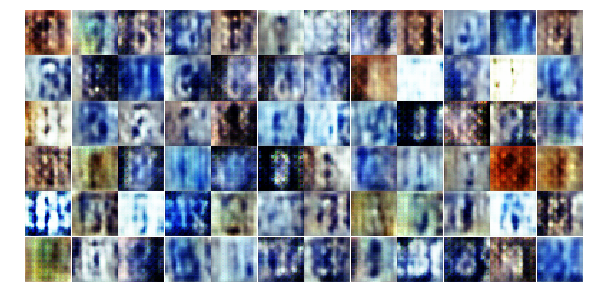

[14/25][310/573] Loss_D: 0.3232 Loss_G: 3.3913 D(x): 0.8613 D(G(z)): 0.1208 / 0.0604
[14/25][320/573] Loss_D: 0.6417 Loss_G: 2.1482 D(x): 0.7675 D(G(z)): 0.2347 / 0.1805
[14/25][330/573] Loss_D: 0.6579 Loss_G: 2.7963 D(x): 0.6595 D(G(z)): 0.0940 / 0.1412
[14/25][340/573] Loss_D: 0.0728 Loss_G: 4.9352 D(x): 0.9653 D(G(z)): 0.0334 / 0.0148
[14/25][350/573] Loss_D: 0.1406 Loss_G: 3.8162 D(x): 0.9469 D(G(z)): 0.0729 / 0.0488
[14/25][360/573] Loss_D: 0.0813 Loss_G: 4.0291 D(x): 0.9707 D(G(z)): 0.0453 / 0.0338
[14/25][370/573] Loss_D: 0.5969 Loss_G: 3.0753 D(x): 0.6413 D(G(z)): 0.0388 / 0.0631
[14/25][380/573] Loss_D: 0.2729 Loss_G: 3.1581 D(x): 0.8784 D(G(z)): 0.1177 / 0.0667
[14/25][390/573] Loss_D: 0.3686 Loss_G: 2.6770 D(x): 0.7637 D(G(z)): 0.0490 / 0.1279
[14/25][400/573] Loss_D: 0.4649 Loss_G: 2.2650 D(x): 0.9625 D(G(z)): 0.2722 / 0.1872


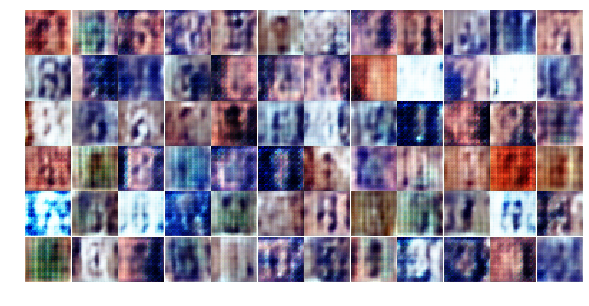

[14/25][410/573] Loss_D: 0.3452 Loss_G: 4.4810 D(x): 0.8345 D(G(z)): 0.1008 / 0.0213
[14/25][420/573] Loss_D: 0.8704 Loss_G: 1.6611 D(x): 0.7729 D(G(z)): 0.3251 / 0.2655
[14/25][430/573] Loss_D: 0.4516 Loss_G: 3.2097 D(x): 0.8784 D(G(z)): 0.2331 / 0.0805
[14/25][440/573] Loss_D: 0.6358 Loss_G: 2.5549 D(x): 0.6356 D(G(z)): 0.0641 / 0.1202
[14/25][450/573] Loss_D: 0.3599 Loss_G: 1.8724 D(x): 0.9120 D(G(z)): 0.2075 / 0.2324
[14/25][460/573] Loss_D: 0.3969 Loss_G: 2.5400 D(x): 0.9207 D(G(z)): 0.2347 / 0.1186
[14/25][470/573] Loss_D: 1.5384 Loss_G: 1.7205 D(x): 0.4028 D(G(z)): 0.2495 / 0.2559
[14/25][480/573] Loss_D: 0.4355 Loss_G: 2.0512 D(x): 0.9286 D(G(z)): 0.2636 / 0.1898
[14/25][490/573] Loss_D: 0.2340 Loss_G: 3.0105 D(x): 0.8965 D(G(z)): 0.1033 / 0.0800
[14/25][500/573] Loss_D: 0.4314 Loss_G: 2.5411 D(x): 0.8048 D(G(z)): 0.1604 / 0.1046


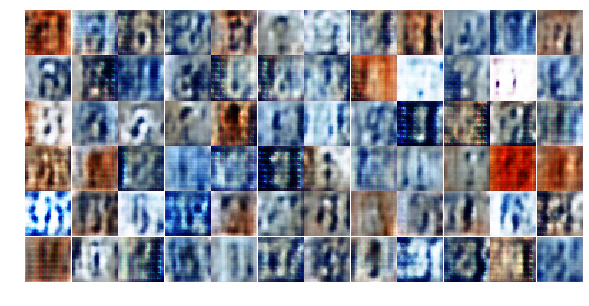

[14/25][510/573] Loss_D: 0.4569 Loss_G: 1.9329 D(x): 0.8955 D(G(z)): 0.2597 / 0.1776
[14/25][520/573] Loss_D: 1.3017 Loss_G: 2.1421 D(x): 0.6980 D(G(z)): 0.5301 / 0.1611
[14/25][530/573] Loss_D: 1.0066 Loss_G: 1.1027 D(x): 0.7300 D(G(z)): 0.4272 / 0.3830
[14/25][540/573] Loss_D: 0.7037 Loss_G: 1.4122 D(x): 0.8618 D(G(z)): 0.3847 / 0.3122
[14/25][550/573] Loss_D: 0.5837 Loss_G: 1.9977 D(x): 0.7923 D(G(z)): 0.2404 / 0.1831
[14/25][560/573] Loss_D: 0.6158 Loss_G: 2.0540 D(x): 0.7883 D(G(z)): 0.2553 / 0.1760
[14/25][570/573] Loss_D: 0.7812 Loss_G: 1.7302 D(x): 0.6029 D(G(z)): 0.1539 / 0.2236
[15/25][0/573] Loss_D: 0.9477 Loss_G: 1.0986 D(x): 0.8483 D(G(z)): 0.4767 / 0.3918


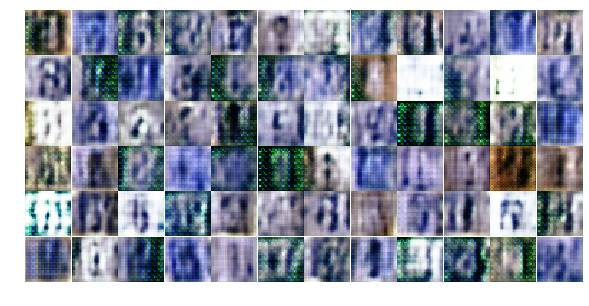

[15/25][10/573] Loss_D: 0.4649 Loss_G: 2.4119 D(x): 0.8927 D(G(z)): 0.2622 / 0.1351
[15/25][20/573] Loss_D: 0.4095 Loss_G: 2.7564 D(x): 0.8314 D(G(z)): 0.1605 / 0.0886
[15/25][30/573] Loss_D: 0.3067 Loss_G: 2.7531 D(x): 0.8815 D(G(z)): 0.1380 / 0.0940
[15/25][40/573] Loss_D: 0.7360 Loss_G: 1.7193 D(x): 0.7506 D(G(z)): 0.3047 / 0.2319
[15/25][50/573] Loss_D: 0.6024 Loss_G: 2.1002 D(x): 0.6776 D(G(z)): 0.1259 / 0.1574
[15/25][60/573] Loss_D: 0.3346 Loss_G: 2.3012 D(x): 0.9191 D(G(z)): 0.2060 / 0.1442
[15/25][70/573] Loss_D: 0.3567 Loss_G: 2.7152 D(x): 0.7921 D(G(z)): 0.0974 / 0.0934
[15/25][80/573] Loss_D: 0.8712 Loss_G: 2.6963 D(x): 0.8819 D(G(z)): 0.4721 / 0.1013
[15/25][90/573] Loss_D: 0.5866 Loss_G: 2.1689 D(x): 0.9009 D(G(z)): 0.3302 / 0.1766
[15/25][100/573] Loss_D: 0.6650 Loss_G: 1.6443 D(x): 0.8084 D(G(z)): 0.2997 / 0.2598


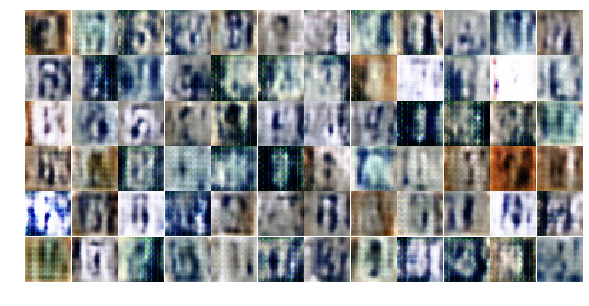

[15/25][110/573] Loss_D: 1.5104 Loss_G: 1.2939 D(x): 0.5439 D(G(z)): 0.4412 / 0.3611
[15/25][120/573] Loss_D: 0.5288 Loss_G: 2.9743 D(x): 0.8512 D(G(z)): 0.2426 / 0.0921
[15/25][130/573] Loss_D: 0.5920 Loss_G: 2.1013 D(x): 0.7593 D(G(z)): 0.1905 / 0.1907
[15/25][140/573] Loss_D: 0.8389 Loss_G: 2.9420 D(x): 0.6022 D(G(z)): 0.1414 / 0.0919
[15/25][150/573] Loss_D: 0.5684 Loss_G: 1.4770 D(x): 0.9257 D(G(z)): 0.3364 / 0.3113
[15/25][160/573] Loss_D: 0.2023 Loss_G: 3.0784 D(x): 0.9371 D(G(z)): 0.1085 / 0.0848
[15/25][170/573] Loss_D: 0.1143 Loss_G: 4.4040 D(x): 0.9352 D(G(z)): 0.0379 / 0.0238
[15/25][180/573] Loss_D: 0.3351 Loss_G: 2.8396 D(x): 0.8414 D(G(z)): 0.1153 / 0.0837
[15/25][190/573] Loss_D: 0.4080 Loss_G: 2.5030 D(x): 0.8181 D(G(z)): 0.1449 / 0.1171
[15/25][200/573] Loss_D: 0.3614 Loss_G: 3.1109 D(x): 0.8025 D(G(z)): 0.0807 / 0.0629


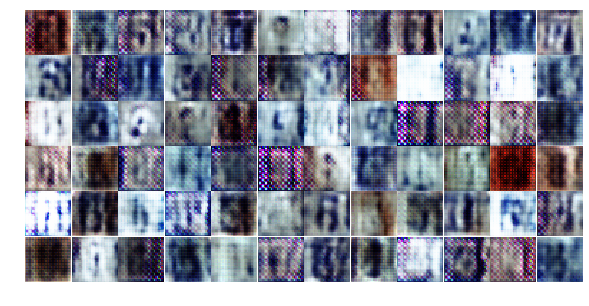

[15/25][210/573] Loss_D: 0.9313 Loss_G: 2.6345 D(x): 0.5163 D(G(z)): 0.0841 / 0.0987
[15/25][220/573] Loss_D: 0.3899 Loss_G: 2.4211 D(x): 0.9163 D(G(z)): 0.2354 / 0.1269
[15/25][230/573] Loss_D: 0.5010 Loss_G: 2.5001 D(x): 0.7958 D(G(z)): 0.1985 / 0.1251
[15/25][240/573] Loss_D: 0.6741 Loss_G: 1.8234 D(x): 0.6453 D(G(z)): 0.1330 / 0.2452
[15/25][250/573] Loss_D: 0.5928 Loss_G: 2.8889 D(x): 0.6980 D(G(z)): 0.1338 / 0.0866
[15/25][260/573] Loss_D: 0.2815 Loss_G: 2.2725 D(x): 0.9036 D(G(z)): 0.1493 / 0.1445
[15/25][270/573] Loss_D: 0.9378 Loss_G: 0.8462 D(x): 0.6681 D(G(z)): 0.3309 / 0.4841
[15/25][280/573] Loss_D: 0.5949 Loss_G: 3.6354 D(x): 0.6432 D(G(z)): 0.0806 / 0.0548
[15/25][290/573] Loss_D: 0.1373 Loss_G: 2.4395 D(x): 0.9478 D(G(z)): 0.0737 / 0.1217
[15/25][300/573] Loss_D: 0.4629 Loss_G: 2.8409 D(x): 0.8560 D(G(z)): 0.2371 / 0.0881


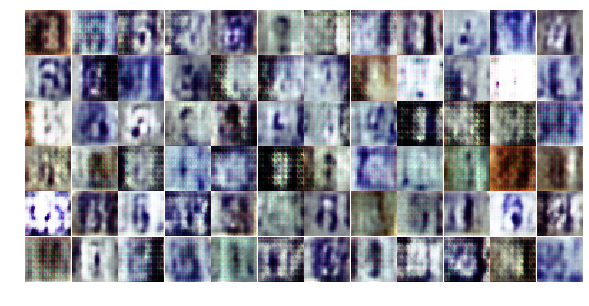

[15/25][310/573] Loss_D: 0.9907 Loss_G: 1.7618 D(x): 0.7826 D(G(z)): 0.4736 / 0.2259
[15/25][320/573] Loss_D: 0.7571 Loss_G: 2.5083 D(x): 0.5850 D(G(z)): 0.1107 / 0.1037
[15/25][330/573] Loss_D: 0.6638 Loss_G: 1.6179 D(x): 0.8848 D(G(z)): 0.3792 / 0.2454
[15/25][340/573] Loss_D: 0.4654 Loss_G: 2.1822 D(x): 0.8176 D(G(z)): 0.1879 / 0.1580
[15/25][350/573] Loss_D: 0.3557 Loss_G: 2.5024 D(x): 0.8793 D(G(z)): 0.1704 / 0.1098
[15/25][360/573] Loss_D: 0.7557 Loss_G: 1.6023 D(x): 0.8899 D(G(z)): 0.4244 / 0.2555
[15/25][370/573] Loss_D: 0.8075 Loss_G: 4.5337 D(x): 0.5425 D(G(z)): 0.0242 / 0.0266
[15/25][380/573] Loss_D: 0.6434 Loss_G: 1.6280 D(x): 0.9562 D(G(z)): 0.4109 / 0.2401
[15/25][390/573] Loss_D: 1.0146 Loss_G: 2.1120 D(x): 0.5874 D(G(z)): 0.2756 / 0.1767
[15/25][400/573] Loss_D: 0.4706 Loss_G: 2.7716 D(x): 0.8309 D(G(z)): 0.2079 / 0.0928


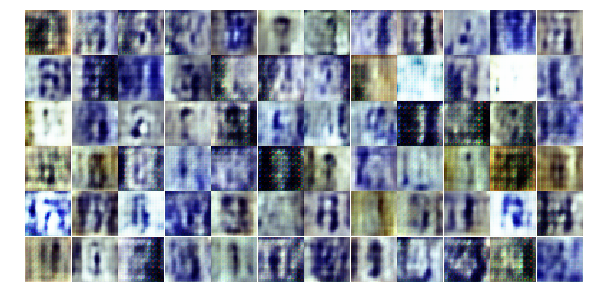

[15/25][410/573] Loss_D: 0.3141 Loss_G: 2.9259 D(x): 0.9345 D(G(z)): 0.1882 / 0.0977
[15/25][420/573] Loss_D: 0.9824 Loss_G: 3.0201 D(x): 0.5372 D(G(z)): 0.1490 / 0.0825
[15/25][430/573] Loss_D: 0.5187 Loss_G: 2.7579 D(x): 0.7790 D(G(z)): 0.1267 / 0.1113
[15/25][440/573] Loss_D: 0.6587 Loss_G: 1.8163 D(x): 0.8499 D(G(z)): 0.3285 / 0.2316
[15/25][450/573] Loss_D: 0.5280 Loss_G: 2.8348 D(x): 0.7719 D(G(z)): 0.1540 / 0.0953
[15/25][460/573] Loss_D: 0.6881 Loss_G: 2.3234 D(x): 0.7362 D(G(z)): 0.2329 / 0.1374
[15/25][470/573] Loss_D: 0.5004 Loss_G: 2.4861 D(x): 0.8750 D(G(z)): 0.2686 / 0.1204
[15/25][480/573] Loss_D: 0.5481 Loss_G: 2.1170 D(x): 0.8520 D(G(z)): 0.2692 / 0.1671
[15/25][490/573] Loss_D: 0.3877 Loss_G: 2.2997 D(x): 0.9347 D(G(z)): 0.2486 / 0.1372
[15/25][500/573] Loss_D: 0.9330 Loss_G: 1.7461 D(x): 0.6766 D(G(z)): 0.3160 / 0.2759


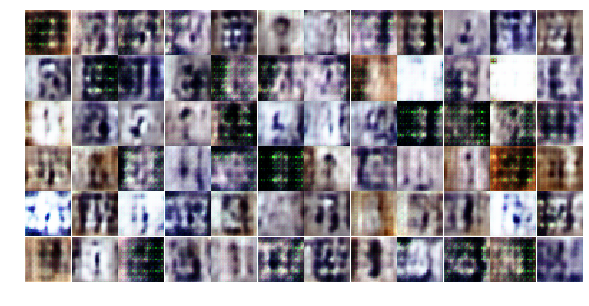

[15/25][510/573] Loss_D: 0.7878 Loss_G: 3.0865 D(x): 0.6524 D(G(z)): 0.1385 / 0.0996
[15/25][520/573] Loss_D: 0.2967 Loss_G: 3.4082 D(x): 0.8335 D(G(z)): 0.0718 / 0.0563
[15/25][530/573] Loss_D: 0.2867 Loss_G: 3.4065 D(x): 0.8669 D(G(z)): 0.1085 / 0.0565
[15/25][540/573] Loss_D: 0.8275 Loss_G: 2.8271 D(x): 0.5459 D(G(z)): 0.0607 / 0.0989
[15/25][550/573] Loss_D: 0.3039 Loss_G: 2.9108 D(x): 0.9595 D(G(z)): 0.1933 / 0.0920
[15/25][560/573] Loss_D: 0.4791 Loss_G: 3.1780 D(x): 0.7662 D(G(z)): 0.0839 / 0.0673
[15/25][570/573] Loss_D: 0.3425 Loss_G: 2.9050 D(x): 0.8074 D(G(z)): 0.0612 / 0.0892
[16/25][0/573] Loss_D: 0.5082 Loss_G: 2.0652 D(x): 0.9417 D(G(z)): 0.3163 / 0.1883


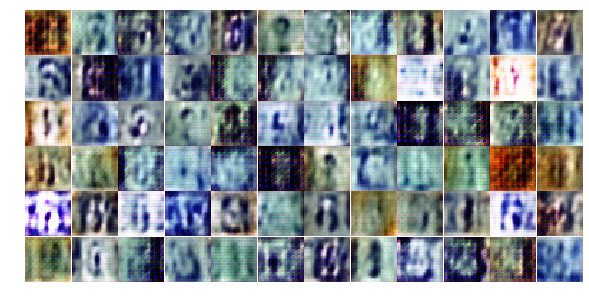

[16/25][10/573] Loss_D: 0.3541 Loss_G: 3.6154 D(x): 0.7982 D(G(z)): 0.0822 / 0.0546
[16/25][20/573] Loss_D: 1.0594 Loss_G: 1.2988 D(x): 0.8951 D(G(z)): 0.5139 / 0.3519
[16/25][30/573] Loss_D: 0.5918 Loss_G: 1.6384 D(x): 0.8865 D(G(z)): 0.3167 / 0.2807
[16/25][40/573] Loss_D: 1.0127 Loss_G: 3.5089 D(x): 0.5432 D(G(z)): 0.0978 / 0.0677
[16/25][50/573] Loss_D: 0.4485 Loss_G: 2.6650 D(x): 0.8263 D(G(z)): 0.1414 / 0.1255
[16/25][60/573] Loss_D: 0.2721 Loss_G: 2.8851 D(x): 0.8728 D(G(z)): 0.0866 / 0.0933
[16/25][70/573] Loss_D: 0.7427 Loss_G: 3.0805 D(x): 0.6317 D(G(z)): 0.0921 / 0.0784
[16/25][80/573] Loss_D: 0.5549 Loss_G: 1.3864 D(x): 0.9069 D(G(z)): 0.3257 / 0.3302
[16/25][90/573] Loss_D: 0.2779 Loss_G: 3.7006 D(x): 0.8499 D(G(z)): 0.0693 / 0.0516
[16/25][100/573] Loss_D: 0.5073 Loss_G: 2.9863 D(x): 0.8292 D(G(z)): 0.2187 / 0.0853


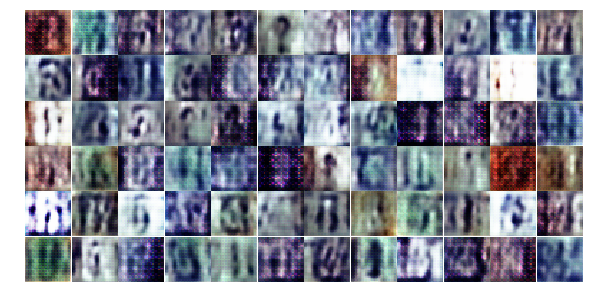

[16/25][110/573] Loss_D: 0.9906 Loss_G: 1.8771 D(x): 0.8730 D(G(z)): 0.4994 / 0.2183
[16/25][120/573] Loss_D: 0.2849 Loss_G: 4.1171 D(x): 0.8279 D(G(z)): 0.0415 / 0.0378
[16/25][130/573] Loss_D: 0.1750 Loss_G: 3.5788 D(x): 0.9202 D(G(z)): 0.0740 / 0.0521
[16/25][140/573] Loss_D: 0.8972 Loss_G: 1.6493 D(x): 0.8591 D(G(z)): 0.4182 / 0.2765
[16/25][150/573] Loss_D: 0.7143 Loss_G: 2.4528 D(x): 0.9124 D(G(z)): 0.3881 / 0.1439
[16/25][160/573] Loss_D: 0.9839 Loss_G: 1.2883 D(x): 0.8789 D(G(z)): 0.4855 / 0.3672
[16/25][170/573] Loss_D: 0.1790 Loss_G: 3.2055 D(x): 0.9030 D(G(z)): 0.0603 / 0.0709
[16/25][180/573] Loss_D: 0.4793 Loss_G: 1.0588 D(x): 0.9807 D(G(z)): 0.3164 / 0.4253
[16/25][190/573] Loss_D: 0.4270 Loss_G: 2.8851 D(x): 0.9540 D(G(z)): 0.2642 / 0.0987
[16/25][200/573] Loss_D: 1.2836 Loss_G: 1.7549 D(x): 0.4352 D(G(z)): 0.1009 / 0.2438


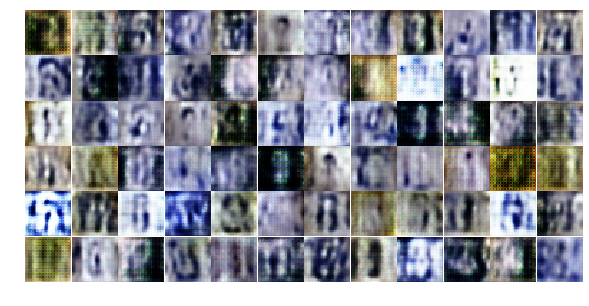

[16/25][210/573] Loss_D: 0.7834 Loss_G: 2.2322 D(x): 0.8746 D(G(z)): 0.4011 / 0.1575
[16/25][220/573] Loss_D: 0.6329 Loss_G: 2.3219 D(x): 0.6879 D(G(z)): 0.1464 / 0.1312
[16/25][230/573] Loss_D: 0.2963 Loss_G: 2.2039 D(x): 0.9535 D(G(z)): 0.2010 / 0.1525
[16/25][240/573] Loss_D: 0.3415 Loss_G: 1.9361 D(x): 0.9560 D(G(z)): 0.2366 / 0.1857
[16/25][250/573] Loss_D: 0.2457 Loss_G: 3.4051 D(x): 0.8799 D(G(z)): 0.0832 / 0.0487
[16/25][260/573] Loss_D: 0.4983 Loss_G: 1.5465 D(x): 0.8583 D(G(z)): 0.2573 / 0.2630
[16/25][270/573] Loss_D: 0.8257 Loss_G: 2.8485 D(x): 0.5422 D(G(z)): 0.0709 / 0.0928
[16/25][280/573] Loss_D: 0.5073 Loss_G: 3.0071 D(x): 0.7348 D(G(z)): 0.1413 / 0.0701
[16/25][290/573] Loss_D: 0.2894 Loss_G: 3.0235 D(x): 0.8836 D(G(z)): 0.1258 / 0.0878
[16/25][300/573] Loss_D: 0.3530 Loss_G: 2.1238 D(x): 0.8824 D(G(z)): 0.1692 / 0.1875


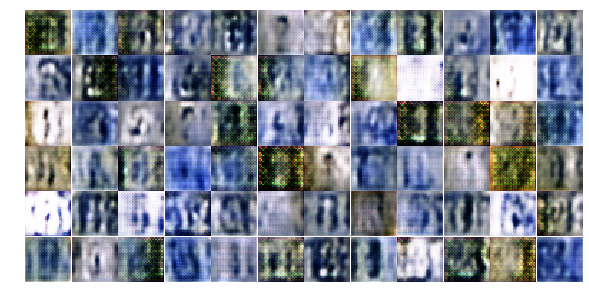

[16/25][310/573] Loss_D: 0.5703 Loss_G: 4.0223 D(x): 0.6649 D(G(z)): 0.0695 / 0.0404
[16/25][320/573] Loss_D: 2.3456 Loss_G: 1.2413 D(x): 0.8619 D(G(z)): 0.7935 / 0.4263
[16/25][330/573] Loss_D: 0.2744 Loss_G: 4.2029 D(x): 0.8540 D(G(z)): 0.0693 / 0.0467
[16/25][340/573] Loss_D: 0.0757 Loss_G: 4.5571 D(x): 0.9799 D(G(z)): 0.0447 / 0.0318
[16/25][350/573] Loss_D: 0.2675 Loss_G: 3.8363 D(x): 0.8793 D(G(z)): 0.0566 / 0.0429
[16/25][360/573] Loss_D: 0.8788 Loss_G: 2.3659 D(x): 0.7848 D(G(z)): 0.3682 / 0.1727
[16/25][370/573] Loss_D: 1.3695 Loss_G: 1.2964 D(x): 0.5224 D(G(z)): 0.3275 / 0.3669
[16/25][380/573] Loss_D: 0.8794 Loss_G: 3.3196 D(x): 0.5865 D(G(z)): 0.1451 / 0.1024
[16/25][390/573] Loss_D: 0.3894 Loss_G: 2.4091 D(x): 0.9517 D(G(z)): 0.2225 / 0.1645
[16/25][400/573] Loss_D: 0.2659 Loss_G: 2.9821 D(x): 0.9724 D(G(z)): 0.1877 / 0.1013


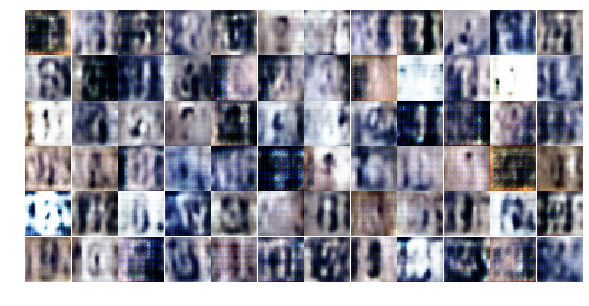

[16/25][410/573] Loss_D: 0.4836 Loss_G: 2.5537 D(x): 0.7398 D(G(z)): 0.0992 / 0.1327
[16/25][420/573] Loss_D: 0.4653 Loss_G: 2.0047 D(x): 0.9594 D(G(z)): 0.2972 / 0.1984
[16/25][430/573] Loss_D: 0.5136 Loss_G: 2.2653 D(x): 0.8578 D(G(z)): 0.2555 / 0.1569
[16/25][440/573] Loss_D: 0.2134 Loss_G: 3.8956 D(x): 0.9451 D(G(z)): 0.1211 / 0.0436
[16/25][450/573] Loss_D: 0.3425 Loss_G: 2.9382 D(x): 0.9259 D(G(z)): 0.2008 / 0.1053
[16/25][460/573] Loss_D: 0.4064 Loss_G: 3.8708 D(x): 0.7645 D(G(z)): 0.0811 / 0.0347
[16/25][470/573] Loss_D: 0.2830 Loss_G: 2.8266 D(x): 0.9327 D(G(z)): 0.1610 / 0.0937
[16/25][480/573] Loss_D: 0.6302 Loss_G: 2.7503 D(x): 0.7208 D(G(z)): 0.1854 / 0.1059
[16/25][490/573] Loss_D: 0.8503 Loss_G: 1.8311 D(x): 0.7695 D(G(z)): 0.3804 / 0.2191
[16/25][500/573] Loss_D: 0.7537 Loss_G: 2.6084 D(x): 0.8367 D(G(z)): 0.3686 / 0.1268


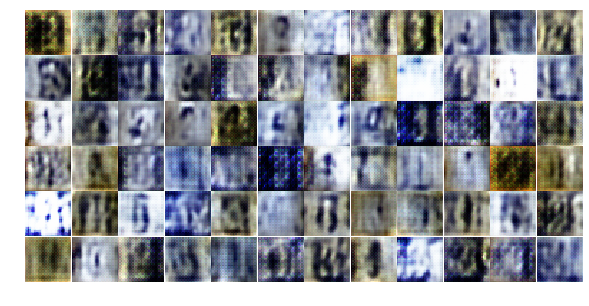

[16/25][510/573] Loss_D: 0.8756 Loss_G: 1.2059 D(x): 0.5727 D(G(z)): 0.1403 / 0.3601
[16/25][520/573] Loss_D: 0.8756 Loss_G: 3.6446 D(x): 0.5335 D(G(z)): 0.0339 / 0.0435
[16/25][530/573] Loss_D: 0.4087 Loss_G: 2.3239 D(x): 0.9101 D(G(z)): 0.2372 / 0.1359
[16/25][540/573] Loss_D: 0.4856 Loss_G: 2.5887 D(x): 0.7895 D(G(z)): 0.1800 / 0.1048
[16/25][550/573] Loss_D: 0.6365 Loss_G: 1.7183 D(x): 0.8243 D(G(z)): 0.3100 / 0.2443
[16/25][560/573] Loss_D: 0.6410 Loss_G: 2.0468 D(x): 0.8710 D(G(z)): 0.3217 / 0.1940
[16/25][570/573] Loss_D: 0.5691 Loss_G: 1.7977 D(x): 0.9004 D(G(z)): 0.3178 / 0.2336
[17/25][0/573] Loss_D: 0.3776 Loss_G: 2.4394 D(x): 0.9105 D(G(z)): 0.2091 / 0.1205


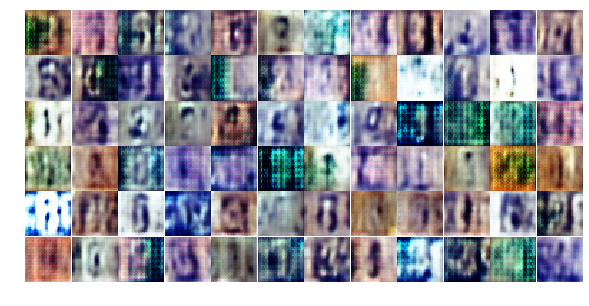

[17/25][10/573] Loss_D: 0.3346 Loss_G: 2.4948 D(x): 0.8715 D(G(z)): 0.1525 / 0.1290
[17/25][20/573] Loss_D: 0.4936 Loss_G: 2.4782 D(x): 0.7814 D(G(z)): 0.1568 / 0.1228
[17/25][30/573] Loss_D: 0.9149 Loss_G: 1.9063 D(x): 0.6411 D(G(z)): 0.2622 / 0.1916
[17/25][40/573] Loss_D: 0.9992 Loss_G: 1.5165 D(x): 0.6840 D(G(z)): 0.3754 / 0.2833
[17/25][50/573] Loss_D: 0.4043 Loss_G: 1.8321 D(x): 0.9510 D(G(z)): 0.2653 / 0.2291
[17/25][60/573] Loss_D: 0.3811 Loss_G: 2.1080 D(x): 0.8318 D(G(z)): 0.1549 / 0.1614
[17/25][70/573] Loss_D: 0.8128 Loss_G: 1.7305 D(x): 0.6081 D(G(z)): 0.1874 / 0.2157
[17/25][80/573] Loss_D: 0.6526 Loss_G: 1.9240 D(x): 0.8565 D(G(z)): 0.3422 / 0.2023
[17/25][90/573] Loss_D: 0.7883 Loss_G: 2.3818 D(x): 0.5772 D(G(z)): 0.0985 / 0.1291
[17/25][100/573] Loss_D: 0.4517 Loss_G: 2.7899 D(x): 0.7359 D(G(z)): 0.0948 / 0.0878


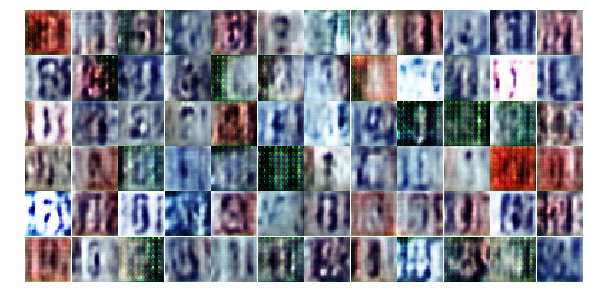

[17/25][110/573] Loss_D: 0.3609 Loss_G: 3.4997 D(x): 0.7862 D(G(z)): 0.0855 / 0.0503
[17/25][120/573] Loss_D: 0.3604 Loss_G: 3.9237 D(x): 0.7621 D(G(z)): 0.0368 / 0.0299
[17/25][130/573] Loss_D: 0.4982 Loss_G: 2.0816 D(x): 0.7406 D(G(z)): 0.1323 / 0.1744
[17/25][140/573] Loss_D: 0.8163 Loss_G: 3.0208 D(x): 0.8952 D(G(z)): 0.4534 / 0.0794
[17/25][150/573] Loss_D: 0.5292 Loss_G: 2.4689 D(x): 0.7035 D(G(z)): 0.0903 / 0.1333
[17/25][160/573] Loss_D: 0.6278 Loss_G: 0.9772 D(x): 0.9761 D(G(z)): 0.4119 / 0.4299
[17/25][170/573] Loss_D: 0.9569 Loss_G: 1.6971 D(x): 0.6275 D(G(z)): 0.2968 / 0.2358
[17/25][180/573] Loss_D: 1.0799 Loss_G: 2.0093 D(x): 0.6078 D(G(z)): 0.3217 / 0.1750
[17/25][190/573] Loss_D: 0.4479 Loss_G: 2.2220 D(x): 0.8256 D(G(z)): 0.1767 / 0.1802
[17/25][200/573] Loss_D: 0.2563 Loss_G: 2.6466 D(x): 0.9591 D(G(z)): 0.1770 / 0.1075


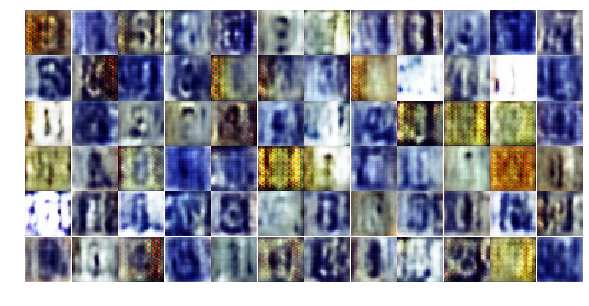

[17/25][210/573] Loss_D: 0.2996 Loss_G: 2.9019 D(x): 0.9021 D(G(z)): 0.1594 / 0.0885
[17/25][220/573] Loss_D: 0.4042 Loss_G: 3.1850 D(x): 0.7616 D(G(z)): 0.0769 / 0.0718
[17/25][230/573] Loss_D: 0.6126 Loss_G: 3.4417 D(x): 0.8999 D(G(z)): 0.3328 / 0.0609
[17/25][240/573] Loss_D: 0.7726 Loss_G: 1.0904 D(x): 0.9229 D(G(z)): 0.4225 / 0.4525
[17/25][250/573] Loss_D: 0.6372 Loss_G: 3.2391 D(x): 0.9417 D(G(z)): 0.3500 / 0.0907
[17/25][260/573] Loss_D: 1.1724 Loss_G: 5.8049 D(x): 0.4687 D(G(z)): 0.0101 / 0.0073
[17/25][270/573] Loss_D: 1.3219 Loss_G: 0.8530 D(x): 0.5331 D(G(z)): 0.3276 / 0.5411
[17/25][280/573] Loss_D: 1.1971 Loss_G: 1.0316 D(x): 0.9458 D(G(z)): 0.5543 / 0.4796
[17/25][290/573] Loss_D: 0.5345 Loss_G: 1.4163 D(x): 0.9645 D(G(z)): 0.3262 / 0.3411
[17/25][300/573] Loss_D: 0.4833 Loss_G: 2.1498 D(x): 0.9078 D(G(z)): 0.2758 / 0.1728


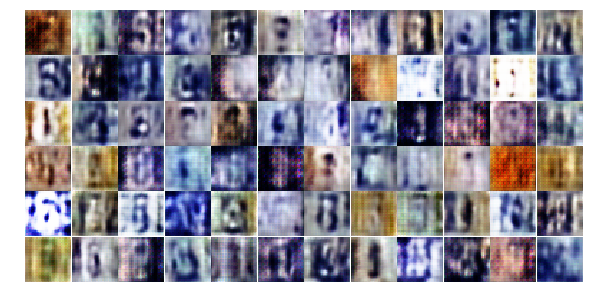

[17/25][310/573] Loss_D: 0.8207 Loss_G: 3.6958 D(x): 0.5747 D(G(z)): 0.1151 / 0.0509
[17/25][320/573] Loss_D: 0.8413 Loss_G: 2.2922 D(x): 0.5914 D(G(z)): 0.1615 / 0.1662
[17/25][330/573] Loss_D: 0.5747 Loss_G: 2.5126 D(x): 0.7719 D(G(z)): 0.1932 / 0.1377
[17/25][340/573] Loss_D: 0.6505 Loss_G: 2.1950 D(x): 0.6955 D(G(z)): 0.1822 / 0.1568
[17/25][350/573] Loss_D: 0.4024 Loss_G: 2.9427 D(x): 0.8354 D(G(z)): 0.1598 / 0.0852
[17/25][360/573] Loss_D: 0.1816 Loss_G: 4.1407 D(x): 0.8795 D(G(z)): 0.0306 / 0.0265
[17/25][370/573] Loss_D: 0.4663 Loss_G: 3.0361 D(x): 0.8325 D(G(z)): 0.1723 / 0.0901
[17/25][380/573] Loss_D: 1.0425 Loss_G: 1.9751 D(x): 0.5332 D(G(z)): 0.1314 / 0.2011
[17/25][390/573] Loss_D: 0.6726 Loss_G: 2.2298 D(x): 0.7681 D(G(z)): 0.2525 / 0.1540
[17/25][400/573] Loss_D: 0.8172 Loss_G: 1.5096 D(x): 0.7911 D(G(z)): 0.3621 / 0.3101


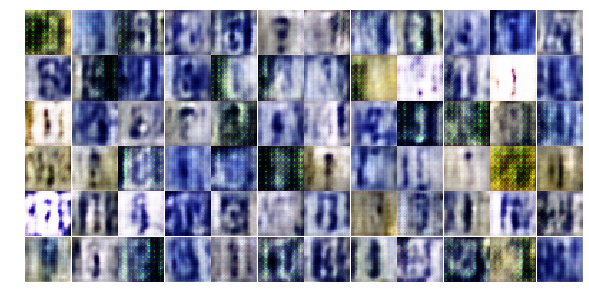

[17/25][410/573] Loss_D: 0.6479 Loss_G: 2.4068 D(x): 0.6733 D(G(z)): 0.1344 / 0.1537
[17/25][420/573] Loss_D: 0.0837 Loss_G: 4.7274 D(x): 0.9540 D(G(z)): 0.0324 / 0.0217
[17/25][430/573] Loss_D: 0.3777 Loss_G: 4.4617 D(x): 0.7654 D(G(z)): 0.0383 / 0.0252
[17/25][440/573] Loss_D: 0.2134 Loss_G: 3.6625 D(x): 0.9319 D(G(z)): 0.1110 / 0.0501
[17/25][450/573] Loss_D: 0.1545 Loss_G: 3.8318 D(x): 0.9511 D(G(z)): 0.0881 / 0.0402
[17/25][460/573] Loss_D: 0.1028 Loss_G: 3.8952 D(x): 0.9867 D(G(z)): 0.0809 / 0.0344
[17/25][470/573] Loss_D: 0.0927 Loss_G: 4.1463 D(x): 0.9791 D(G(z)): 0.0655 / 0.0264
[17/25][480/573] Loss_D: 0.2499 Loss_G: 2.9102 D(x): 0.9772 D(G(z)): 0.1843 / 0.0901
[17/25][490/573] Loss_D: 0.5296 Loss_G: 3.4543 D(x): 0.7812 D(G(z)): 0.1804 / 0.0583
[17/25][500/573] Loss_D: 0.7850 Loss_G: 3.7446 D(x): 0.5411 D(G(z)): 0.0180 / 0.0690


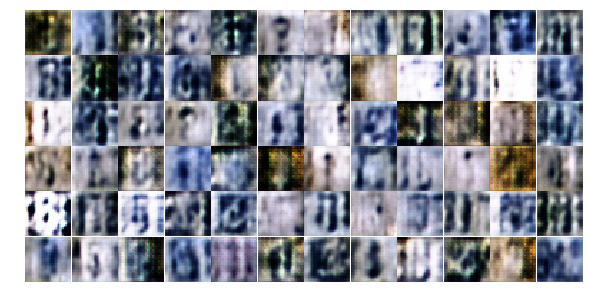

[17/25][510/573] Loss_D: 0.7966 Loss_G: 2.6554 D(x): 0.9703 D(G(z)): 0.4649 / 0.1228
[17/25][520/573] Loss_D: 1.0006 Loss_G: 1.3355 D(x): 0.6894 D(G(z)): 0.3266 / 0.3568
[17/25][530/573] Loss_D: 0.7747 Loss_G: 1.9981 D(x): 0.8363 D(G(z)): 0.3135 / 0.2150
[17/25][540/573] Loss_D: 0.2887 Loss_G: 3.3137 D(x): 0.8358 D(G(z)): 0.0634 / 0.0712
[17/25][550/573] Loss_D: 0.5824 Loss_G: 2.0853 D(x): 0.8131 D(G(z)): 0.2348 / 0.1915
[17/25][560/573] Loss_D: 1.4498 Loss_G: 1.4324 D(x): 0.4514 D(G(z)): 0.2760 / 0.3407
[17/25][570/573] Loss_D: 0.7185 Loss_G: 1.9557 D(x): 0.9277 D(G(z)): 0.3996 / 0.2302
[18/25][0/573] Loss_D: 0.2830 Loss_G: 4.3138 D(x): 0.8554 D(G(z)): 0.0802 / 0.0436


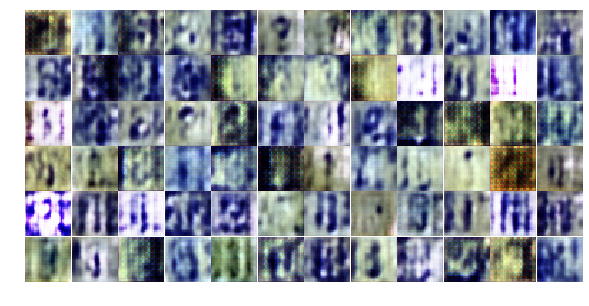

[18/25][10/573] Loss_D: 0.7521 Loss_G: 3.5216 D(x): 0.5860 D(G(z)): 0.0460 / 0.0577
[18/25][20/573] Loss_D: 0.4818 Loss_G: 1.5211 D(x): 0.8132 D(G(z)): 0.1936 / 0.2867
[18/25][30/573] Loss_D: 1.5520 Loss_G: 0.8965 D(x): 0.8815 D(G(z)): 0.6747 / 0.4883
[18/25][40/573] Loss_D: 0.8554 Loss_G: 2.2740 D(x): 0.6022 D(G(z)): 0.1722 / 0.1321
[18/25][50/573] Loss_D: 0.6138 Loss_G: 2.1127 D(x): 0.7395 D(G(z)): 0.2060 / 0.1600
[18/25][60/573] Loss_D: 0.3309 Loss_G: 2.8280 D(x): 0.9363 D(G(z)): 0.2035 / 0.1067
[18/25][70/573] Loss_D: 0.1105 Loss_G: 4.4428 D(x): 0.9414 D(G(z)): 0.0435 / 0.0193
[18/25][80/573] Loss_D: 0.4062 Loss_G: 2.0147 D(x): 0.8726 D(G(z)): 0.2009 / 0.1845
[18/25][90/573] Loss_D: 0.6913 Loss_G: 2.5295 D(x): 0.6970 D(G(z)): 0.2191 / 0.1145
[18/25][100/573] Loss_D: 0.6304 Loss_G: 1.1415 D(x): 0.9734 D(G(z)): 0.3843 / 0.4145


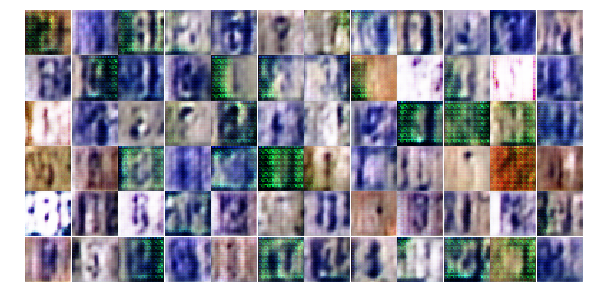

[18/25][110/573] Loss_D: 0.4937 Loss_G: 1.8831 D(x): 0.9535 D(G(z)): 0.2583 / 0.2197
[18/25][120/573] Loss_D: 0.3678 Loss_G: 2.0789 D(x): 0.8908 D(G(z)): 0.1998 / 0.1679
[18/25][130/573] Loss_D: 0.9034 Loss_G: 1.9877 D(x): 0.6546 D(G(z)): 0.2933 / 0.1848
[18/25][140/573] Loss_D: 0.6292 Loss_G: 2.0874 D(x): 0.8099 D(G(z)): 0.2771 / 0.1848
[18/25][150/573] Loss_D: 0.2405 Loss_G: 3.0719 D(x): 0.9275 D(G(z)): 0.1363 / 0.0731
[18/25][160/573] Loss_D: 0.4525 Loss_G: 2.5136 D(x): 0.7857 D(G(z)): 0.1509 / 0.1142
[18/25][170/573] Loss_D: 0.8343 Loss_G: 2.0043 D(x): 0.7871 D(G(z)): 0.3718 / 0.1882
[18/25][180/573] Loss_D: 0.6175 Loss_G: 1.7944 D(x): 0.7513 D(G(z)): 0.2169 / 0.2180
[18/25][190/573] Loss_D: 0.6828 Loss_G: 1.3465 D(x): 0.9192 D(G(z)): 0.3963 / 0.3375
[18/25][200/573] Loss_D: 0.7974 Loss_G: 2.0351 D(x): 0.6946 D(G(z)): 0.2668 / 0.1721


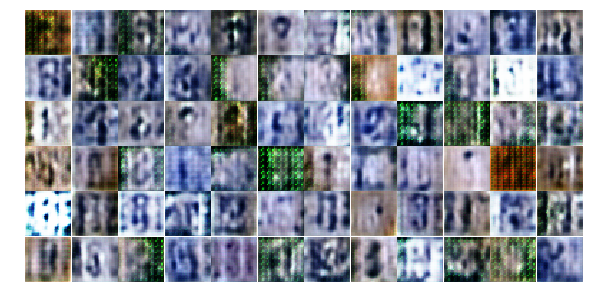

[18/25][210/573] Loss_D: 0.3072 Loss_G: 3.1620 D(x): 0.8368 D(G(z)): 0.0994 / 0.0674
[18/25][220/573] Loss_D: 0.5255 Loss_G: 2.6324 D(x): 0.7109 D(G(z)): 0.1028 / 0.1044
[18/25][230/573] Loss_D: 1.6123 Loss_G: 1.1927 D(x): 0.3610 D(G(z)): 0.1929 / 0.3691
[18/25][240/573] Loss_D: 0.8004 Loss_G: 2.0038 D(x): 0.8559 D(G(z)): 0.4161 / 0.1831
[18/25][250/573] Loss_D: 0.4574 Loss_G: 2.5505 D(x): 0.8487 D(G(z)): 0.2234 / 0.1064
[18/25][260/573] Loss_D: 0.4129 Loss_G: 3.7096 D(x): 0.7222 D(G(z)): 0.0307 / 0.0383
[18/25][270/573] Loss_D: 0.3542 Loss_G: 1.9766 D(x): 0.8801 D(G(z)): 0.1764 / 0.2053
[18/25][280/573] Loss_D: 0.6949 Loss_G: 2.0132 D(x): 0.8594 D(G(z)): 0.3767 / 0.1733
[18/25][290/573] Loss_D: 0.6809 Loss_G: 1.7128 D(x): 0.8290 D(G(z)): 0.3263 / 0.2318
[18/25][300/573] Loss_D: 0.5044 Loss_G: 4.1469 D(x): 0.6853 D(G(z)): 0.0457 / 0.0261


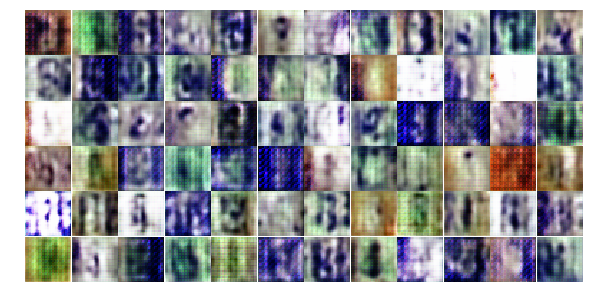

[18/25][310/573] Loss_D: 0.2522 Loss_G: 2.4380 D(x): 0.8949 D(G(z)): 0.1140 / 0.1370
[18/25][320/573] Loss_D: 0.3626 Loss_G: 2.7655 D(x): 0.7961 D(G(z)): 0.0939 / 0.1043
[18/25][330/573] Loss_D: 0.3236 Loss_G: 2.3342 D(x): 0.9347 D(G(z)): 0.1933 / 0.1519
[18/25][340/573] Loss_D: 0.2028 Loss_G: 2.7923 D(x): 0.9475 D(G(z)): 0.1239 / 0.1020
[18/25][350/573] Loss_D: 0.3848 Loss_G: 3.2292 D(x): 0.8833 D(G(z)): 0.1942 / 0.0744
[18/25][360/573] Loss_D: 0.0893 Loss_G: 5.9359 D(x): 0.9478 D(G(z)): 0.0302 / 0.0073
[18/25][370/573] Loss_D: 0.1578 Loss_G: 4.2125 D(x): 0.9443 D(G(z)): 0.0764 / 0.0336
[18/25][380/573] Loss_D: 1.4545 Loss_G: 2.6650 D(x): 0.9578 D(G(z)): 0.6637 / 0.1371
[18/25][390/573] Loss_D: 0.2458 Loss_G: 4.0796 D(x): 0.9579 D(G(z)): 0.1601 / 0.0354
[18/25][400/573] Loss_D: 0.6273 Loss_G: 3.4770 D(x): 0.6286 D(G(z)): 0.0622 / 0.0504


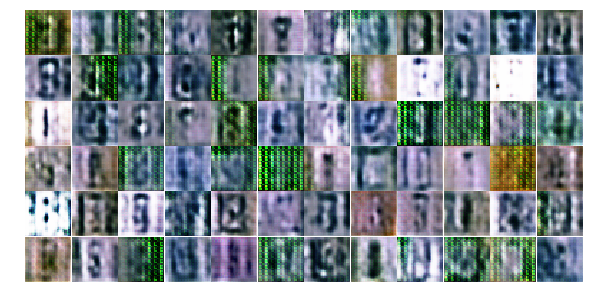

[18/25][410/573] Loss_D: 0.4102 Loss_G: 4.9920 D(x): 0.7162 D(G(z)): 0.0108 / 0.0141
[18/25][420/573] Loss_D: 0.0741 Loss_G: 4.6824 D(x): 0.9641 D(G(z)): 0.0333 / 0.0183
[18/25][430/573] Loss_D: 0.3152 Loss_G: 2.4169 D(x): 0.9848 D(G(z)): 0.2298 / 0.1369
[18/25][440/573] Loss_D: 0.4574 Loss_G: 2.5028 D(x): 0.8931 D(G(z)): 0.2574 / 0.1129
[18/25][450/573] Loss_D: 0.2818 Loss_G: 2.5892 D(x): 0.8699 D(G(z)): 0.1116 / 0.1213
[18/25][460/573] Loss_D: 0.4361 Loss_G: 2.4008 D(x): 0.8629 D(G(z)): 0.2137 / 0.1311
[18/25][470/573] Loss_D: 0.5477 Loss_G: 2.1272 D(x): 0.8814 D(G(z)): 0.3095 / 0.1557
[18/25][480/573] Loss_D: 0.5023 Loss_G: 3.3596 D(x): 0.7194 D(G(z)): 0.0997 / 0.0519
[18/25][490/573] Loss_D: 0.4281 Loss_G: 2.2439 D(x): 0.8709 D(G(z)): 0.2048 / 0.1604
[18/25][500/573] Loss_D: 0.6739 Loss_G: 2.7522 D(x): 0.6611 D(G(z)): 0.1493 / 0.1029


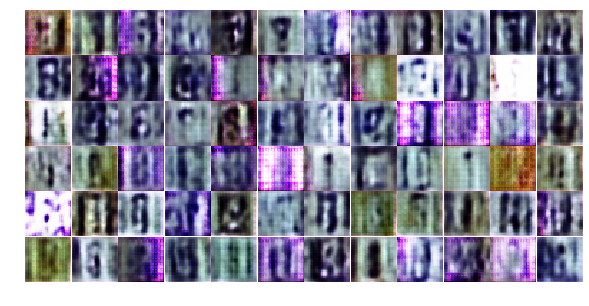

[18/25][510/573] Loss_D: 0.3989 Loss_G: 2.4642 D(x): 0.8270 D(G(z)): 0.1517 / 0.1247
[18/25][520/573] Loss_D: 0.2881 Loss_G: 2.6302 D(x): 0.9127 D(G(z)): 0.1583 / 0.1031
[18/25][530/573] Loss_D: 0.7550 Loss_G: 2.3524 D(x): 0.7313 D(G(z)): 0.2983 / 0.1381
[18/25][540/573] Loss_D: 0.5038 Loss_G: 2.4013 D(x): 0.7240 D(G(z)): 0.0996 / 0.1381
[18/25][550/573] Loss_D: 0.7933 Loss_G: 1.6828 D(x): 0.8935 D(G(z)): 0.4281 / 0.2526
[18/25][560/573] Loss_D: 0.5672 Loss_G: 1.2541 D(x): 0.8216 D(G(z)): 0.2456 / 0.3966
[18/25][570/573] Loss_D: 1.0484 Loss_G: 3.3837 D(x): 0.4716 D(G(z)): 0.0548 / 0.0546
[19/25][0/573] Loss_D: 0.6165 Loss_G: 1.7072 D(x): 0.7658 D(G(z)): 0.2264 / 0.2549


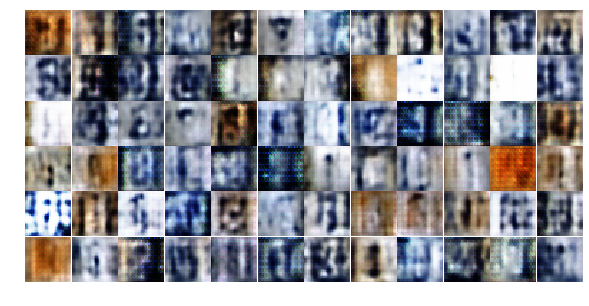

[19/25][10/573] Loss_D: 1.1616 Loss_G: 1.9453 D(x): 0.9628 D(G(z)): 0.6199 / 0.1888
[19/25][20/573] Loss_D: 1.2527 Loss_G: 2.0255 D(x): 0.4033 D(G(z)): 0.0763 / 0.2228
[19/25][30/573] Loss_D: 0.5490 Loss_G: 1.8090 D(x): 0.9107 D(G(z)): 0.3283 / 0.2174
[19/25][40/573] Loss_D: 0.6481 Loss_G: 2.2088 D(x): 0.7138 D(G(z)): 0.1950 / 0.1444
[19/25][50/573] Loss_D: 0.7854 Loss_G: 2.7003 D(x): 0.5587 D(G(z)): 0.0828 / 0.1013
[19/25][60/573] Loss_D: 0.2980 Loss_G: 1.8647 D(x): 0.8621 D(G(z)): 0.1114 / 0.2208
[19/25][70/573] Loss_D: 0.4402 Loss_G: 2.1053 D(x): 0.9631 D(G(z)): 0.2800 / 0.2054
[19/25][80/573] Loss_D: 0.5277 Loss_G: 2.8742 D(x): 0.8997 D(G(z)): 0.2908 / 0.1223
[19/25][90/573] Loss_D: 0.1656 Loss_G: 6.1610 D(x): 0.9145 D(G(z)): 0.0566 / 0.0087
[19/25][100/573] Loss_D: 0.5191 Loss_G: 5.4252 D(x): 0.6716 D(G(z)): 0.0188 / 0.0100


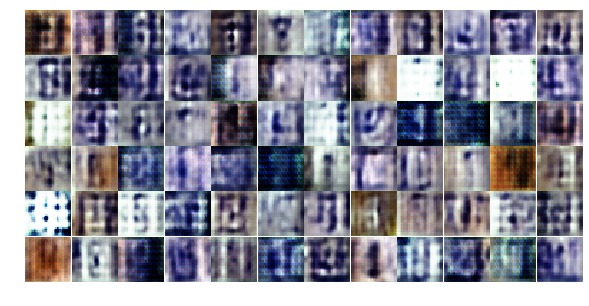

[19/25][110/573] Loss_D: 1.5700 Loss_G: 4.0654 D(x): 0.3121 D(G(z)): 0.0255 / 0.0349
[19/25][120/573] Loss_D: 0.9749 Loss_G: 0.6305 D(x): 0.7693 D(G(z)): 0.4164 / 0.6035
[19/25][130/573] Loss_D: 0.3471 Loss_G: 2.8087 D(x): 0.8095 D(G(z)): 0.0857 / 0.1221
[19/25][140/573] Loss_D: 0.3244 Loss_G: 3.4130 D(x): 0.7924 D(G(z)): 0.0494 / 0.0647
[19/25][150/573] Loss_D: 0.7770 Loss_G: 2.7559 D(x): 0.5853 D(G(z)): 0.0755 / 0.0974
[19/25][160/573] Loss_D: 0.5099 Loss_G: 1.8537 D(x): 0.8359 D(G(z)): 0.2360 / 0.2121
[19/25][170/573] Loss_D: 1.3011 Loss_G: 2.2792 D(x): 0.4546 D(G(z)): 0.1937 / 0.1617
[19/25][180/573] Loss_D: 0.4552 Loss_G: 2.3812 D(x): 0.7761 D(G(z)): 0.1286 / 0.1300
[19/25][190/573] Loss_D: 1.4275 Loss_G: 1.0541 D(x): 0.6289 D(G(z)): 0.4891 / 0.4138
[19/25][200/573] Loss_D: 0.6931 Loss_G: 2.5129 D(x): 0.8000 D(G(z)): 0.2753 / 0.1252


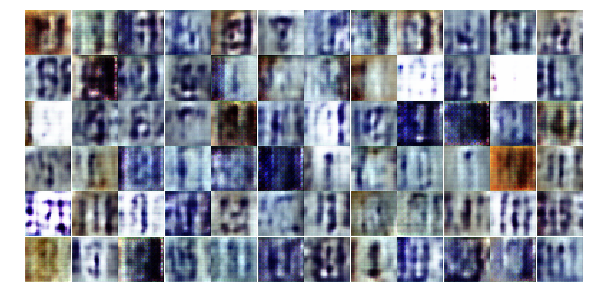

[19/25][210/573] Loss_D: 0.5995 Loss_G: 2.5430 D(x): 0.7244 D(G(z)): 0.1511 / 0.1290
[19/25][220/573] Loss_D: 0.6408 Loss_G: 1.7602 D(x): 0.8458 D(G(z)): 0.3257 / 0.2233
[19/25][230/573] Loss_D: 0.3501 Loss_G: 2.7328 D(x): 0.8491 D(G(z)): 0.1335 / 0.1098
[19/25][240/573] Loss_D: 0.6064 Loss_G: 2.3050 D(x): 0.7789 D(G(z)): 0.2208 / 0.1460
[19/25][250/573] Loss_D: 0.6120 Loss_G: 1.8394 D(x): 0.8400 D(G(z)): 0.3027 / 0.2189
[19/25][260/573] Loss_D: 0.7870 Loss_G: 1.0989 D(x): 0.8461 D(G(z)): 0.4045 / 0.4125
[19/25][270/573] Loss_D: 0.7621 Loss_G: 2.9523 D(x): 0.6400 D(G(z)): 0.1429 / 0.0888
[19/25][280/573] Loss_D: 0.2890 Loss_G: 2.6671 D(x): 0.8654 D(G(z)): 0.1173 / 0.1120
[19/25][290/573] Loss_D: 0.8627 Loss_G: 3.2706 D(x): 0.5535 D(G(z)): 0.0712 / 0.0658
[19/25][300/573] Loss_D: 0.4377 Loss_G: 3.2202 D(x): 0.7554 D(G(z)): 0.0898 / 0.1017


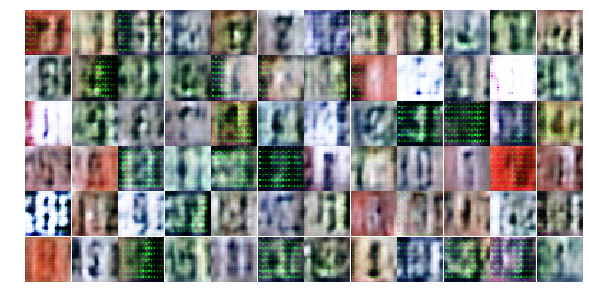

[19/25][310/573] Loss_D: 0.1555 Loss_G: 3.2469 D(x): 0.9318 D(G(z)): 0.0722 / 0.0714
[19/25][320/573] Loss_D: 0.2022 Loss_G: 3.8209 D(x): 0.8868 D(G(z)): 0.0574 / 0.0438
[19/25][330/573] Loss_D: 0.3029 Loss_G: 2.8459 D(x): 0.9070 D(G(z)): 0.1615 / 0.1009
[19/25][340/573] Loss_D: 0.3347 Loss_G: 3.3940 D(x): 0.7913 D(G(z)): 0.0647 / 0.0525
[19/25][350/573] Loss_D: 0.6769 Loss_G: 2.2795 D(x): 0.7212 D(G(z)): 0.2285 / 0.1410
[19/25][360/573] Loss_D: 0.7813 Loss_G: 1.3794 D(x): 0.6806 D(G(z)): 0.2612 / 0.3116
[19/25][370/573] Loss_D: 0.6967 Loss_G: 2.1921 D(x): 0.6877 D(G(z)): 0.2015 / 0.1475
[19/25][380/573] Loss_D: 0.5290 Loss_G: 2.3908 D(x): 0.8569 D(G(z)): 0.2687 / 0.1338
[19/25][390/573] Loss_D: 0.6478 Loss_G: 1.5965 D(x): 0.7578 D(G(z)): 0.2329 / 0.2760
[19/25][400/573] Loss_D: 0.4818 Loss_G: 2.0516 D(x): 0.8784 D(G(z)): 0.2566 / 0.1788


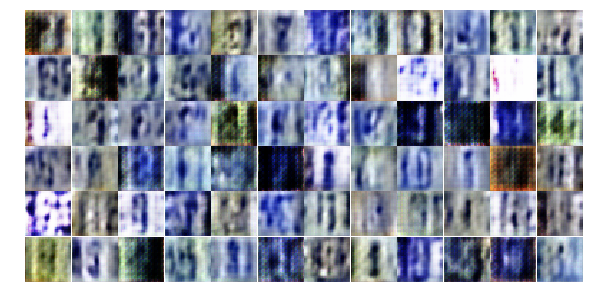

[19/25][410/573] Loss_D: 0.4061 Loss_G: 2.9349 D(x): 0.8776 D(G(z)): 0.2028 / 0.1075
[19/25][420/573] Loss_D: 0.3112 Loss_G: 3.3905 D(x): 0.8463 D(G(z)): 0.1073 / 0.0517
[19/25][430/573] Loss_D: 0.5626 Loss_G: 2.4421 D(x): 0.7106 D(G(z)): 0.1362 / 0.1283
[19/25][440/573] Loss_D: 0.5805 Loss_G: 1.5673 D(x): 0.8916 D(G(z)): 0.3167 / 0.2736
[19/25][450/573] Loss_D: 0.3272 Loss_G: 2.3260 D(x): 0.9151 D(G(z)): 0.1899 / 0.1380
[19/25][460/573] Loss_D: 0.6961 Loss_G: 2.1349 D(x): 0.6331 D(G(z)): 0.1244 / 0.1665
[19/25][470/573] Loss_D: 0.7415 Loss_G: 3.4377 D(x): 0.5733 D(G(z)): 0.0552 / 0.0474
[19/25][480/573] Loss_D: 0.6237 Loss_G: 1.5532 D(x): 0.8721 D(G(z)): 0.3220 / 0.2999
[19/25][490/573] Loss_D: 0.6341 Loss_G: 2.4853 D(x): 0.9320 D(G(z)): 0.3549 / 0.1420
[19/25][500/573] Loss_D: 0.6285 Loss_G: 2.7801 D(x): 0.6471 D(G(z)): 0.0710 / 0.0938


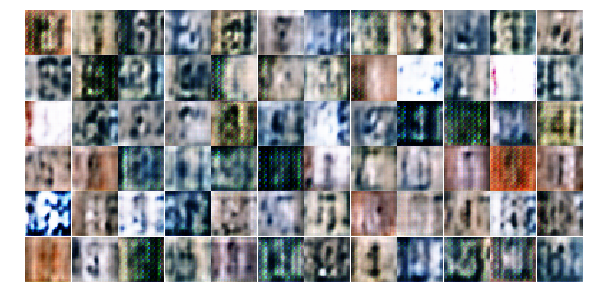

[19/25][510/573] Loss_D: 0.5954 Loss_G: 1.5762 D(x): 0.9352 D(G(z)): 0.3655 / 0.2775
[19/25][520/573] Loss_D: 0.3117 Loss_G: 3.6123 D(x): 0.8832 D(G(z)): 0.1451 / 0.0474
[19/25][530/573] Loss_D: 0.3816 Loss_G: 2.3760 D(x): 0.8435 D(G(z)): 0.1455 / 0.1391
[19/25][540/573] Loss_D: 0.7688 Loss_G: 2.0416 D(x): 0.8986 D(G(z)): 0.4107 / 0.1846
[19/25][550/573] Loss_D: 0.5292 Loss_G: 3.2159 D(x): 0.6865 D(G(z)): 0.0610 / 0.0726
[19/25][560/573] Loss_D: 0.4165 Loss_G: 2.3965 D(x): 0.9305 D(G(z)): 0.2490 / 0.1462
[19/25][570/573] Loss_D: 0.8065 Loss_G: 2.3464 D(x): 0.5763 D(G(z)): 0.0766 / 0.1485
[20/25][0/573] Loss_D: 0.5002 Loss_G: 2.4663 D(x): 0.9422 D(G(z)): 0.3092 / 0.1401


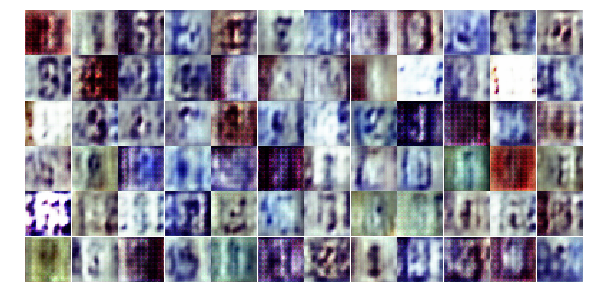

[20/25][10/573] Loss_D: 0.2860 Loss_G: 4.1812 D(x): 0.8374 D(G(z)): 0.0764 / 0.0308
[20/25][20/573] Loss_D: 0.3927 Loss_G: 2.1813 D(x): 0.8504 D(G(z)): 0.1737 / 0.1644
[20/25][30/573] Loss_D: 0.7202 Loss_G: 2.5725 D(x): 0.6389 D(G(z)): 0.1123 / 0.1255
[20/25][40/573] Loss_D: 0.3674 Loss_G: 1.0777 D(x): 0.9730 D(G(z)): 0.2622 / 0.4019
[20/25][50/573] Loss_D: 0.0903 Loss_G: 5.5282 D(x): 0.9352 D(G(z)): 0.0200 / 0.0075
[20/25][60/573] Loss_D: 1.0159 Loss_G: 2.9648 D(x): 0.4747 D(G(z)): 0.0133 / 0.0756
[20/25][70/573] Loss_D: 1.2314 Loss_G: 1.7017 D(x): 0.4720 D(G(z)): 0.1782 / 0.2544
[20/25][80/573] Loss_D: 1.8980 Loss_G: 1.5491 D(x): 0.4971 D(G(z)): 0.5018 / 0.2846
[20/25][90/573] Loss_D: 0.3114 Loss_G: 2.9019 D(x): 0.9415 D(G(z)): 0.1680 / 0.1304
[20/25][100/573] Loss_D: 0.3423 Loss_G: 3.1682 D(x): 0.9529 D(G(z)): 0.2019 / 0.0770


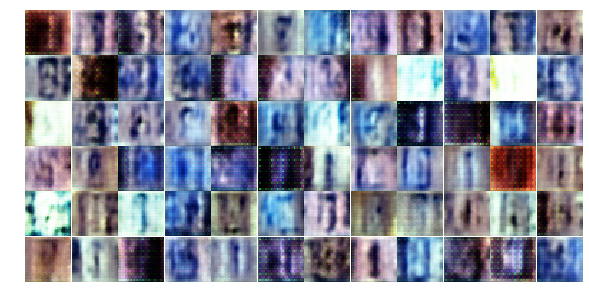

[20/25][110/573] Loss_D: 0.9885 Loss_G: 2.4774 D(x): 0.5647 D(G(z)): 0.1261 / 0.1337
[20/25][120/573] Loss_D: 0.4918 Loss_G: 1.6410 D(x): 0.9682 D(G(z)): 0.3103 / 0.2677
[20/25][130/573] Loss_D: 0.1915 Loss_G: 3.0873 D(x): 0.9813 D(G(z)): 0.1442 / 0.0857
[20/25][140/573] Loss_D: 0.1946 Loss_G: 3.4531 D(x): 0.9021 D(G(z)): 0.0733 / 0.0521
[20/25][150/573] Loss_D: 0.3715 Loss_G: 3.2887 D(x): 0.7983 D(G(z)): 0.0811 / 0.0710
[20/25][160/573] Loss_D: 0.3688 Loss_G: 3.6071 D(x): 0.8191 D(G(z)): 0.1206 / 0.0495
[20/25][170/573] Loss_D: 0.5784 Loss_G: 4.2560 D(x): 0.9058 D(G(z)): 0.3180 / 0.0250
[20/25][180/573] Loss_D: 0.6538 Loss_G: 4.0972 D(x): 0.6027 D(G(z)): 0.0388 / 0.0402
[20/25][190/573] Loss_D: 0.5847 Loss_G: 1.9282 D(x): 0.7593 D(G(z)): 0.2042 / 0.2175
[20/25][200/573] Loss_D: 0.2644 Loss_G: 5.5945 D(x): 0.8114 D(G(z)): 0.0101 / 0.0073


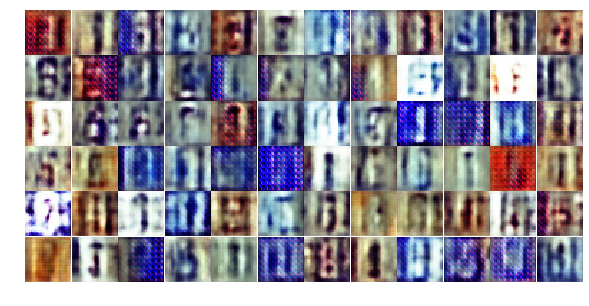

[20/25][210/573] Loss_D: 0.2673 Loss_G: 3.9533 D(x): 0.8283 D(G(z)): 0.0365 / 0.0340
[20/25][220/573] Loss_D: 0.1534 Loss_G: 3.5257 D(x): 0.9491 D(G(z)): 0.0888 / 0.0470
[20/25][230/573] Loss_D: 0.4085 Loss_G: 2.9437 D(x): 0.7495 D(G(z)): 0.0509 / 0.0722
[20/25][240/573] Loss_D: 0.5654 Loss_G: 3.0409 D(x): 0.6995 D(G(z)): 0.1195 / 0.0721
[20/25][250/573] Loss_D: 0.4178 Loss_G: 2.2144 D(x): 0.9200 D(G(z)): 0.2541 / 0.1526
[20/25][260/573] Loss_D: 0.2474 Loss_G: 3.3871 D(x): 0.8514 D(G(z)): 0.0475 / 0.0566
[20/25][270/573] Loss_D: 0.3284 Loss_G: 2.0104 D(x): 0.9564 D(G(z)): 0.2210 / 0.1837
[20/25][280/573] Loss_D: 0.3104 Loss_G: 2.4066 D(x): 0.9333 D(G(z)): 0.1950 / 0.1240
[20/25][290/573] Loss_D: 0.5329 Loss_G: 2.1632 D(x): 0.8398 D(G(z)): 0.2507 / 0.1645
[20/25][300/573] Loss_D: 0.7574 Loss_G: 1.5363 D(x): 0.6586 D(G(z)): 0.1952 / 0.3043


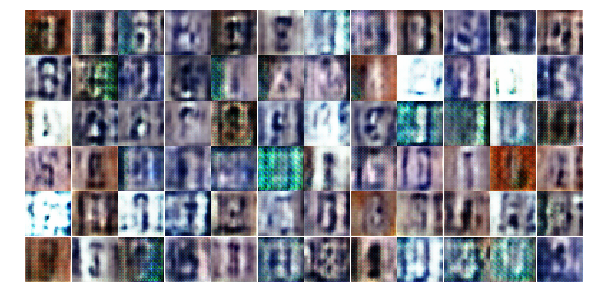

[20/25][310/573] Loss_D: 0.4611 Loss_G: 2.5268 D(x): 0.9208 D(G(z)): 0.2658 / 0.1555
[20/25][320/573] Loss_D: 0.6253 Loss_G: 3.3256 D(x): 0.6595 D(G(z)): 0.0861 / 0.0591
[20/25][330/573] Loss_D: 0.4728 Loss_G: 2.5272 D(x): 0.7422 D(G(z)): 0.0846 / 0.1468
[20/25][340/573] Loss_D: 0.3853 Loss_G: 3.1735 D(x): 0.8769 D(G(z)): 0.1919 / 0.0916
[20/25][350/573] Loss_D: 1.1016 Loss_G: 2.2955 D(x): 0.5044 D(G(z)): 0.1955 / 0.1549
[20/25][360/573] Loss_D: 0.6209 Loss_G: 2.5095 D(x): 0.6954 D(G(z)): 0.1436 / 0.1315
[20/25][370/573] Loss_D: 0.5327 Loss_G: 2.9546 D(x): 0.8015 D(G(z)): 0.2065 / 0.0956
[20/25][380/573] Loss_D: 0.5292 Loss_G: 2.0733 D(x): 0.7615 D(G(z)): 0.1460 / 0.1687
[20/25][390/573] Loss_D: 0.8381 Loss_G: 1.7124 D(x): 0.7802 D(G(z)): 0.3740 / 0.2458
[20/25][400/573] Loss_D: 0.2704 Loss_G: 2.6910 D(x): 0.9020 D(G(z)): 0.1408 / 0.0958


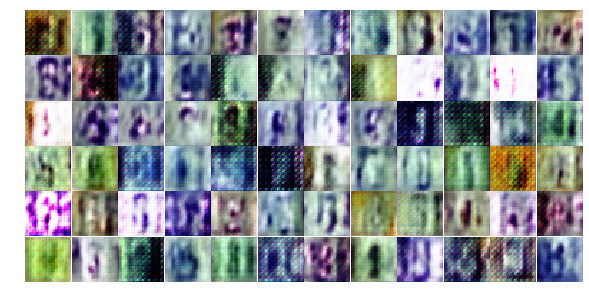

[20/25][410/573] Loss_D: 0.2472 Loss_G: 2.8437 D(x): 0.8882 D(G(z)): 0.1036 / 0.0853
[20/25][420/573] Loss_D: 0.4004 Loss_G: 2.4528 D(x): 0.8287 D(G(z)): 0.1594 / 0.1155
[20/25][430/573] Loss_D: 0.3877 Loss_G: 2.8208 D(x): 0.8561 D(G(z)): 0.1733 / 0.0876
[20/25][440/573] Loss_D: 0.6670 Loss_G: 1.8524 D(x): 0.8230 D(G(z)): 0.3215 / 0.1967
[20/25][450/573] Loss_D: 0.8649 Loss_G: 2.2431 D(x): 0.8469 D(G(z)): 0.4376 / 0.1497
[20/25][460/573] Loss_D: 0.5600 Loss_G: 2.6535 D(x): 0.7550 D(G(z)): 0.1904 / 0.1099
[20/25][470/573] Loss_D: 0.4381 Loss_G: 2.4866 D(x): 0.8407 D(G(z)): 0.1925 / 0.1250
[20/25][480/573] Loss_D: 0.4435 Loss_G: 3.3806 D(x): 0.7225 D(G(z)): 0.0545 / 0.0572
[20/25][490/573] Loss_D: 0.8535 Loss_G: 2.8573 D(x): 0.5391 D(G(z)): 0.0733 / 0.0905
[20/25][500/573] Loss_D: 0.4122 Loss_G: 4.2107 D(x): 0.7448 D(G(z)): 0.0494 / 0.0356


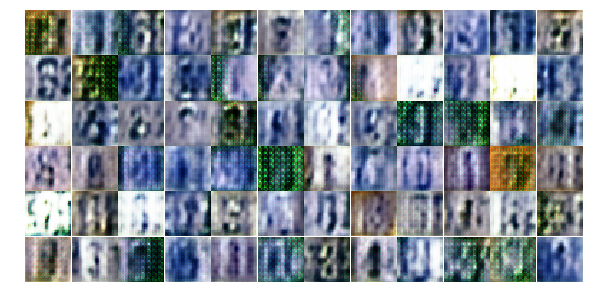

[20/25][510/573] Loss_D: 0.1611 Loss_G: 2.5929 D(x): 0.9105 D(G(z)): 0.0531 / 0.1066
[20/25][520/573] Loss_D: 0.2734 Loss_G: 6.0751 D(x): 0.7867 D(G(z)): 0.0036 / 0.0039
[20/25][530/573] Loss_D: 0.1344 Loss_G: 5.5158 D(x): 0.8973 D(G(z)): 0.0184 / 0.0083
[20/25][540/573] Loss_D: 0.4258 Loss_G: 2.4842 D(x): 0.9662 D(G(z)): 0.2792 / 0.1283
[20/25][550/573] Loss_D: 0.7255 Loss_G: 2.1769 D(x): 0.5944 D(G(z)): 0.0912 / 0.1626
[20/25][560/573] Loss_D: 1.2958 Loss_G: 2.4575 D(x): 0.3645 D(G(z)): 0.0256 / 0.1278
[20/25][570/573] Loss_D: 0.5485 Loss_G: 1.7543 D(x): 0.7976 D(G(z)): 0.2170 / 0.2310
[21/25][0/573] Loss_D: 0.5186 Loss_G: 2.0668 D(x): 0.9329 D(G(z)): 0.3113 / 0.1857


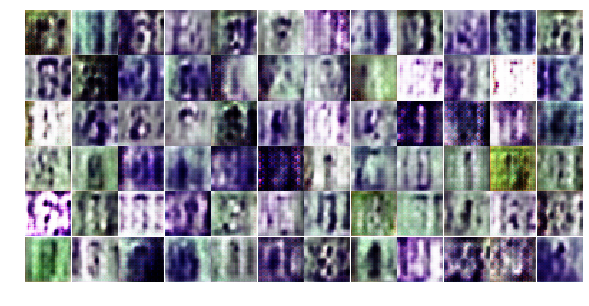

[21/25][10/573] Loss_D: 0.7926 Loss_G: 2.9297 D(x): 0.6008 D(G(z)): 0.0995 / 0.0955
[21/25][20/573] Loss_D: 0.4392 Loss_G: 2.0965 D(x): 0.9355 D(G(z)): 0.2698 / 0.1990
[21/25][30/573] Loss_D: 0.1482 Loss_G: 3.9605 D(x): 0.9384 D(G(z)): 0.0718 / 0.0510
[21/25][40/573] Loss_D: 1.1198 Loss_G: 3.0871 D(x): 0.4645 D(G(z)): 0.1127 / 0.0896
[21/25][50/573] Loss_D: 0.2101 Loss_G: 2.4703 D(x): 0.9706 D(G(z)): 0.1494 / 0.1363
[21/25][60/573] Loss_D: 0.0937 Loss_G: 4.1944 D(x): 0.9660 D(G(z)): 0.0529 / 0.0318
[21/25][70/573] Loss_D: 0.4846 Loss_G: 1.9264 D(x): 0.9398 D(G(z)): 0.3164 / 0.1917
[21/25][80/573] Loss_D: 0.8334 Loss_G: 1.4274 D(x): 0.7979 D(G(z)): 0.3908 / 0.3049
[21/25][90/573] Loss_D: 1.1775 Loss_G: 3.1452 D(x): 0.4257 D(G(z)): 0.1181 / 0.0971
[21/25][100/573] Loss_D: 0.1243 Loss_G: 3.9592 D(x): 0.9400 D(G(z)): 0.0539 / 0.0673


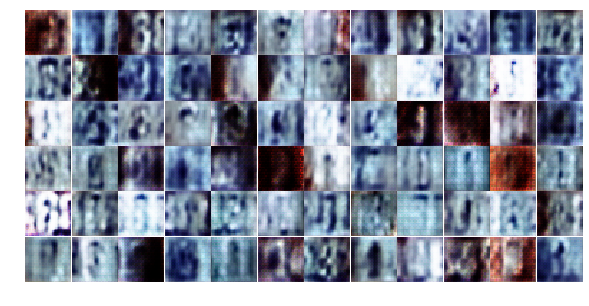

[21/25][110/573] Loss_D: 0.2128 Loss_G: 3.4864 D(x): 0.8746 D(G(z)): 0.0593 / 0.0578
[21/25][120/573] Loss_D: 0.2991 Loss_G: 2.9876 D(x): 0.8909 D(G(z)): 0.1507 / 0.0750
[21/25][130/573] Loss_D: 0.5281 Loss_G: 2.5523 D(x): 0.7542 D(G(z)): 0.1495 / 0.1260
[21/25][140/573] Loss_D: 0.1727 Loss_G: 3.3208 D(x): 0.9867 D(G(z)): 0.1286 / 0.0758
[21/25][150/573] Loss_D: 0.4160 Loss_G: 1.8269 D(x): 0.9492 D(G(z)): 0.2573 / 0.2496
[21/25][160/573] Loss_D: 0.7181 Loss_G: 2.4622 D(x): 0.8527 D(G(z)): 0.3470 / 0.1510
[21/25][170/573] Loss_D: 0.3753 Loss_G: 4.6880 D(x): 0.9037 D(G(z)): 0.1825 / 0.0316
[21/25][180/573] Loss_D: 0.7019 Loss_G: 4.8896 D(x): 0.5874 D(G(z)): 0.0137 / 0.0178
[21/25][190/573] Loss_D: 0.4893 Loss_G: 1.9374 D(x): 0.8644 D(G(z)): 0.2401 / 0.2076
[21/25][200/573] Loss_D: 0.6141 Loss_G: 3.3229 D(x): 0.7123 D(G(z)): 0.1546 / 0.0647


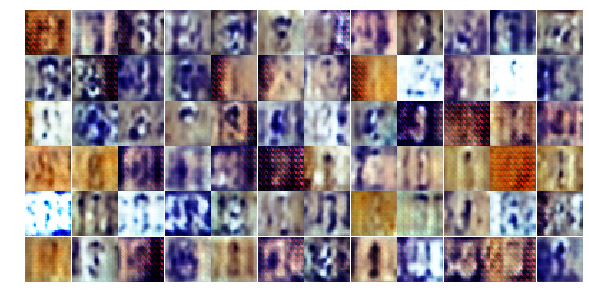

[21/25][210/573] Loss_D: 0.1393 Loss_G: 6.0446 D(x): 0.8934 D(G(z)): 0.0150 / 0.0061
[21/25][220/573] Loss_D: 0.1631 Loss_G: 3.7789 D(x): 0.9256 D(G(z)): 0.0726 / 0.0432
[21/25][230/573] Loss_D: 0.2849 Loss_G: 2.7724 D(x): 0.8966 D(G(z)): 0.1352 / 0.1178
[21/25][240/573] Loss_D: 0.8640 Loss_G: 1.8044 D(x): 0.5782 D(G(z)): 0.1134 / 0.2330
[21/25][250/573] Loss_D: 0.4045 Loss_G: 4.3180 D(x): 0.8886 D(G(z)): 0.2015 / 0.0270
[21/25][260/573] Loss_D: 0.4478 Loss_G: 2.7967 D(x): 0.7139 D(G(z)): 0.0426 / 0.1174
[21/25][270/573] Loss_D: 0.4260 Loss_G: 2.8437 D(x): 0.7899 D(G(z)): 0.1072 / 0.1089
[21/25][280/573] Loss_D: 0.5186 Loss_G: 2.2866 D(x): 0.7483 D(G(z)): 0.1344 / 0.1547
[21/25][290/573] Loss_D: 0.4800 Loss_G: 3.2331 D(x): 0.7065 D(G(z)): 0.0484 / 0.0582
[21/25][300/573] Loss_D: 0.6542 Loss_G: 1.9046 D(x): 0.7315 D(G(z)): 0.2161 / 0.2218


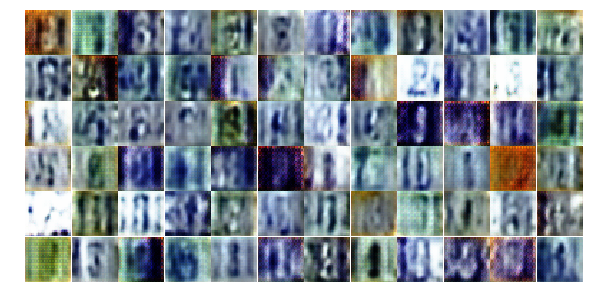

[21/25][310/573] Loss_D: 0.7710 Loss_G: 3.0326 D(x): 0.7688 D(G(z)): 0.3104 / 0.0975
[21/25][320/573] Loss_D: 1.6889 Loss_G: 2.6065 D(x): 0.3235 D(G(z)): 0.0885 / 0.1483
[21/25][330/573] Loss_D: 0.7717 Loss_G: 2.2469 D(x): 0.9744 D(G(z)): 0.4180 / 0.2330
[21/25][340/573] Loss_D: 0.1829 Loss_G: 3.1909 D(x): 0.9408 D(G(z)): 0.0920 / 0.0815
[21/25][350/573] Loss_D: 0.3088 Loss_G: 2.5807 D(x): 0.8903 D(G(z)): 0.1451 / 0.1203
[21/25][360/573] Loss_D: 0.5953 Loss_G: 1.9034 D(x): 0.8013 D(G(z)): 0.2550 / 0.2069
[21/25][370/573] Loss_D: 0.5700 Loss_G: 1.9696 D(x): 0.8690 D(G(z)): 0.2934 / 0.2092
[21/25][380/573] Loss_D: 0.2468 Loss_G: 3.8770 D(x): 0.8328 D(G(z)): 0.0382 / 0.0396
[21/25][390/573] Loss_D: 0.2905 Loss_G: 2.7782 D(x): 0.8349 D(G(z)): 0.0871 / 0.0984
[21/25][400/573] Loss_D: 0.9186 Loss_G: 1.2422 D(x): 0.8215 D(G(z)): 0.4313 / 0.3684


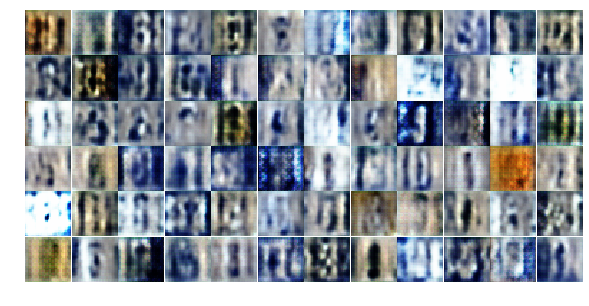

[21/25][410/573] Loss_D: 2.1700 Loss_G: 1.1259 D(x): 0.3804 D(G(z)): 0.5332 / 0.3968
[21/25][420/573] Loss_D: 0.8506 Loss_G: 1.3262 D(x): 0.8473 D(G(z)): 0.3931 / 0.3528
[21/25][430/573] Loss_D: 0.2140 Loss_G: 3.0542 D(x): 0.9249 D(G(z)): 0.1030 / 0.1038
[21/25][440/573] Loss_D: 0.4183 Loss_G: 2.3039 D(x): 0.8347 D(G(z)): 0.1708 / 0.1511
[21/25][450/573] Loss_D: 0.4984 Loss_G: 2.2024 D(x): 0.7616 D(G(z)): 0.1398 / 0.1563
[21/25][460/573] Loss_D: 0.2902 Loss_G: 2.1704 D(x): 0.8661 D(G(z)): 0.1165 / 0.1570
[21/25][470/573] Loss_D: 0.5833 Loss_G: 2.0609 D(x): 0.7782 D(G(z)): 0.2238 / 0.1750
[21/25][480/573] Loss_D: 1.0758 Loss_G: 2.2859 D(x): 0.4939 D(G(z)): 0.1396 / 0.1526
[21/25][490/573] Loss_D: 0.6001 Loss_G: 1.4732 D(x): 0.8638 D(G(z)): 0.3281 / 0.2793
[21/25][500/573] Loss_D: 0.9182 Loss_G: 1.9882 D(x): 0.5591 D(G(z)): 0.1261 / 0.1828


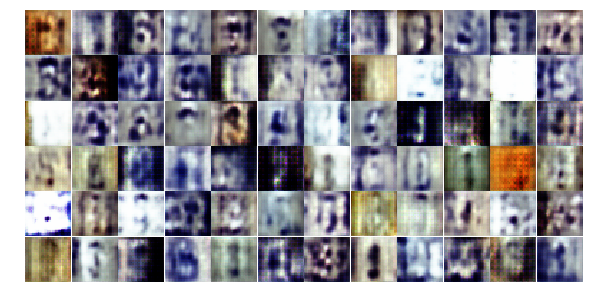

[21/25][510/573] Loss_D: 0.5165 Loss_G: 2.0994 D(x): 0.8254 D(G(z)): 0.2280 / 0.1629
[21/25][520/573] Loss_D: 0.6405 Loss_G: 2.2025 D(x): 0.6958 D(G(z)): 0.1726 / 0.1423
[21/25][530/573] Loss_D: 0.2968 Loss_G: 3.2497 D(x): 0.8334 D(G(z)): 0.0783 / 0.0608
[21/25][540/573] Loss_D: 0.7605 Loss_G: 2.7822 D(x): 0.5627 D(G(z)): 0.0764 / 0.1116
[21/25][550/573] Loss_D: 0.4401 Loss_G: 1.9920 D(x): 0.9841 D(G(z)): 0.2990 / 0.2003
[21/25][560/573] Loss_D: 0.4770 Loss_G: 2.8830 D(x): 0.9102 D(G(z)): 0.2675 / 0.1046
[21/25][570/573] Loss_D: 0.5639 Loss_G: 3.0551 D(x): 0.8409 D(G(z)): 0.2294 / 0.0802
[22/25][0/573] Loss_D: 0.8530 Loss_G: 4.0712 D(x): 0.5361 D(G(z)): 0.0417 / 0.0532


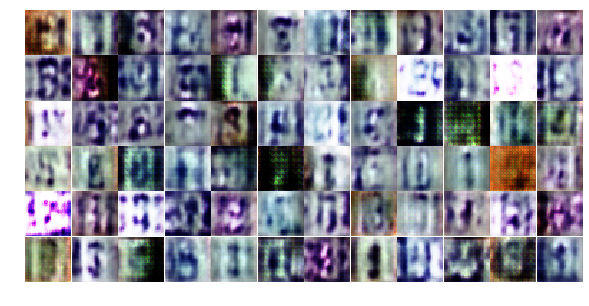

[22/25][10/573] Loss_D: 1.1735 Loss_G: 2.6302 D(x): 0.5245 D(G(z)): 0.1925 / 0.1419
[22/25][20/573] Loss_D: 0.9488 Loss_G: 1.9699 D(x): 0.6139 D(G(z)): 0.2500 / 0.2354
[22/25][30/573] Loss_D: 1.3612 Loss_G: 1.0037 D(x): 0.7713 D(G(z)): 0.5840 / 0.4230
[22/25][40/573] Loss_D: 0.5706 Loss_G: 2.2456 D(x): 0.7600 D(G(z)): 0.1974 / 0.1489
[22/25][50/573] Loss_D: 0.8761 Loss_G: 1.9228 D(x): 0.5891 D(G(z)): 0.1313 / 0.1927
[22/25][60/573] Loss_D: 0.4154 Loss_G: 2.0038 D(x): 0.8914 D(G(z)): 0.2262 / 0.1905
[22/25][70/573] Loss_D: 0.3769 Loss_G: 2.3209 D(x): 0.8721 D(G(z)): 0.1794 / 0.1345
[22/25][80/573] Loss_D: 0.6114 Loss_G: 1.4723 D(x): 0.8753 D(G(z)): 0.3372 / 0.2774
[22/25][90/573] Loss_D: 1.6119 Loss_G: 1.4315 D(x): 0.3832 D(G(z)): 0.2782 / 0.3003
[22/25][100/573] Loss_D: 1.3395 Loss_G: 1.3268 D(x): 0.7112 D(G(z)): 0.5350 / 0.3406


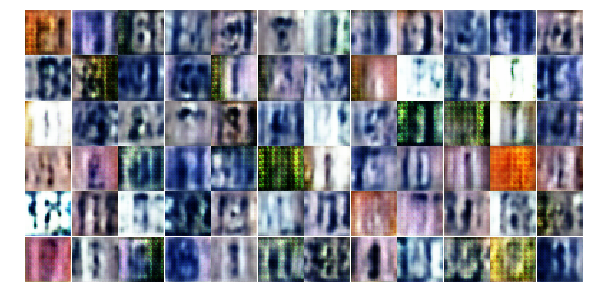

[22/25][110/573] Loss_D: 0.4690 Loss_G: 2.3889 D(x): 0.8096 D(G(z)): 0.1769 / 0.1431
[22/25][120/573] Loss_D: 0.2617 Loss_G: 2.6226 D(x): 0.9410 D(G(z)): 0.1635 / 0.1168
[22/25][130/573] Loss_D: 0.6148 Loss_G: 2.6063 D(x): 0.6899 D(G(z)): 0.1541 / 0.1026
[22/25][140/573] Loss_D: 0.5383 Loss_G: 2.4074 D(x): 0.7842 D(G(z)): 0.2105 / 0.1322
[22/25][150/573] Loss_D: 0.3300 Loss_G: 2.3174 D(x): 0.8070 D(G(z)): 0.0851 / 0.1408
[22/25][160/573] Loss_D: 1.1328 Loss_G: 2.2813 D(x): 0.4768 D(G(z)): 0.1609 / 0.1451
[22/25][170/573] Loss_D: 0.3207 Loss_G: 2.7739 D(x): 0.9320 D(G(z)): 0.1907 / 0.1101
[22/25][180/573] Loss_D: 0.2803 Loss_G: 2.9884 D(x): 0.9415 D(G(z)): 0.1734 / 0.0790
[22/25][190/573] Loss_D: 0.5086 Loss_G: 4.6808 D(x): 0.7448 D(G(z)): 0.1354 / 0.0190
[22/25][200/573] Loss_D: 0.4728 Loss_G: 2.5002 D(x): 0.7963 D(G(z)): 0.1745 / 0.1436


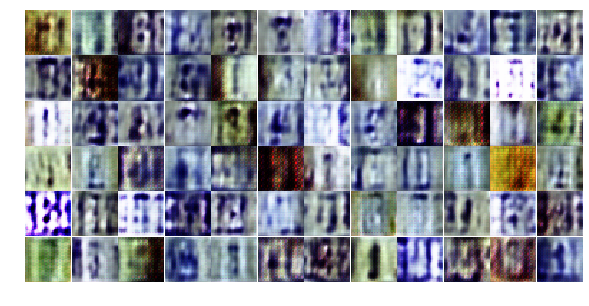

[22/25][210/573] Loss_D: 0.3107 Loss_G: 2.9692 D(x): 0.9080 D(G(z)): 0.1596 / 0.0971
[22/25][220/573] Loss_D: 0.1117 Loss_G: 3.4674 D(x): 0.9736 D(G(z)): 0.0740 / 0.0548
[22/25][230/573] Loss_D: 0.1663 Loss_G: 3.6799 D(x): 0.9118 D(G(z)): 0.0611 / 0.0462
[22/25][240/573] Loss_D: 0.1505 Loss_G: 4.2507 D(x): 0.9119 D(G(z)): 0.0427 / 0.0266
[22/25][250/573] Loss_D: 0.1723 Loss_G: 3.4612 D(x): 0.9486 D(G(z)): 0.0929 / 0.0652
[22/25][260/573] Loss_D: 0.4632 Loss_G: 3.2805 D(x): 0.7494 D(G(z)): 0.0801 / 0.0738
[22/25][270/573] Loss_D: 1.6038 Loss_G: 1.1100 D(x): 0.4388 D(G(z)): 0.3323 / 0.4348
[22/25][280/573] Loss_D: 0.4475 Loss_G: 3.4116 D(x): 0.8777 D(G(z)): 0.2235 / 0.0651
[22/25][290/573] Loss_D: 0.6067 Loss_G: 3.0956 D(x): 0.6558 D(G(z)): 0.1122 / 0.0780
[22/25][300/573] Loss_D: 0.4096 Loss_G: 2.0477 D(x): 0.8812 D(G(z)): 0.2103 / 0.1971


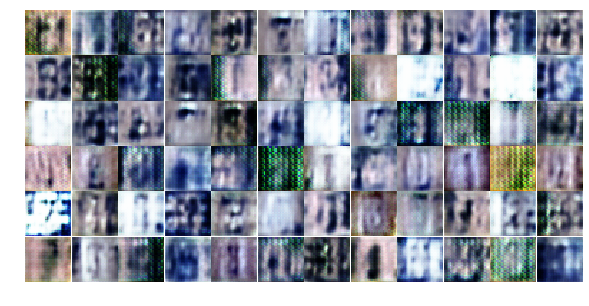

[22/25][310/573] Loss_D: 0.7573 Loss_G: 2.4989 D(x): 0.9212 D(G(z)): 0.4114 / 0.1345
[22/25][320/573] Loss_D: 1.0121 Loss_G: 4.4559 D(x): 0.4934 D(G(z)): 0.0217 / 0.0190
[22/25][330/573] Loss_D: 0.1509 Loss_G: 3.3312 D(x): 0.9494 D(G(z)): 0.0867 / 0.0662
[22/25][340/573] Loss_D: 0.5071 Loss_G: 3.5076 D(x): 0.6964 D(G(z)): 0.0619 / 0.0584
[22/25][350/573] Loss_D: 0.2205 Loss_G: 2.9591 D(x): 0.9917 D(G(z)): 0.1736 / 0.0931
[22/25][360/573] Loss_D: 0.7668 Loss_G: 1.5000 D(x): 0.6732 D(G(z)): 0.1897 / 0.3090
[22/25][370/573] Loss_D: 0.2959 Loss_G: 2.9861 D(x): 0.9160 D(G(z)): 0.1683 / 0.0922
[22/25][380/573] Loss_D: 0.2590 Loss_G: 3.7319 D(x): 0.9056 D(G(z)): 0.1295 / 0.0448
[22/25][390/573] Loss_D: 0.3049 Loss_G: 3.4616 D(x): 0.8616 D(G(z)): 0.1107 / 0.0576
[22/25][400/573] Loss_D: 0.1491 Loss_G: 3.5404 D(x): 0.9607 D(G(z)): 0.0792 / 0.0599


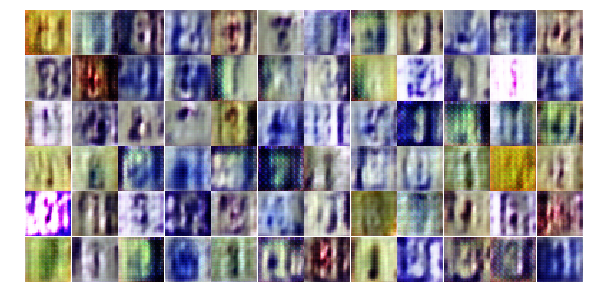

[22/25][410/573] Loss_D: 0.1389 Loss_G: 4.1339 D(x): 0.9164 D(G(z)): 0.0437 / 0.0329
[22/25][420/573] Loss_D: 0.1615 Loss_G: 3.6844 D(x): 0.9588 D(G(z)): 0.0985 / 0.0438
[22/25][430/573] Loss_D: 0.2820 Loss_G: 2.9628 D(x): 0.9385 D(G(z)): 0.1739 / 0.0717
[22/25][440/573] Loss_D: 0.9742 Loss_G: 1.4393 D(x): 0.8456 D(G(z)): 0.4545 / 0.3190
[22/25][450/573] Loss_D: 0.3699 Loss_G: 3.9167 D(x): 0.8025 D(G(z)): 0.0792 / 0.0330
[22/25][460/573] Loss_D: 0.9163 Loss_G: 2.8769 D(x): 0.5353 D(G(z)): 0.0640 / 0.0988
[22/25][470/573] Loss_D: 0.3588 Loss_G: 2.0589 D(x): 0.8878 D(G(z)): 0.1798 / 0.2000
[22/25][480/573] Loss_D: 0.6422 Loss_G: 3.0034 D(x): 0.6681 D(G(z)): 0.1141 / 0.0844
[22/25][490/573] Loss_D: 0.2530 Loss_G: 3.0799 D(x): 0.8866 D(G(z)): 0.1054 / 0.0795
[22/25][500/573] Loss_D: 0.2871 Loss_G: 3.5302 D(x): 0.8758 D(G(z)): 0.1028 / 0.0578


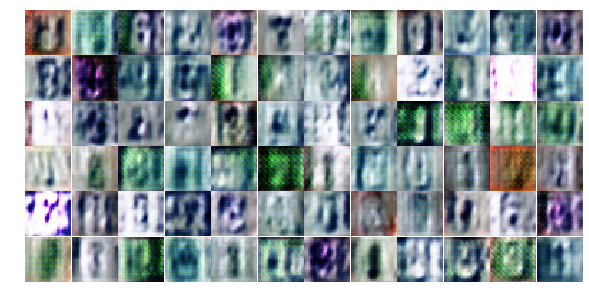

[22/25][510/573] Loss_D: 0.3647 Loss_G: 2.2273 D(x): 0.9026 D(G(z)): 0.2038 / 0.1528
[22/25][520/573] Loss_D: 0.2533 Loss_G: 4.0142 D(x): 0.8418 D(G(z)): 0.0465 / 0.0368
[22/25][530/573] Loss_D: 0.6854 Loss_G: 2.4825 D(x): 0.6654 D(G(z)): 0.1048 / 0.1300
[22/25][540/573] Loss_D: 0.7475 Loss_G: 2.2558 D(x): 0.9850 D(G(z)): 0.4021 / 0.2082
[22/25][550/573] Loss_D: 0.2525 Loss_G: 3.8765 D(x): 0.8806 D(G(z)): 0.0874 / 0.0597
[22/25][560/573] Loss_D: 0.5719 Loss_G: 3.0702 D(x): 0.7978 D(G(z)): 0.2018 / 0.1087
[22/25][570/573] Loss_D: 0.2511 Loss_G: 4.6148 D(x): 0.8270 D(G(z)): 0.0246 / 0.0279
[23/25][0/573] Loss_D: 0.2581 Loss_G: 2.3154 D(x): 0.9711 D(G(z)): 0.1805 / 0.1748


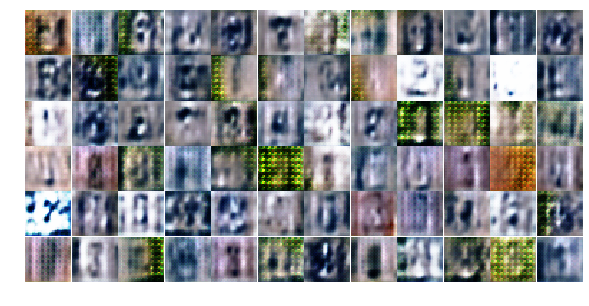

[23/25][10/573] Loss_D: 0.5190 Loss_G: 2.7892 D(x): 0.8422 D(G(z)): 0.2065 / 0.1277
[23/25][20/573] Loss_D: 0.6822 Loss_G: 3.0755 D(x): 0.6460 D(G(z)): 0.0490 / 0.0921
[23/25][30/573] Loss_D: 0.3198 Loss_G: 3.7009 D(x): 0.8036 D(G(z)): 0.0452 / 0.0435
[23/25][40/573] Loss_D: 0.4872 Loss_G: 2.9000 D(x): 0.7632 D(G(z)): 0.1339 / 0.0909
[23/25][50/573] Loss_D: 0.3033 Loss_G: 2.4954 D(x): 0.8923 D(G(z)): 0.1414 / 0.1202
[23/25][60/573] Loss_D: 0.4817 Loss_G: 2.1410 D(x): 0.9687 D(G(z)): 0.3289 / 0.1666
[23/25][70/573] Loss_D: 0.3535 Loss_G: 3.2705 D(x): 0.8701 D(G(z)): 0.1611 / 0.0652
[23/25][80/573] Loss_D: 0.1058 Loss_G: 4.5471 D(x): 0.9683 D(G(z)): 0.0645 / 0.0225
[23/25][90/573] Loss_D: 0.1057 Loss_G: 4.5189 D(x): 0.9452 D(G(z)): 0.0332 / 0.0230
[23/25][100/573] Loss_D: 0.0668 Loss_G: 4.4123 D(x): 0.9639 D(G(z)): 0.0270 / 0.0219


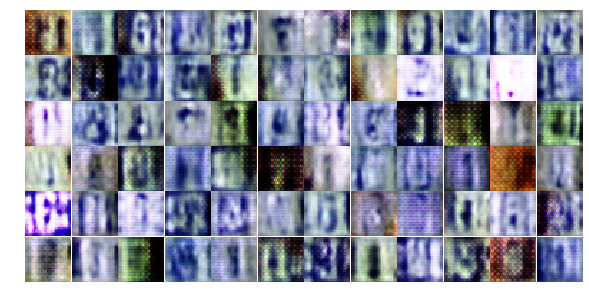

[23/25][110/573] Loss_D: 0.6272 Loss_G: 3.1812 D(x): 0.6673 D(G(z)): 0.1066 / 0.0820
[23/25][120/573] Loss_D: 0.6697 Loss_G: 3.1206 D(x): 0.8956 D(G(z)): 0.3590 / 0.0832
[23/25][130/573] Loss_D: 1.2238 Loss_G: 3.5717 D(x): 0.4117 D(G(z)): 0.0417 / 0.0886
[23/25][140/573] Loss_D: 0.6225 Loss_G: 2.0099 D(x): 0.9547 D(G(z)): 0.3448 / 0.2322
[23/25][150/573] Loss_D: 0.4127 Loss_G: 6.3132 D(x): 0.7339 D(G(z)): 0.0077 / 0.0040
[23/25][160/573] Loss_D: 0.4912 Loss_G: 2.4971 D(x): 0.8182 D(G(z)): 0.1882 / 0.1540
[23/25][170/573] Loss_D: 0.9494 Loss_G: 1.6188 D(x): 0.8034 D(G(z)): 0.3906 / 0.2954
[23/25][180/573] Loss_D: 0.0887 Loss_G: 4.1410 D(x): 0.9582 D(G(z)): 0.0388 / 0.0389
[23/25][190/573] Loss_D: 0.1164 Loss_G: 5.6954 D(x): 0.9343 D(G(z)): 0.0118 / 0.0080
[23/25][200/573] Loss_D: 0.0629 Loss_G: 3.8795 D(x): 0.9947 D(G(z)): 0.0526 / 0.0427


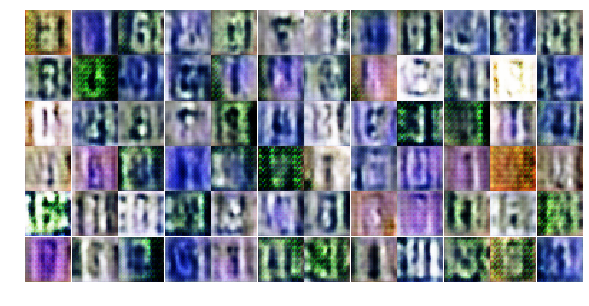

[23/25][210/573] Loss_D: 0.2110 Loss_G: 3.4788 D(x): 0.9121 D(G(z)): 0.0866 / 0.0748
[23/25][220/573] Loss_D: 0.7570 Loss_G: 1.6600 D(x): 0.9010 D(G(z)): 0.3877 / 0.2842
[23/25][230/573] Loss_D: 0.4261 Loss_G: 3.8706 D(x): 0.8698 D(G(z)): 0.2021 / 0.0416
[23/25][240/573] Loss_D: 0.5860 Loss_G: 2.8275 D(x): 0.6870 D(G(z)): 0.0885 / 0.1396
[23/25][250/573] Loss_D: 0.2142 Loss_G: 3.2689 D(x): 0.9178 D(G(z)): 0.0838 / 0.1084
[23/25][260/573] Loss_D: 0.1812 Loss_G: 2.8100 D(x): 0.9556 D(G(z)): 0.1034 / 0.1345
[23/25][270/573] Loss_D: 0.5910 Loss_G: 1.6111 D(x): 0.9491 D(G(z)): 0.3378 / 0.3089
[23/25][280/573] Loss_D: 0.6222 Loss_G: 2.0091 D(x): 0.9340 D(G(z)): 0.3599 / 0.2076
[23/25][290/573] Loss_D: 0.2434 Loss_G: 4.4538 D(x): 0.8768 D(G(z)): 0.0766 / 0.0290
[23/25][300/573] Loss_D: 0.1368 Loss_G: 4.2498 D(x): 0.9605 D(G(z)): 0.0836 / 0.0288


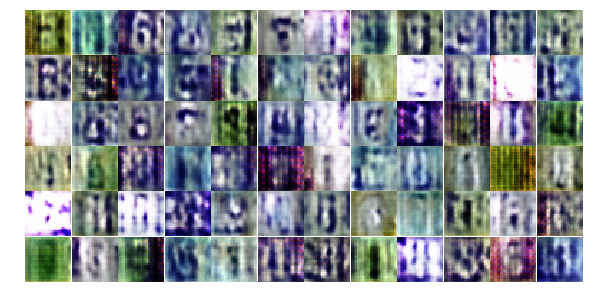

[23/25][310/573] Loss_D: 0.4637 Loss_G: 3.6867 D(x): 0.7779 D(G(z)): 0.1022 / 0.0498
[23/25][320/573] Loss_D: 0.9795 Loss_G: 1.6929 D(x): 0.6047 D(G(z)): 0.2618 / 0.2696
[23/25][330/573] Loss_D: 0.7696 Loss_G: 4.1614 D(x): 0.5909 D(G(z)): 0.0371 / 0.0455
[23/25][340/573] Loss_D: 0.4318 Loss_G: 3.7850 D(x): 0.7328 D(G(z)): 0.0306 / 0.0505
[23/25][350/573] Loss_D: 0.3073 Loss_G: 3.4578 D(x): 0.8033 D(G(z)): 0.0468 / 0.0795
[23/25][360/573] Loss_D: 0.1385 Loss_G: 3.5803 D(x): 0.9124 D(G(z)): 0.0265 / 0.0589
[23/25][370/573] Loss_D: 0.1762 Loss_G: 3.1328 D(x): 0.9393 D(G(z)): 0.0974 / 0.0729
[23/25][380/573] Loss_D: 0.3955 Loss_G: 2.5913 D(x): 0.8448 D(G(z)): 0.1703 / 0.1186
[23/25][390/573] Loss_D: 0.3039 Loss_G: 3.6227 D(x): 0.8418 D(G(z)): 0.0964 / 0.0474
[23/25][400/573] Loss_D: 0.1054 Loss_G: 5.1793 D(x): 0.9350 D(G(z)): 0.0321 / 0.0096


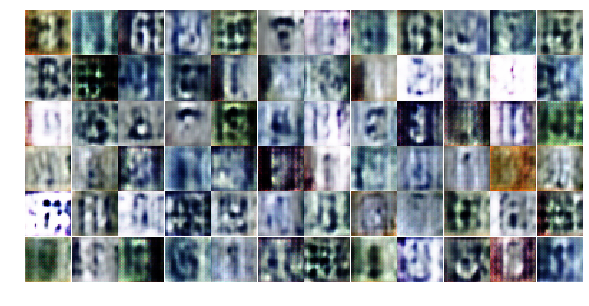

[23/25][410/573] Loss_D: 0.3132 Loss_G: 3.5793 D(x): 0.8039 D(G(z)): 0.0583 / 0.0517
[23/25][420/573] Loss_D: 0.2650 Loss_G: 2.5091 D(x): 0.8725 D(G(z)): 0.0975 / 0.1580
[23/25][430/573] Loss_D: 0.4048 Loss_G: 3.0894 D(x): 0.7634 D(G(z)): 0.0746 / 0.0768
[23/25][440/573] Loss_D: 0.3552 Loss_G: 3.0953 D(x): 0.8173 D(G(z)): 0.1039 / 0.0731
[23/25][450/573] Loss_D: 0.4517 Loss_G: 3.1911 D(x): 0.7504 D(G(z)): 0.0820 / 0.0698
[23/25][460/573] Loss_D: 0.4289 Loss_G: 3.4882 D(x): 0.7420 D(G(z)): 0.0703 / 0.0569
[23/25][470/573] Loss_D: 1.0606 Loss_G: 2.4399 D(x): 0.5148 D(G(z)): 0.1058 / 0.1655
[23/25][480/573] Loss_D: 0.5530 Loss_G: 2.2195 D(x): 0.9459 D(G(z)): 0.3066 / 0.1787
[23/25][490/573] Loss_D: 0.1962 Loss_G: 3.8489 D(x): 0.9009 D(G(z)): 0.0680 / 0.0453
[23/25][500/573] Loss_D: 0.0712 Loss_G: 4.3830 D(x): 0.9833 D(G(z)): 0.0506 / 0.0369


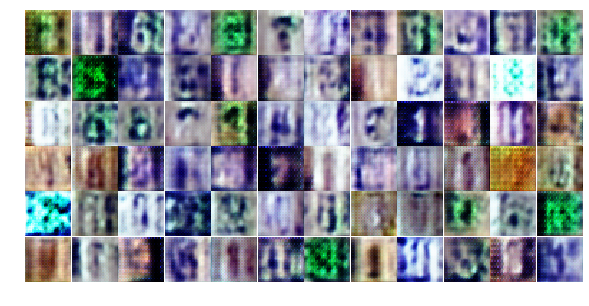

[23/25][510/573] Loss_D: 0.1790 Loss_G: 3.6299 D(x): 0.9128 D(G(z)): 0.0612 / 0.0412
[23/25][520/573] Loss_D: 0.4205 Loss_G: 2.2552 D(x): 0.8788 D(G(z)): 0.2154 / 0.1495
[23/25][530/573] Loss_D: 0.1825 Loss_G: 4.0536 D(x): 0.8966 D(G(z)): 0.0561 / 0.0310
[23/25][540/573] Loss_D: 0.4584 Loss_G: 2.7927 D(x): 0.7262 D(G(z)): 0.0783 / 0.0901
[23/25][550/573] Loss_D: 0.7200 Loss_G: 1.8175 D(x): 0.7579 D(G(z)): 0.2802 / 0.2325
[23/25][560/573] Loss_D: 1.0125 Loss_G: 1.4945 D(x): 0.5376 D(G(z)): 0.1825 / 0.3168
[23/25][570/573] Loss_D: 0.5428 Loss_G: 1.5942 D(x): 0.9725 D(G(z)): 0.3354 / 0.2989
[24/25][0/573] Loss_D: 0.5505 Loss_G: 3.1253 D(x): 0.8633 D(G(z)): 0.2693 / 0.0881


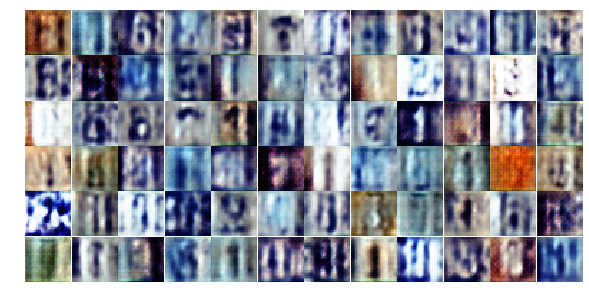

[24/25][10/573] Loss_D: 1.0628 Loss_G: 1.8997 D(x): 0.9498 D(G(z)): 0.5391 / 0.2250
[24/25][20/573] Loss_D: 0.5097 Loss_G: 3.8435 D(x): 0.7340 D(G(z)): 0.1179 / 0.0390
[24/25][30/573] Loss_D: 0.2113 Loss_G: 3.8822 D(x): 0.8745 D(G(z)): 0.0556 / 0.0562
[24/25][40/573] Loss_D: 0.1234 Loss_G: 3.6129 D(x): 0.9672 D(G(z)): 0.0705 / 0.0492
[24/25][50/573] Loss_D: 0.1614 Loss_G: 4.4106 D(x): 0.8838 D(G(z)): 0.0227 / 0.0231
[24/25][60/573] Loss_D: 0.6627 Loss_G: 1.0864 D(x): 0.8611 D(G(z)): 0.3454 / 0.4086
[24/25][70/573] Loss_D: 0.7074 Loss_G: 2.8179 D(x): 0.6723 D(G(z)): 0.1490 / 0.1075
[24/25][80/573] Loss_D: 0.5978 Loss_G: 2.1014 D(x): 0.9207 D(G(z)): 0.3317 / 0.1875
[24/25][90/573] Loss_D: 0.7688 Loss_G: 2.5569 D(x): 0.5731 D(G(z)): 0.0658 / 0.1583
[24/25][100/573] Loss_D: 0.3481 Loss_G: 2.3736 D(x): 0.9636 D(G(z)): 0.2193 / 0.1803


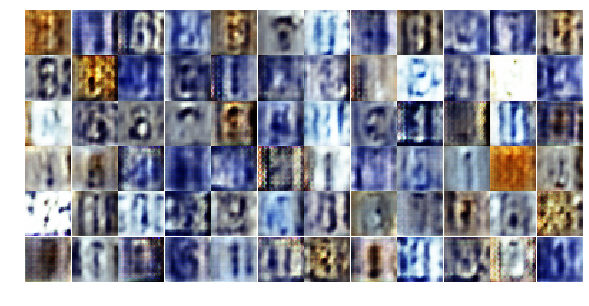

[24/25][110/573] Loss_D: 0.2427 Loss_G: 2.8361 D(x): 0.9397 D(G(z)): 0.1427 / 0.1254
[24/25][120/573] Loss_D: 0.2902 Loss_G: 2.8040 D(x): 0.9547 D(G(z)): 0.1913 / 0.0984
[24/25][130/573] Loss_D: 1.2229 Loss_G: 3.0866 D(x): 0.4285 D(G(z)): 0.0862 / 0.0782
[24/25][140/573] Loss_D: 0.0710 Loss_G: 4.8685 D(x): 0.9573 D(G(z)): 0.0234 / 0.0155
[24/25][150/573] Loss_D: 0.2517 Loss_G: 2.3869 D(x): 0.9960 D(G(z)): 0.2004 / 0.1255
[24/25][160/573] Loss_D: 0.0549 Loss_G: 4.3732 D(x): 0.9822 D(G(z)): 0.0342 / 0.0239
[24/25][170/573] Loss_D: 0.1265 Loss_G: 3.8439 D(x): 0.9707 D(G(z)): 0.0854 / 0.0473
[24/25][180/573] Loss_D: 0.2064 Loss_G: 2.9174 D(x): 0.9559 D(G(z)): 0.1303 / 0.0990
[24/25][190/573] Loss_D: 0.3545 Loss_G: 3.1854 D(x): 0.8509 D(G(z)): 0.1437 / 0.0667
[24/25][200/573] Loss_D: 0.6622 Loss_G: 3.6937 D(x): 0.6776 D(G(z)): 0.1272 / 0.0445


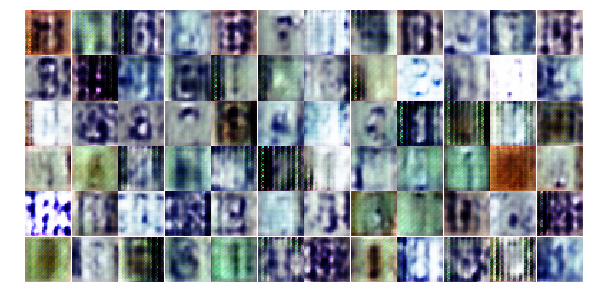

[24/25][210/573] Loss_D: 0.1522 Loss_G: 4.7924 D(x): 0.9184 D(G(z)): 0.0528 / 0.0199
[24/25][220/573] Loss_D: 0.7709 Loss_G: 3.6853 D(x): 0.6027 D(G(z)): 0.0516 / 0.0674
[24/25][230/573] Loss_D: 0.2663 Loss_G: 2.8448 D(x): 0.9270 D(G(z)): 0.1503 / 0.0900
[24/25][240/573] Loss_D: 0.5076 Loss_G: 3.1390 D(x): 0.7409 D(G(z)): 0.1253 / 0.0859
[24/25][250/573] Loss_D: 0.2179 Loss_G: 2.9650 D(x): 0.8869 D(G(z)): 0.0744 / 0.0841
[24/25][260/573] Loss_D: 0.4241 Loss_G: 2.1257 D(x): 0.8424 D(G(z)): 0.1842 / 0.1760
[24/25][270/573] Loss_D: 0.5324 Loss_G: 3.1827 D(x): 0.7304 D(G(z)): 0.1118 / 0.0736
[24/25][280/573] Loss_D: 0.3974 Loss_G: 1.7056 D(x): 0.8140 D(G(z)): 0.1289 / 0.2664
[24/25][290/573] Loss_D: 0.1314 Loss_G: 3.3084 D(x): 0.9785 D(G(z)): 0.0873 / 0.0700
[24/25][300/573] Loss_D: 0.3991 Loss_G: 3.3747 D(x): 0.7726 D(G(z)): 0.0792 / 0.0644


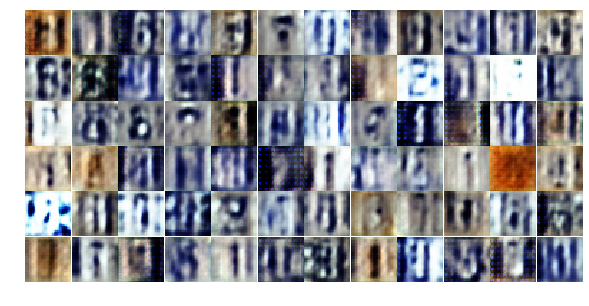

[24/25][310/573] Loss_D: 0.5364 Loss_G: 1.7700 D(x): 0.9215 D(G(z)): 0.3251 / 0.2439
[24/25][320/573] Loss_D: 0.6768 Loss_G: 6.2403 D(x): 0.5898 D(G(z)): 0.0077 / 0.0056
[24/25][330/573] Loss_D: 0.2944 Loss_G: 4.5577 D(x): 0.8205 D(G(z)): 0.0193 / 0.0238
[24/25][340/573] Loss_D: 0.1652 Loss_G: 4.1185 D(x): 0.9081 D(G(z)): 0.0519 / 0.0353
[24/25][350/573] Loss_D: 0.6011 Loss_G: 2.4557 D(x): 0.9415 D(G(z)): 0.3341 / 0.1796
[24/25][360/573] Loss_D: 0.8030 Loss_G: 1.7393 D(x): 0.6652 D(G(z)): 0.1978 / 0.3184
[24/25][370/573] Loss_D: 0.2504 Loss_G: 2.2032 D(x): 0.9270 D(G(z)): 0.1335 / 0.1963
[24/25][380/573] Loss_D: 0.0806 Loss_G: 4.3330 D(x): 0.9574 D(G(z)): 0.0321 / 0.0341
[24/25][390/573] Loss_D: 0.4568 Loss_G: 3.6115 D(x): 0.7864 D(G(z)): 0.1196 / 0.0613
[24/25][400/573] Loss_D: 1.1887 Loss_G: 3.0648 D(x): 0.4597 D(G(z)): 0.0459 / 0.0894


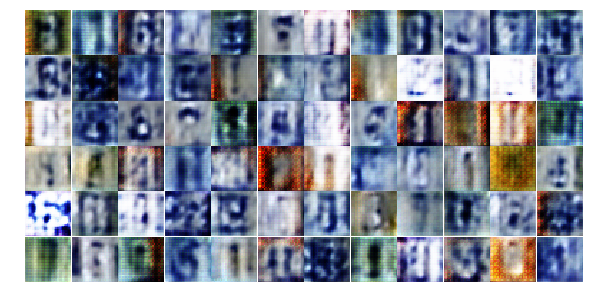

[24/25][410/573] Loss_D: 0.4725 Loss_G: 2.4884 D(x): 0.9294 D(G(z)): 0.2760 / 0.1415
[24/25][420/573] Loss_D: 0.3577 Loss_G: 3.5690 D(x): 0.8110 D(G(z)): 0.0784 / 0.0578
[24/25][430/573] Loss_D: 0.2274 Loss_G: 4.9488 D(x): 0.8457 D(G(z)): 0.0210 / 0.0163
[24/25][440/573] Loss_D: 0.8740 Loss_G: 1.1694 D(x): 0.7081 D(G(z)): 0.3186 / 0.3877
[24/25][450/573] Loss_D: 0.2622 Loss_G: 2.6807 D(x): 0.9391 D(G(z)): 0.1537 / 0.1139
[24/25][460/573] Loss_D: 0.2576 Loss_G: 3.5399 D(x): 0.8912 D(G(z)): 0.1061 / 0.0638
[24/25][470/573] Loss_D: 0.2287 Loss_G: 3.2869 D(x): 0.9519 D(G(z)): 0.1430 / 0.0684
[24/25][480/573] Loss_D: 0.4696 Loss_G: 2.3081 D(x): 0.7423 D(G(z)): 0.1044 / 0.1466
[24/25][490/573] Loss_D: 0.4831 Loss_G: 2.0445 D(x): 0.7786 D(G(z)): 0.1665 / 0.1727
[24/25][500/573] Loss_D: 0.5951 Loss_G: 2.5523 D(x): 0.6814 D(G(z)): 0.1256 / 0.1149


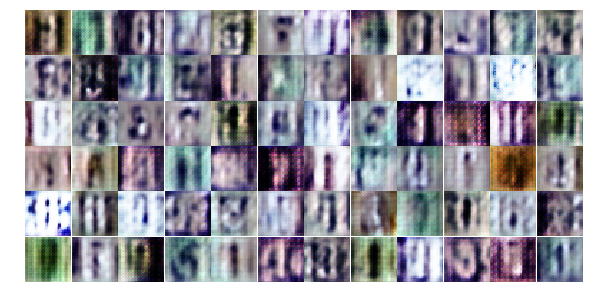

[24/25][510/573] Loss_D: 0.2161 Loss_G: 2.7844 D(x): 0.9414 D(G(z)): 0.1277 / 0.1011
[24/25][520/573] Loss_D: 0.4203 Loss_G: 1.8954 D(x): 0.8907 D(G(z)): 0.2192 / 0.2134
[24/25][530/573] Loss_D: 0.5849 Loss_G: 1.7228 D(x): 0.9572 D(G(z)): 0.3607 / 0.2454
[24/25][540/573] Loss_D: 0.5344 Loss_G: 2.4448 D(x): 0.8458 D(G(z)): 0.2635 / 0.1246
[24/25][550/573] Loss_D: 0.8168 Loss_G: 1.8996 D(x): 0.6373 D(G(z)): 0.1757 / 0.2118
[24/25][560/573] Loss_D: 0.3371 Loss_G: 2.7176 D(x): 0.8850 D(G(z)): 0.1552 / 0.1063
[24/25][570/573] Loss_D: 0.2977 Loss_G: 2.8427 D(x): 0.9295 D(G(z)): 0.1575 / 0.1048


In [17]:
print_every=10
show_every=100
samples, losses = [], []

for epoch in range(niter):
  for i, data in enumerate(trainloader, 0):
    if data[0].size()[0] < batchSize:
      continue
    real_data = data[0].to(device)
    ############################
    # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    ###########################
    # train with real
    d_model.zero_grad()

    output = d_model(real_data)
    label = torch.full((batchSize,), real_label, device=device)

    d_loss_real = criterion(output, label)
    d_loss_real.backward()
    D_x = output.mean().item()

    # train with fake
    noise = torch.randn(batchSize, nz, 1, 1, device=device)
    fake = g_model(noise)
    label.fill_(fake_label)
    output = d_model(fake.detach())
    d_loss_fake = criterion(output, label)
    d_loss_fake.backward()
    D_G_z1 = output.mean().item()
    d_loss = d_loss_real + d_loss_fake
    d_train_optim.step()

    ############################
    # (2) Update G network: maximize log(D(G(z)))
    ###########################
    g_model.zero_grad()
    label.fill_(real_label)  # fake labels are real for generator cost
    output = d_model(fake)
    g_loss = criterion(output, label)
    g_loss.backward()
    D_G_z2 = output.mean().item()
    g_train_optim.step()

    if i % print_every == 0:
      print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f'
            % (epoch, niter, i, len(trainloader),
               d_loss.item(), g_loss.item(), D_x, D_G_z1, D_G_z2))
      losses.append((d_loss.item(), g_loss.item()))
    if i % show_every == 0:
      gen_samples = g_model(sample_noise).detach()
      sample = gen_samples.to(torch.device('cpu')).numpy()
      samples.append(sample)
      _ = view_samples(-1, samples, 6, 12, figsize=(10,5))
      plt.show()

## Sample images after the training

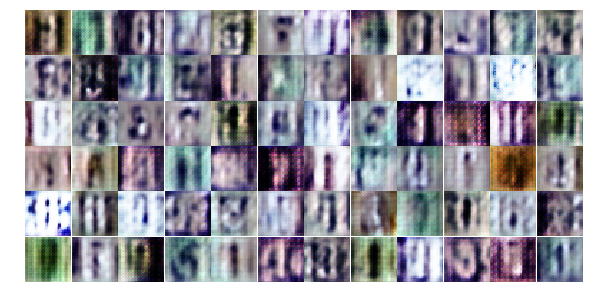

In [18]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

## Training Losses

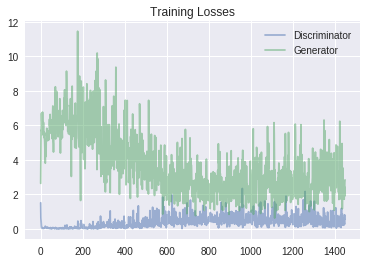

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()